In [9]:
import pathlib

# Define data directory
data_dir = pathlib.Path('data/heatmap')
train_dir = data_dir / 'train'
test_dir = data_dir / 'test'
train_masks_dir = pathlib.Path('internal_smaller_mask/train')
test_masks_dir = pathlib.Path('internal_smaller_mask/test')

In [10]:
import os
import cv2
import numpy as np

# check if the pixels are normalized
img = cv2.imread(os.path.join(test_dir, 'P1MF1_C.png'), cv2.IMREAD_GRAYSCALE)
print(np.max(img), np.min(img))
img_mask = cv2.imread(os.path.join(test_masks_dir, 'P1MF1_C.Png'), cv2.IMREAD_GRAYSCALE)
print(np.max(img_mask), np.min(img_mask))
print(img.shape, img_mask.shape)

225 14
225 0
(4096, 4096) (4096, 4096)


In [11]:
X_train = []
y_train = []
X_test = []
y_test = []

for img_path in train_dir.glob('*.png'):
    img = cv2.imread(str(img_path))
    img = cv2.resize(img, (256, 256))
    X_train.append(img)
    mask_path = os.path.join(train_masks_dir, img_path.stem + '.png')
    img_mask = cv2.imread(mask_path, cv2.IMREAD_GRAYSCALE)
    img_mask = cv2.resize(img_mask, (256, 256))
    y_train.append(img_mask)

for img_path in test_dir.glob('*.png'):
    img = cv2.imread(str(img_path))
    img = cv2.resize(img, (256, 256))
    X_test.append(img)
    mask_path = os.path.join(test_masks_dir, img_path.stem + '.png')
    img_mask = cv2.imread(mask_path, cv2.IMREAD_GRAYSCALE)
    img_mask = cv2.resize(img_mask, (256, 256))
    y_test.append(img_mask)

X_train = np.array(X_train)
y_train = np.array(y_train)
X_test = np.array(X_test)
y_test = np.array(y_test)

# # Expand the dimensions of the images
#X_train = np.expand_dims(X_train, axis = 3)
y_train = np.expand_dims(y_train, axis = 3)
#X_test = np.expand_dims(X_test, axis = 3)
y_test = np.expand_dims(y_test, axis = 3)

print(X_train.shape, y_train.shape)

(50, 256, 256, 3) (50, 256, 256, 1)


In [12]:
from random import random
import tensorflow as tf
# random seed
SEED = 42

def reset_random_seeds():
   os.environ['PYTHONHASHSEED']=str(SEED)
   tf.random.set_seed(SEED)
   tf.keras.utils.set_random_seed(SEED)
   np.random.seed(SEED)
   tf.config.experimental.enable_op_determinism()

reset_random_seeds()

train_dataset = tf.data.Dataset.from_tensor_slices((X_train, y_train))
test_dataset = tf.data.Dataset.from_tensor_slices((X_test, y_test))

In [13]:
def normalize(input_image, input_mask):
    input_image = tf.cast(input_image, tf.float32) / 255.0
    input_mask = tf.round(tf.cast(input_mask, tf.float32) / 255.0)
    return input_image, input_mask

def load_image(input_image, input_mask):
    input_image = tf.image.resize(input_image, (128, 128))
    input_mask = tf.image.resize(input_mask,(128, 128), method = tf.image.ResizeMethod.NEAREST_NEIGHBOR)
    input_image, input_mask = normalize(input_image, input_mask)
    return input_image, input_mask

In [14]:
TRAIN_LENGTH = len(X_train)
BATCH_SIZE = 4
BUFFER_SIZE = 1000
STEPS_PER_EPOCH = TRAIN_LENGTH // BATCH_SIZE

In [15]:
train_ds = train_dataset.map(load_image, num_parallel_calls=tf.data.experimental.AUTOTUNE)
test_ds = test_dataset.map(load_image, num_parallel_calls=tf.data.experimental.AUTOTUNE)

print("the shape of the train dataset is: ", train_ds)
# Show the labels of the first image
for image, mask in train_ds.take(1):
    print(" max value of the image is: ", np.min(image.numpy()))
    # print("the shape of the image is: ", image.numpy().shape)
    # print("the shape of the mask is: ", mask.numpy().shape)
    # print("the label of the first image is: ", mask.numpy())

the shape of the train dataset is:  <_ParallelMapDataset element_spec=(TensorSpec(shape=(128, 128, 3), dtype=tf.float32, name=None), TensorSpec(shape=(128, 128, 1), dtype=tf.float32, name=None))>
 max value of the image is:  0.0


In [16]:
class Augment(tf.keras.layers.Layer):
  def __init__(self, seed=42):
    super().__init__()
    # both use the same seed, so they'll make the same random changes.
    # do augmentation in ratio of 1 to 5 images in the train
    self.augment_inputs = tf.keras.Sequential([
        tf.keras.layers.RandomFlip(mode="horizontal", seed=seed),
        tf.keras.layers.RandomRotation(factor=0.2, seed=seed),
        tf.keras.layers.RandomZoom(height_factor=0.1, width_factor=0.1, seed=seed),
        tf.keras.layers.RandomTranslation(height_factor=0.1, width_factor=0.1, seed=seed),
        tf.keras.layers.RandomContrast(factor=0.1, seed=seed),
    ], name="augment_inputs")

    self.augment_labels = tf.keras.Sequential([
        tf.keras.layers.RandomFlip(mode="horizontal", seed=seed),
        tf.keras.layers.RandomRotation(factor=0.2, seed=seed),
        tf.keras.layers.RandomZoom(height_factor=0.1, width_factor=0.1, seed=seed),
        tf.keras.layers.RandomTranslation(height_factor=0.1, width_factor=0.1, seed=seed),
    ], name="augment_labels")

  def call(self, inputs, labels):
    inputs = self.augment_inputs(inputs)
    labels = self.augment_labels(labels)
    return inputs, labels

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


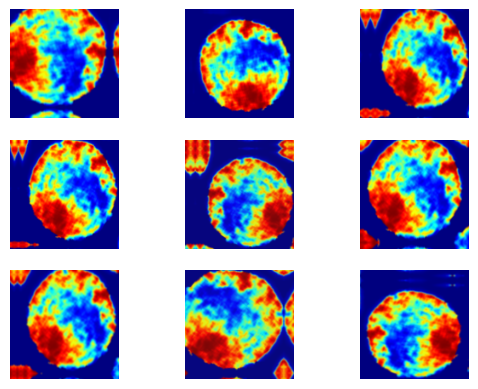

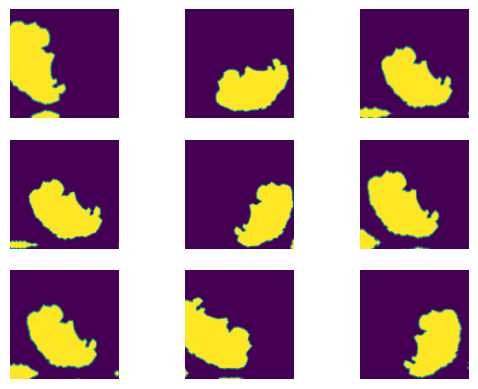

In [17]:
from matplotlib import pyplot as plt
# plot 9 augmentations of the image and the mask for one original image and its mask
for image, mask in train_ds.take(1):
    # random seed array
    seed = np.random.randint(0, 1000, 9)
    for i in range(9):
        plt.subplot(330 + 1 + i)
        augmented_image, augmented_mask = Augment(seed[i])(image, mask)
        # Convert from gbr to rgb
        augmented_image = augmented_image.numpy()
        augmented_image = cv2.cvtColor(augmented_image, cv2.COLOR_BGR2RGB)
        plt.imshow(augmented_image)
        plt.axis("off")
    plt.show()
    for i in range(9):
        plt.subplot(330 + 1 + i)
        augmented_image, augmented_mask = Augment(seed[i])(image, mask)
        plt.imshow(augmented_mask.numpy())
        plt.axis("off")
    plt.show()

In [18]:
train_batches = (
    train_ds
    .cache()
    .shuffle(BUFFER_SIZE)
    .batch(BATCH_SIZE)
    .repeat()
    .map(Augment())
    .prefetch(buffer_size=tf.data.AUTOTUNE))

test_batches, val_batches = test_ds.take(len(X_test) // 2).batch(BATCH_SIZE), test_ds.skip(len(X_test) // 2).batch(BATCH_SIZE)

In [19]:
from matplotlib import pyplot as plt

def display(display_list):
  plt.figure(figsize=(15, 15))

  title = ['Input Image', 'True Mask', 'Predicted Mask']

  for i in range(len(display_list)):
    plt.subplot(1, len(display_list), i+1)
    plt.title(title[i])
    img = tf.keras.preprocessing.image.array_to_img(display_list[i])
    # Convert from gbr to rgb
    img = cv2.cvtColor(np.array(img), cv2.COLOR_BGR2RGB)
    plt.imshow(img)
    # print the unique values of the image
    #print(np.unique(display_list[i]))
    plt.axis('off')
  plt.show()

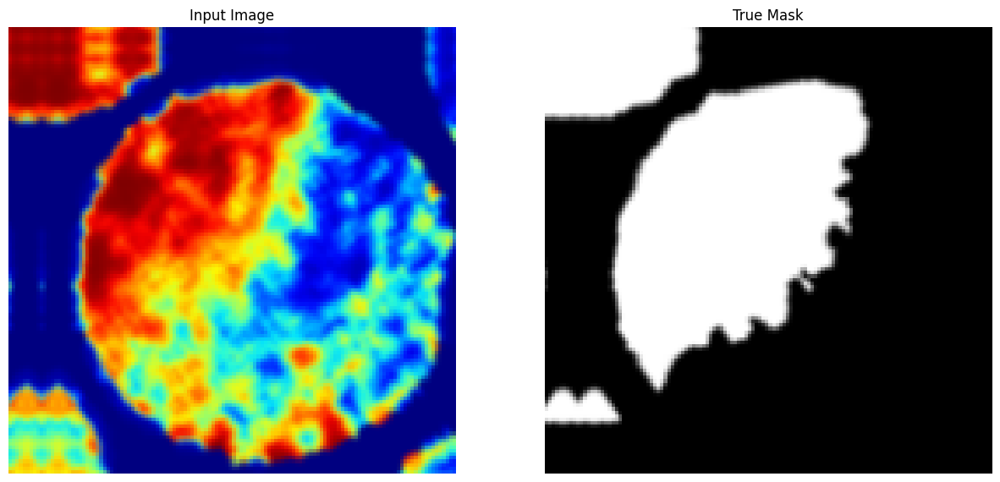

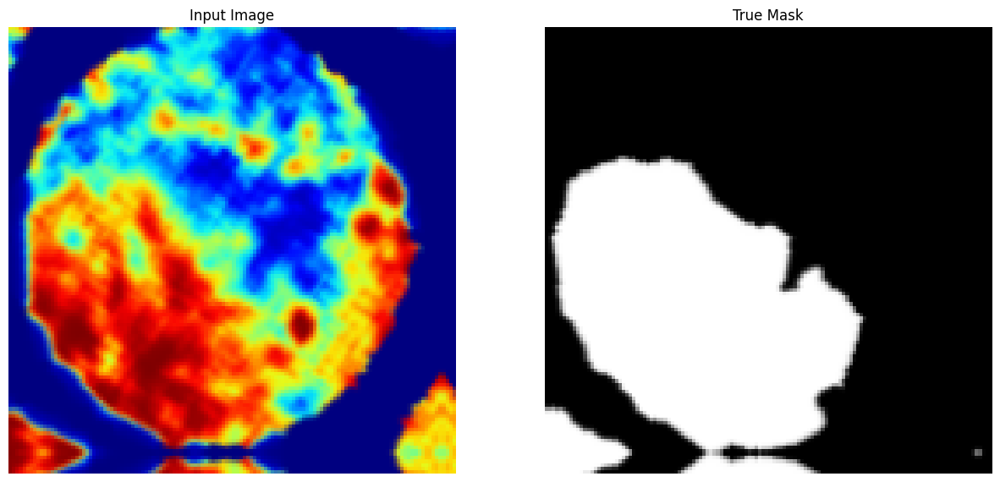

In [20]:
for images, masks in train_batches.take(2):
  sample_image, sample_mask = images[0], masks[0]
  display([sample_image, sample_mask])

In [21]:
base_model = tf.keras.applications.MobileNetV2(input_shape=[128, 128, 3], include_top=False)

# Use the activations of these layers
layer_names = [
    'block_1_expand_relu',   # 64x64
    'block_3_expand_relu',   # 32x32
    'block_6_expand_relu',   # 16x16
    'block_13_expand_relu',  # 8x8
    'block_16_project',      # 4x4
]
base_model_outputs = [base_model.get_layer(name).output for name in layer_names]

# Create the feature extraction model
down_stack = tf.keras.Model(inputs=base_model.input, outputs=base_model_outputs)

# Make the last two layers trainable, but keep the rest frozen
for layer in down_stack.layers:  # Exclude the last two layers
    layer.trainable = False

# # Now, set the last two layers to be trainable
# for layer in down_stack.layers[-1:]:
#     layer.trainable = True

In [22]:
from tensorflow_examples.models.pix2pix import pix2pix

up_stack = [
    pix2pix.upsample(512, 3),  # 4x4 -> 8x8
    pix2pix.upsample(256, 3),  # 8x8 -> 16x16
    pix2pix.upsample(128, 3),  # 16x16 -> 32x32
    pix2pix.upsample(64, 3),   # 32x32 -> 64x64
    pix2pix.upsample(32, 3),   # 64x64 -> 128x128
]

# Make the last two layers of the up_stack trainable, but keep the rest frozen
# for layer in up_stack[0:0]:  # Exclude the last two layers
#     layer.trainable = False

# # Now, set the last two layers to be trainable
for layer in up_stack:
    layer.trainable = True


In [23]:
def unet_model(output_channels:int):
  inputs = tf.keras.layers.Input(shape=[128, 128, 3])

  # Downsampling through the model
  skips = down_stack(inputs)
  x = skips[-1]
  skips = reversed(skips[:-1])

  # Upsampling and establishing the skip connections
  for up, skip in zip(up_stack, skips):
    x = up(x)
    concat = tf.keras.layers.Concatenate()
    x = concat([x, skip])

  # This is the last layer of the model
  last = tf.keras.layers.Conv2DTranspose(
      filters=output_channels, kernel_size=3, strides=2,
      padding='same')  #64x64 -> 128x128

  x = last(x)

  return tf.keras.Model(inputs=inputs, outputs=x)

In [24]:
# Try the model
def create_mask(pred_mask):
  pred_mask = tf.argmax(pred_mask, axis=-1)
  pred_mask = pred_mask[..., tf.newaxis]
  return pred_mask[0]

In [25]:
class WeightedSCCE(tf.keras.losses.Loss):
    def __init__(self, class_weight, from_logits=False, name='weighted_scce'):
        if class_weight is None or all(v == 1. for v in class_weight):
            self.class_weight = None
        else:
            self.class_weight = tf.convert_to_tensor(class_weight,
                dtype=tf.float32)
        self.name = name
        self.reduction = tf.keras.losses.Reduction.NONE
        self.unreduced_scce = tf.keras.losses.SparseCategoricalCrossentropy(
            from_logits=from_logits, name=name,
            reduction=self.reduction)

    def __call__(self, y_true, y_pred, sample_weight=None):
        y_true = tf.cast(y_true, dtype=tf.int32)
        loss = self.unreduced_scce(y_true, y_pred, sample_weight)
        if self.class_weight is not None:
            weight_mask = tf.gather(self.class_weight, y_true)
            loss = tf.math.multiply(loss, weight_mask)
        return loss


In [26]:
import tensorflow as tf
# Assuming OUTPUT_CLASSES is the number of classes in your segmentation task
OUTPUT_CLASSES = 2

# Create the U-Net model
model = unet_model(output_channels=OUTPUT_CLASSES)

# Compile the model
model.compile(optimizer='adam',
              loss = tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True),
              metrics=['accuracy'])

In [27]:
def show_predictions(dataset=None, num=1):
  if dataset:
    for image, mask in dataset.take(num):
      pred_mask = model.predict(image)
      display([image[0], mask[0], create_mask(pred_mask)])
  else:
    display([sample_image, sample_mask,
             create_mask(model.predict(sample_image[tf.newaxis, ...]))])

1/1 [==============================] - 1s 706ms/step


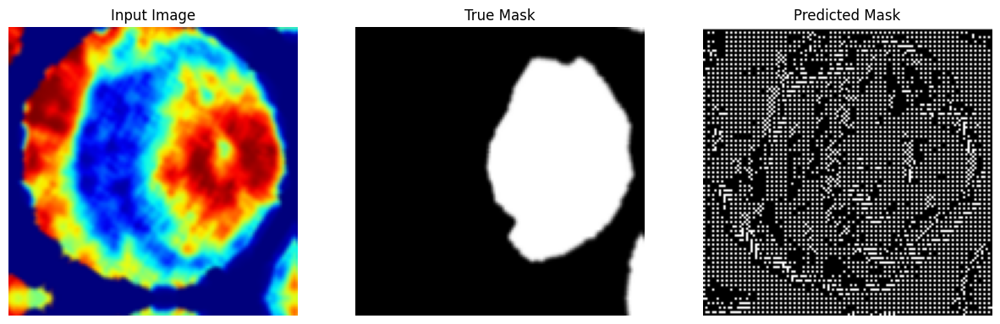

1/1 [==============================] - 0s 115ms/step


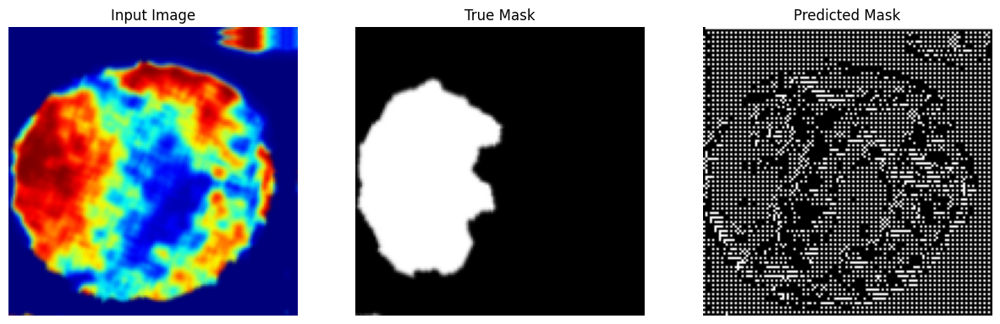

1/1 [==============================] - 0s 127ms/step


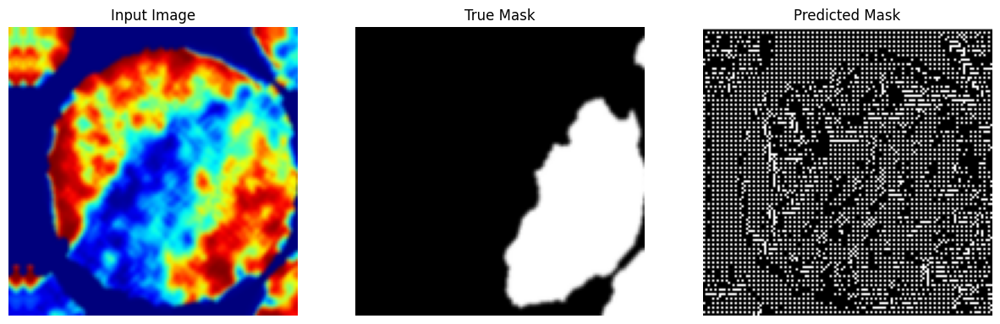

In [28]:
show_predictions(train_batches, 3)

In [29]:
from IPython.display import clear_output

class DisplayCallback(tf.keras.callbacks.Callback):
  def on_epoch_end(self, epoch, logs=None):
    #clear_output(wait=True)
    show_predictions(train_batches, 1)
    print ('\nSample Prediction after epoch {}\n'.format(epoch+1))

The number of steps per epoch is:  1
Epoch 1/200
1/1 [==============================] - 0s 105ms/step


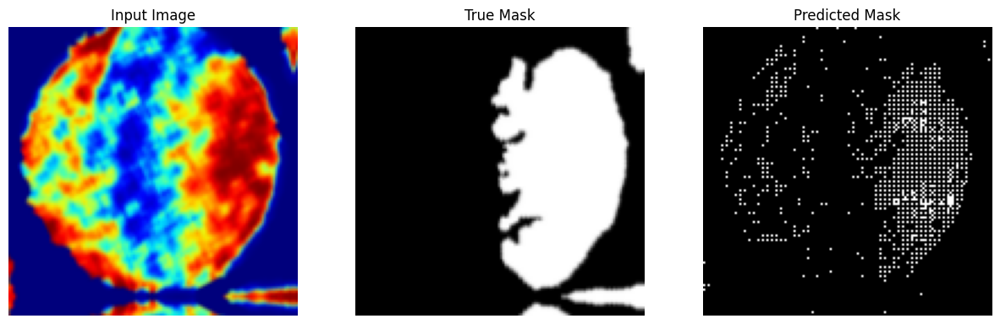


Sample Prediction after epoch 1
12/12 [==============================] - 7s 328ms/step - loss: 0.5362 - accuracy: 0.6724 - val_loss: 0.5071 - val_accuracy: 0.7785
Epoch 2/200
1/1 [==============================] - 0s 109ms/step


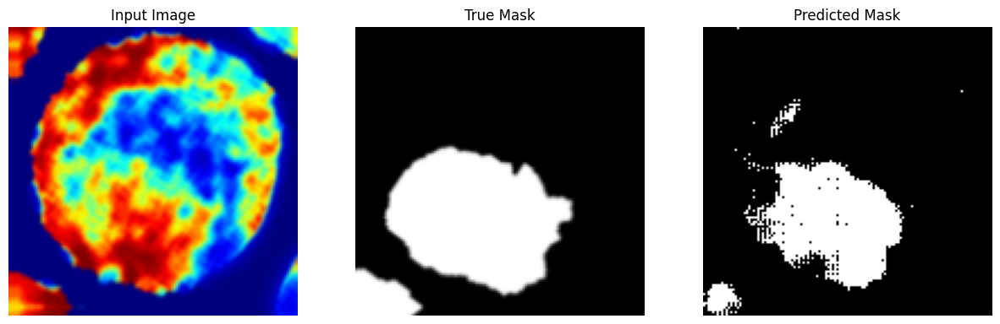


Sample Prediction after epoch 2

12/12 [==============================] - 3s 260ms/step - loss: 0.3044 - accuracy: 0.8041 - val_loss: 0.4604 - val_accuracy: 0.8143
Epoch 3/200
1/1 [==============================] - 0s 98ms/step


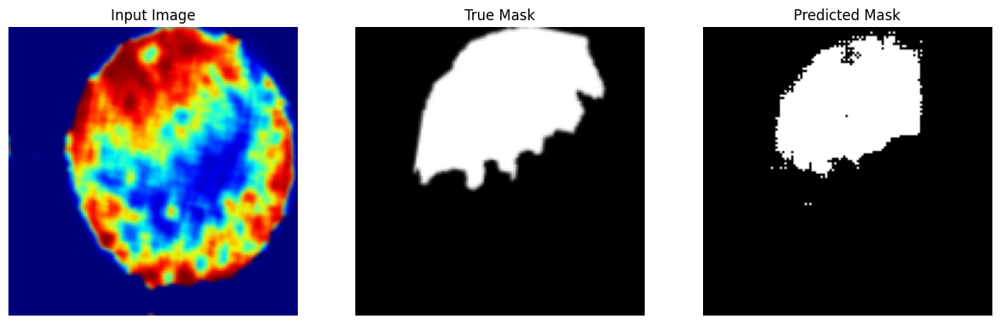


Sample Prediction after epoch 3

12/12 [==============================] - 3s 242ms/step - loss: 0.2172 - accuracy: 0.8407 - val_loss: 0.4834 - val_accuracy: 0.8415
Epoch 4/200
1/1 [==============================] - 0s 107ms/step


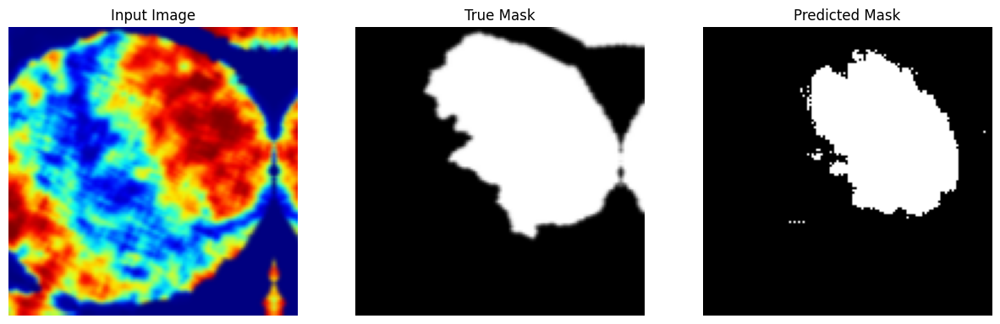


Sample Prediction after epoch 4

12/12 [==============================] - 3s 253ms/step - loss: 0.1846 - accuracy: 0.8559 - val_loss: 0.4332 - val_accuracy: 0.8656
Epoch 5/200
1/1 [==============================] - 0s 89ms/step


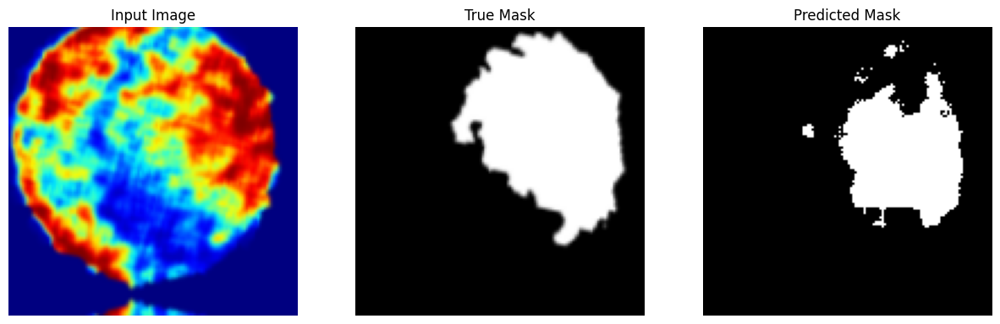


Sample Prediction after epoch 5

12/12 [==============================] - 3s 238ms/step - loss: 0.1766 - accuracy: 0.8604 - val_loss: 0.5430 - val_accuracy: 0.8304
Epoch 6/200
1/1 [==============================] - 0s 96ms/step


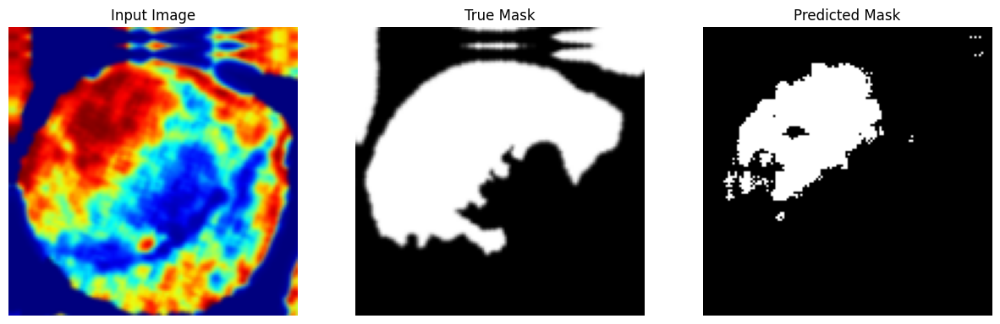


Sample Prediction after epoch 6

12/12 [==============================] - 3s 235ms/step - loss: 0.1405 - accuracy: 0.8750 - val_loss: 0.3544 - val_accuracy: 0.8733
Epoch 7/200
1/1 [==============================] - 0s 96ms/step


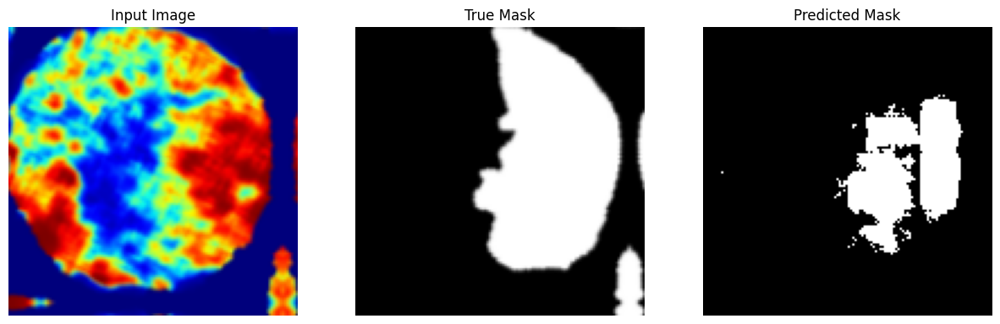


Sample Prediction after epoch 7

12/12 [==============================] - 3s 237ms/step - loss: 0.1398 - accuracy: 0.8744 - val_loss: 0.4967 - val_accuracy: 0.8268
Epoch 8/200
1/1 [==============================] - 0s 90ms/step


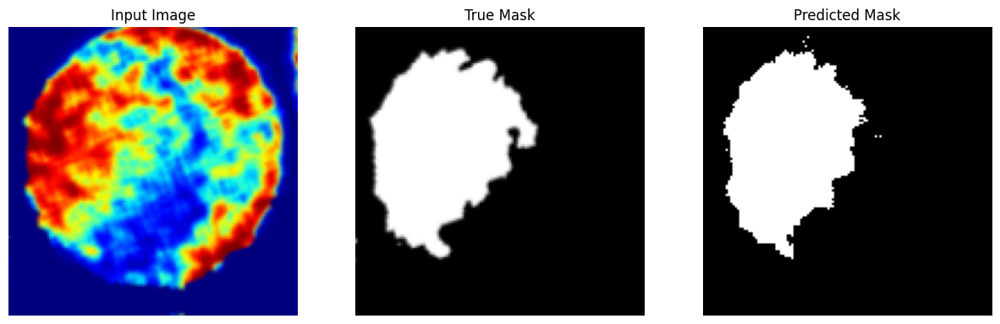


Sample Prediction after epoch 8

12/12 [==============================] - 3s 222ms/step - loss: 0.1311 - accuracy: 0.8758 - val_loss: 0.2348 - val_accuracy: 0.9112
Epoch 9/200
1/1 [==============================] - 0s 96ms/step


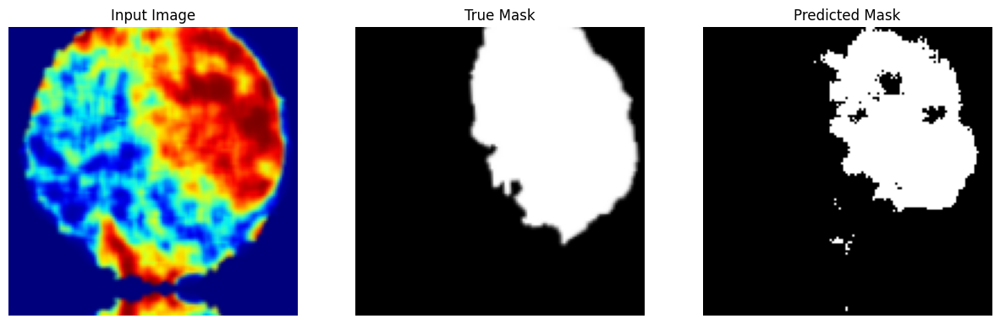


Sample Prediction after epoch 9

12/12 [==============================] - 3s 220ms/step - loss: 0.1337 - accuracy: 0.8746 - val_loss: 0.3079 - val_accuracy: 0.8891
Epoch 10/200
1/1 [==============================] - 0s 108ms/step


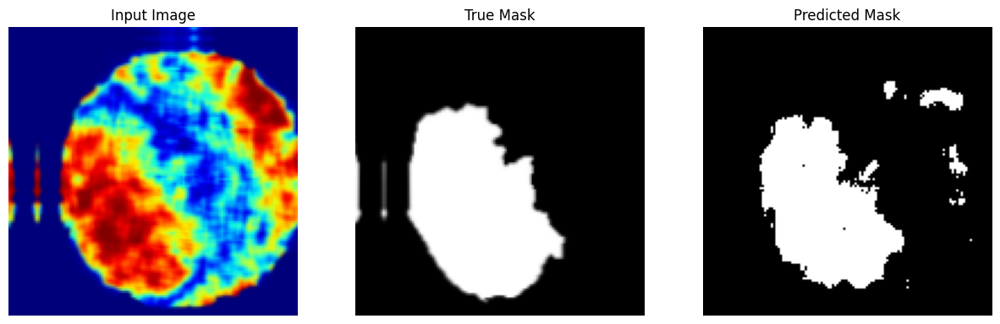


Sample Prediction after epoch 10

12/12 [==============================] - 3s 249ms/step - loss: 0.1294 - accuracy: 0.8800 - val_loss: 0.2436 - val_accuracy: 0.9104
Epoch 11/200
1/1 [==============================] - 0s 281ms/step


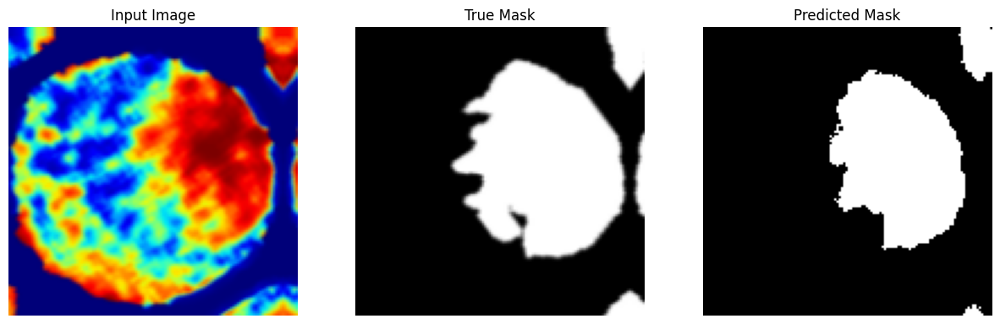


Sample Prediction after epoch 11

12/12 [==============================] - 3s 271ms/step - loss: 0.1224 - accuracy: 0.8792 - val_loss: 0.3428 - val_accuracy: 0.8835
Epoch 12/200
1/1 [==============================] - 0s 148ms/step


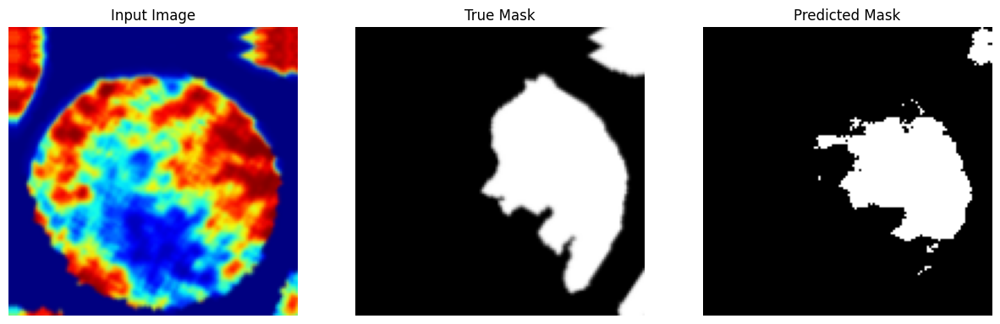


Sample Prediction after epoch 12

12/12 [==============================] - 3s 265ms/step - loss: 0.1211 - accuracy: 0.8792 - val_loss: 0.3448 - val_accuracy: 0.8770
Epoch 13/200
1/1 [==============================] - 0s 181ms/step


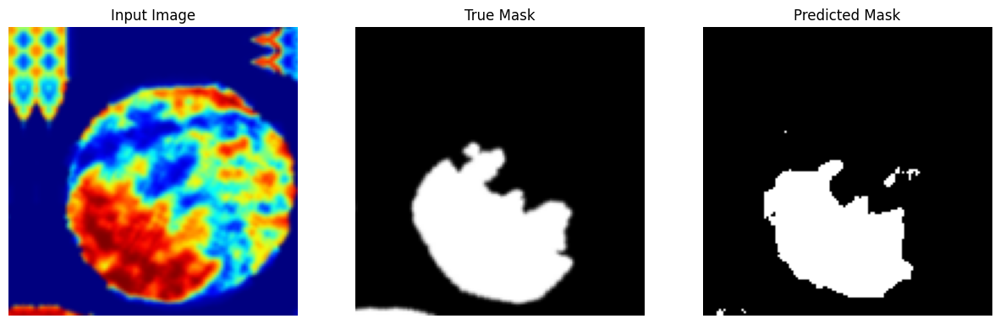


Sample Prediction after epoch 13

12/12 [==============================] - 3s 253ms/step - loss: 0.1096 - accuracy: 0.8831 - val_loss: 0.2527 - val_accuracy: 0.9035
Epoch 14/200
1/1 [==============================] - 0s 171ms/step


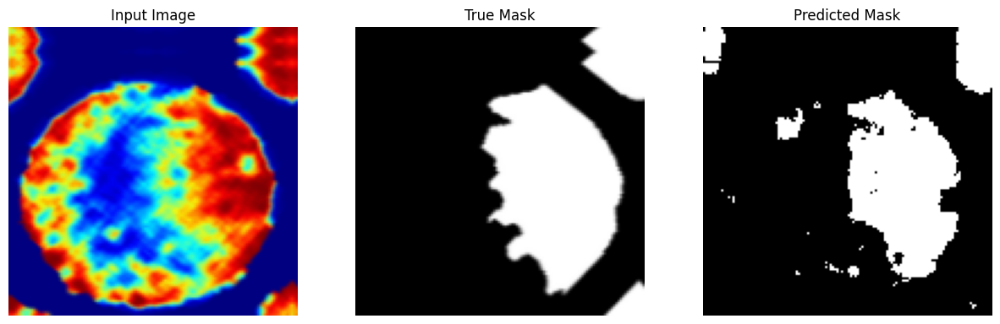


Sample Prediction after epoch 14

12/12 [==============================] - 3s 287ms/step - loss: 0.1217 - accuracy: 0.8793 - val_loss: 0.2267 - val_accuracy: 0.9159
Epoch 15/200
1/1 [==============================] - 0s 204ms/step


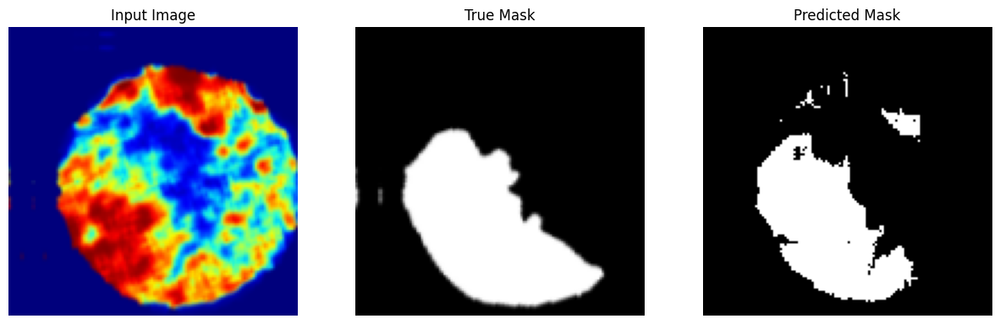


Sample Prediction after epoch 15

12/12 [==============================] - 3s 262ms/step - loss: 0.1256 - accuracy: 0.8777 - val_loss: 0.2905 - val_accuracy: 0.8903
Epoch 16/200
1/1 [==============================] - 0s 156ms/step


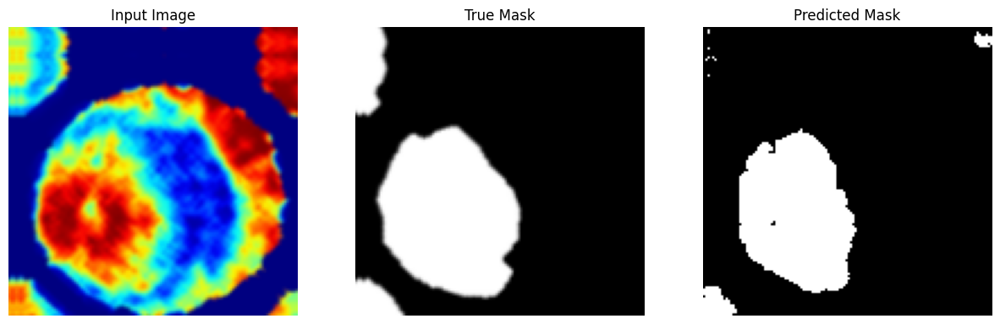


Sample Prediction after epoch 16

12/12 [==============================] - 3s 264ms/step - loss: 0.1137 - accuracy: 0.8830 - val_loss: 0.3503 - val_accuracy: 0.8839
Epoch 17/200
1/1 [==============================] - 0s 205ms/step


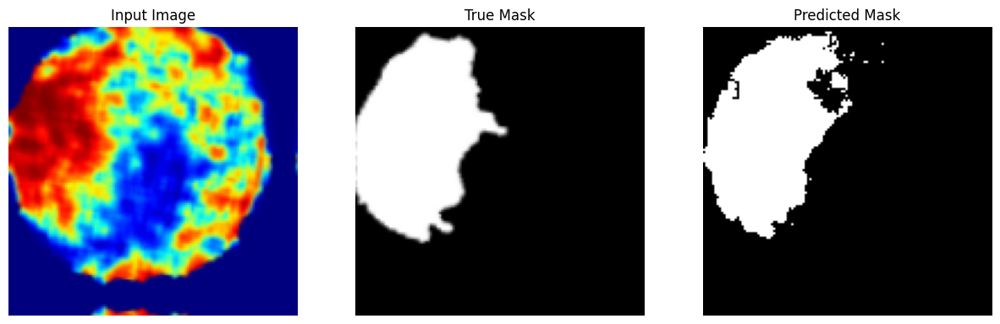


Sample Prediction after epoch 17

12/12 [==============================] - 3s 262ms/step - loss: 0.1167 - accuracy: 0.8824 - val_loss: 0.2339 - val_accuracy: 0.9154
Epoch 18/200
1/1 [==============================] - 0s 109ms/step


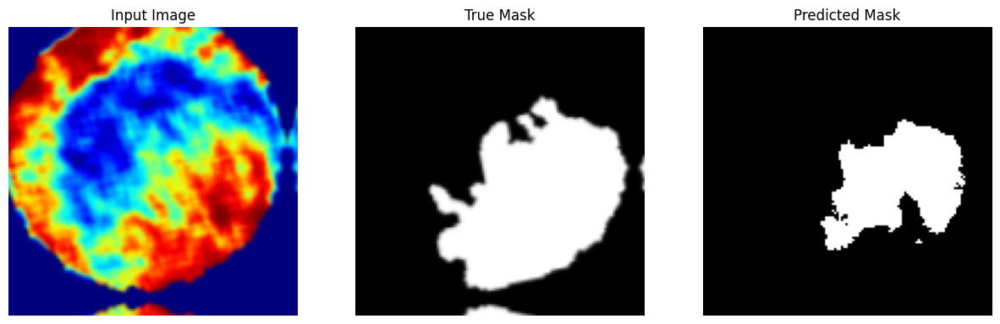


Sample Prediction after epoch 18

12/12 [==============================] - 3s 247ms/step - loss: 0.1102 - accuracy: 0.8816 - val_loss: 0.4377 - val_accuracy: 0.8545
Epoch 19/200
1/1 [==============================] - 0s 93ms/step


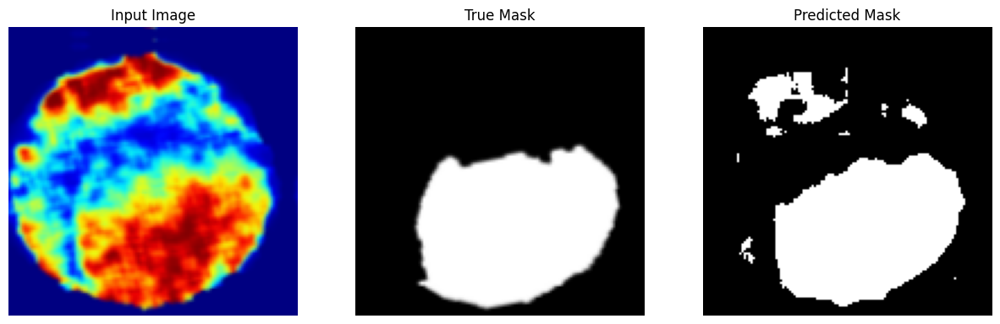


Sample Prediction after epoch 19
12/12 [==============================] - 3s 257ms/step - loss: 0.0982 - accuracy: 0.8928 - val_loss: 0.1576 - val_accuracy: 0.9418
Epoch 20/200
1/1 [==============================] - 0s 147ms/step


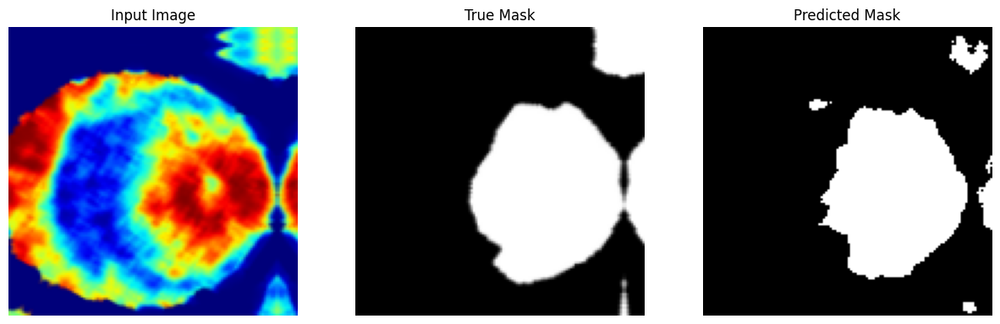


Sample Prediction after epoch 20

12/12 [==============================] - 4s 308ms/step - loss: 0.1187 - accuracy: 0.8806 - val_loss: 0.1740 - val_accuracy: 0.9386
Epoch 21/200
1/1 [==============================] - 0s 110ms/step


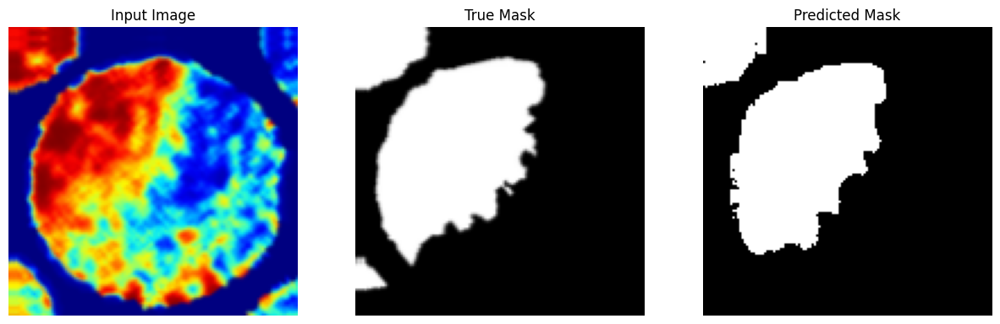


Sample Prediction after epoch 21

12/12 [==============================] - 3s 239ms/step - loss: 0.1079 - accuracy: 0.8820 - val_loss: 0.2123 - val_accuracy: 0.9237
Epoch 22/200
1/1 [==============================] - 0s 115ms/step


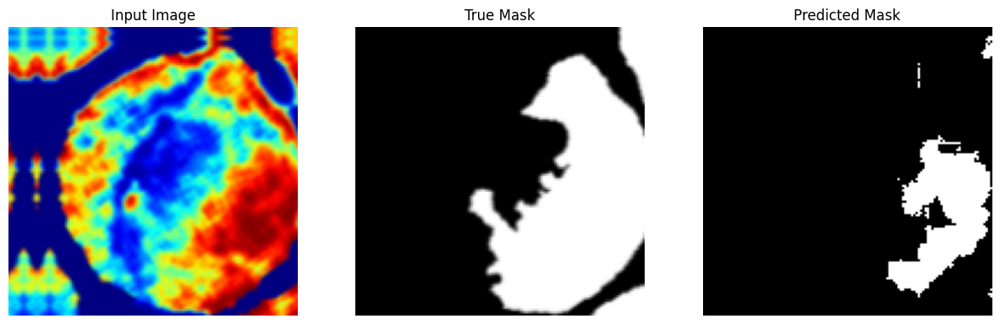


Sample Prediction after epoch 22

12/12 [==============================] - 3s 260ms/step - loss: 0.1058 - accuracy: 0.8808 - val_loss: 0.5055 - val_accuracy: 0.8397
Epoch 23/200
1/1 [==============================] - 0s 101ms/step


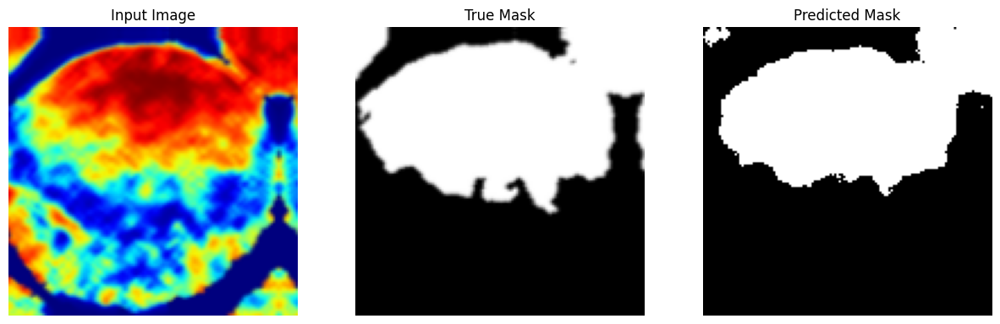


Sample Prediction after epoch 23

12/12 [==============================] - 3s 261ms/step - loss: 0.1105 - accuracy: 0.8825 - val_loss: 0.1718 - val_accuracy: 0.9402
Epoch 24/200
1/1 [==============================] - 0s 151ms/step


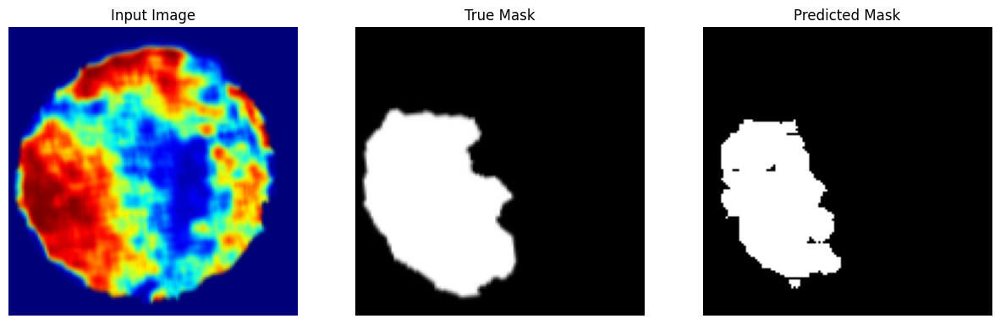


Sample Prediction after epoch 24

12/12 [==============================] - 4s 383ms/step - loss: 0.1035 - accuracy: 0.8848 - val_loss: 0.3791 - val_accuracy: 0.8837
Epoch 25/200
1/1 [==============================] - 0s 132ms/step


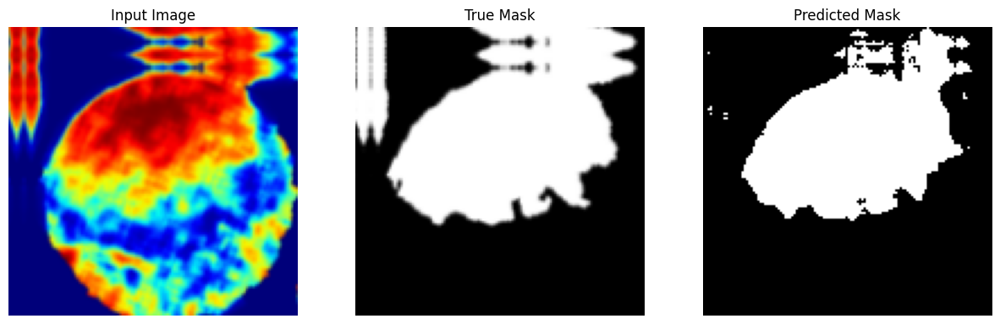


Sample Prediction after epoch 25

12/12 [==============================] - 4s 323ms/step - loss: 0.1037 - accuracy: 0.8856 - val_loss: 0.1371 - val_accuracy: 0.9492
Epoch 26/200
1/1 [==============================] - 0s 120ms/step


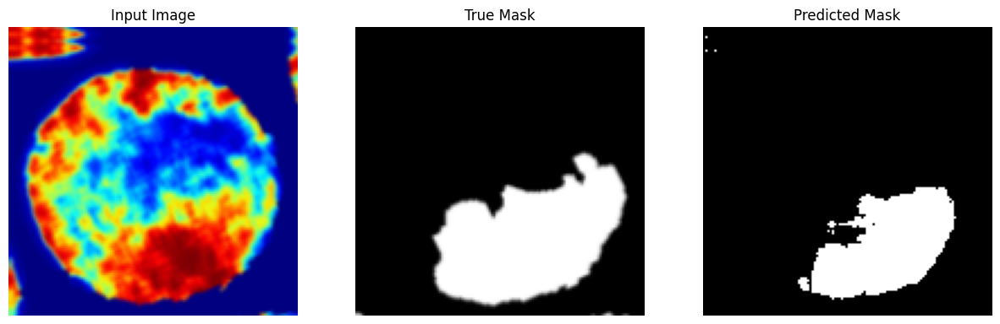


Sample Prediction after epoch 26

12/12 [==============================] - 4s 336ms/step - loss: 0.0966 - accuracy: 0.8903 - val_loss: 0.3086 - val_accuracy: 0.9095
Epoch 27/200
1/1 [==============================] - 0s 110ms/step


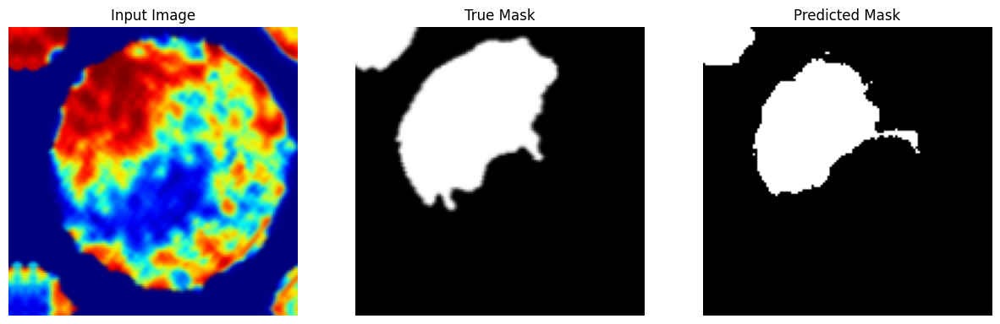


Sample Prediction after epoch 27

12/12 [==============================] - 4s 316ms/step - loss: 0.0980 - accuracy: 0.8888 - val_loss: 0.3287 - val_accuracy: 0.8937
Epoch 28/200
1/1 [==============================] - 0s 95ms/step


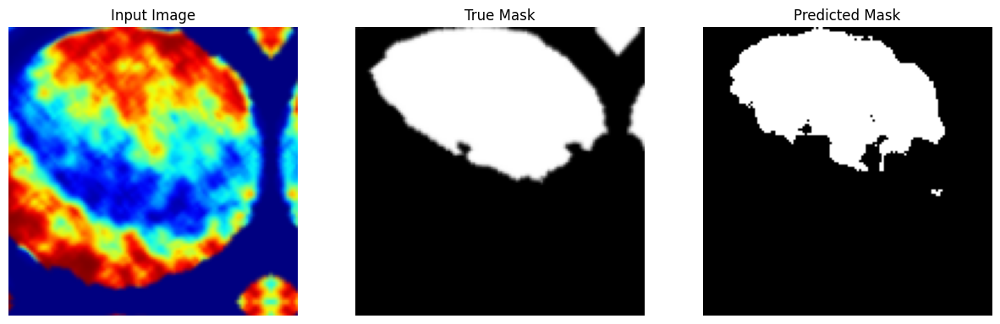


Sample Prediction after epoch 28

12/12 [==============================] - 3s 232ms/step - loss: 0.0967 - accuracy: 0.8915 - val_loss: 0.2438 - val_accuracy: 0.9175
Epoch 29/200
1/1 [==============================] - 0s 91ms/step


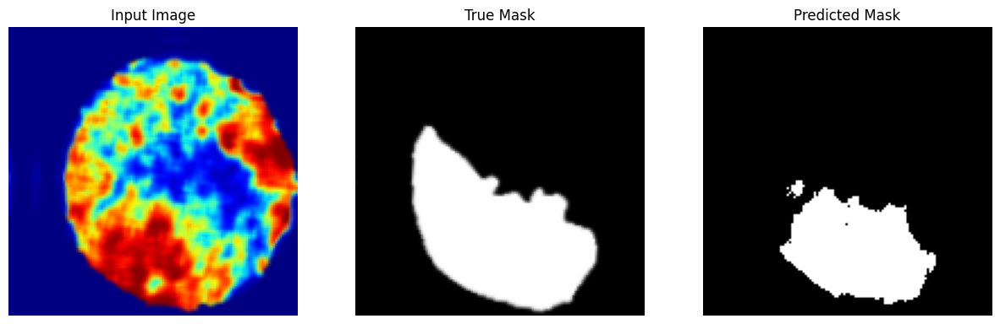


Sample Prediction after epoch 29

12/12 [==============================] - 3s 223ms/step - loss: 0.0997 - accuracy: 0.8844 - val_loss: 0.2930 - val_accuracy: 0.9028
Epoch 30/200
1/1 [==============================] - 0s 89ms/step


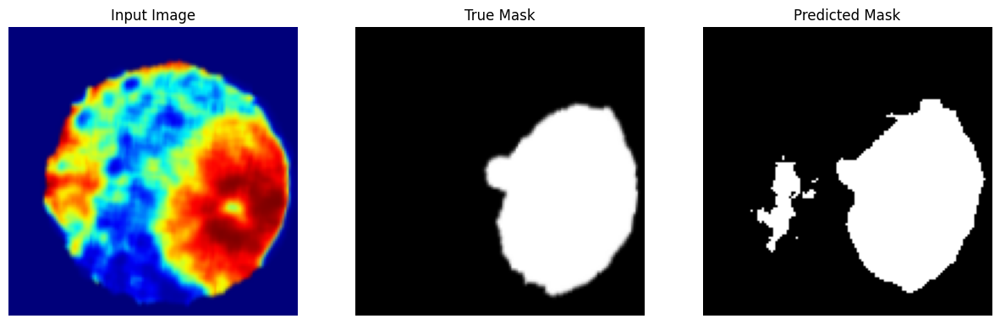


Sample Prediction after epoch 30

12/12 [==============================] - 3s 215ms/step - loss: 0.1000 - accuracy: 0.8883 - val_loss: 0.1636 - val_accuracy: 0.9415
Epoch 31/200
1/1 [==============================] - 0s 90ms/step


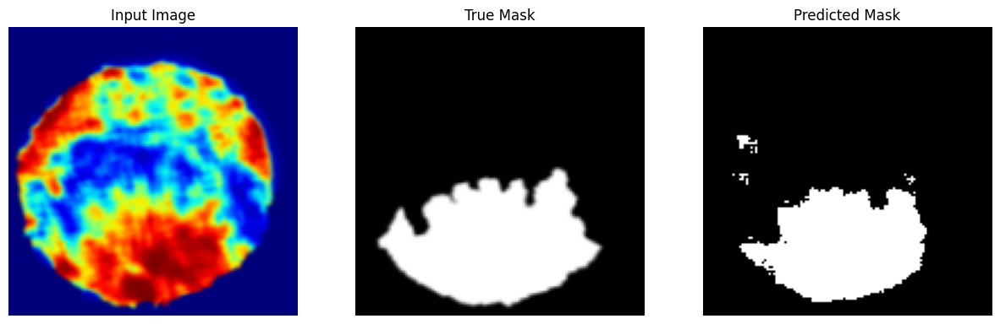


Sample Prediction after epoch 31

12/12 [==============================] - 3s 217ms/step - loss: 0.1089 - accuracy: 0.8854 - val_loss: 0.2246 - val_accuracy: 0.9238
Epoch 32/200
1/1 [==============================] - 0s 91ms/step


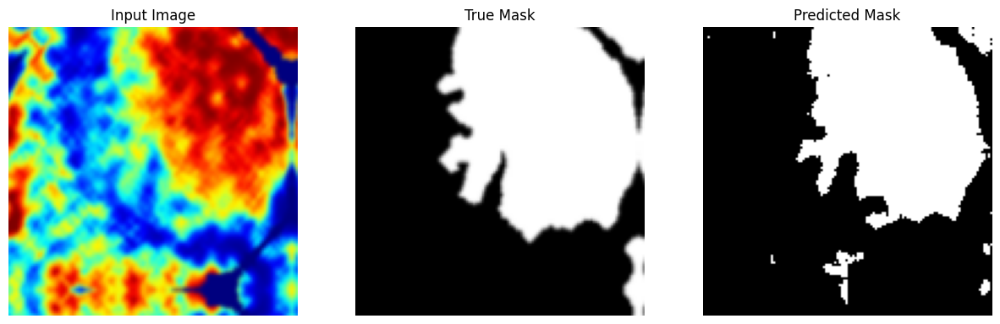


Sample Prediction after epoch 32

12/12 [==============================] - 3s 218ms/step - loss: 0.0985 - accuracy: 0.8844 - val_loss: 0.2081 - val_accuracy: 0.9284
Epoch 33/200
1/1 [==============================] - 0s 112ms/step


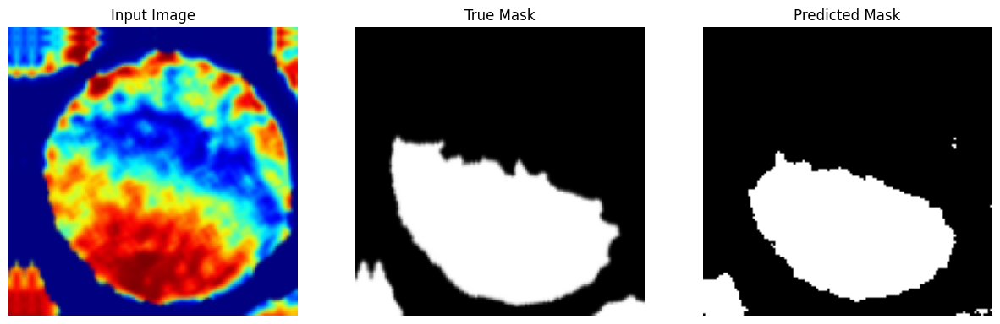


Sample Prediction after epoch 33

12/12 [==============================] - 3s 236ms/step - loss: 0.0957 - accuracy: 0.8868 - val_loss: 0.3302 - val_accuracy: 0.8979
Epoch 34/200
1/1 [==============================] - 0s 94ms/step


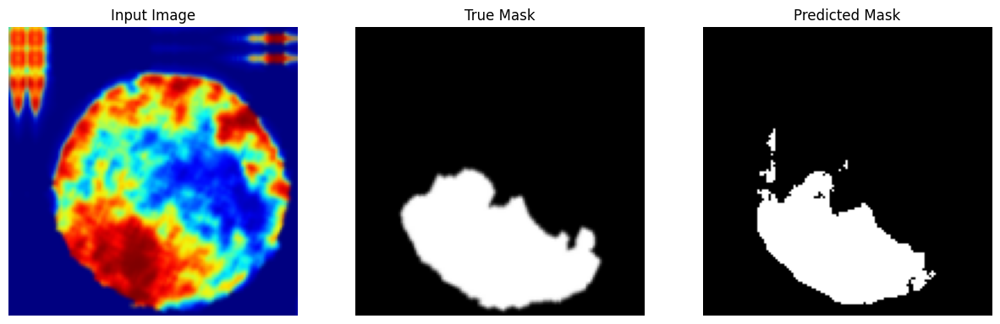


Sample Prediction after epoch 34

12/12 [==============================] - 3s 223ms/step - loss: 0.0909 - accuracy: 0.8934 - val_loss: 0.1900 - val_accuracy: 0.9310
Epoch 35/200
1/1 [==============================] - 0s 98ms/step


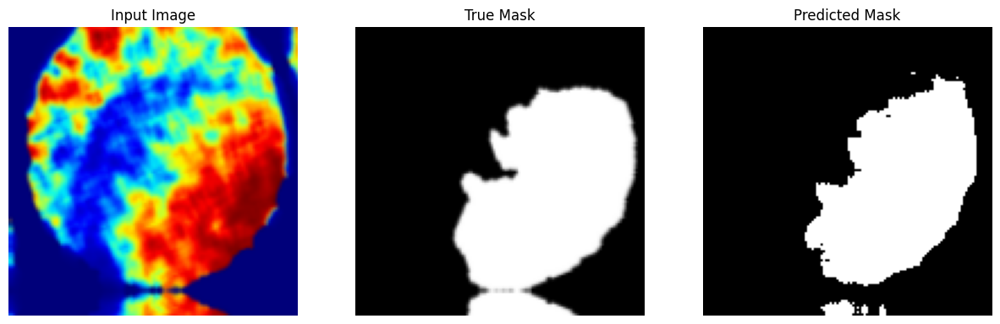


Sample Prediction after epoch 35

12/12 [==============================] - 3s 243ms/step - loss: 0.0991 - accuracy: 0.8869 - val_loss: 0.2411 - val_accuracy: 0.9154
Epoch 36/200
1/1 [==============================] - 0s 92ms/step


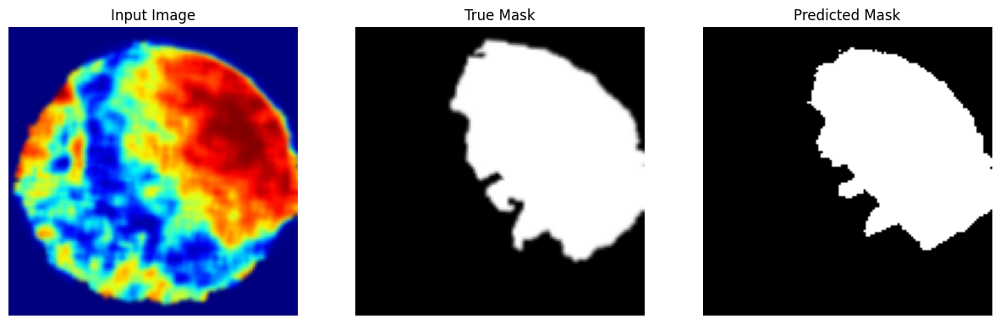


Sample Prediction after epoch 36

12/12 [==============================] - 3s 249ms/step - loss: 0.1008 - accuracy: 0.8896 - val_loss: 0.1923 - val_accuracy: 0.9337
Epoch 37/200
1/1 [==============================] - 0s 93ms/step


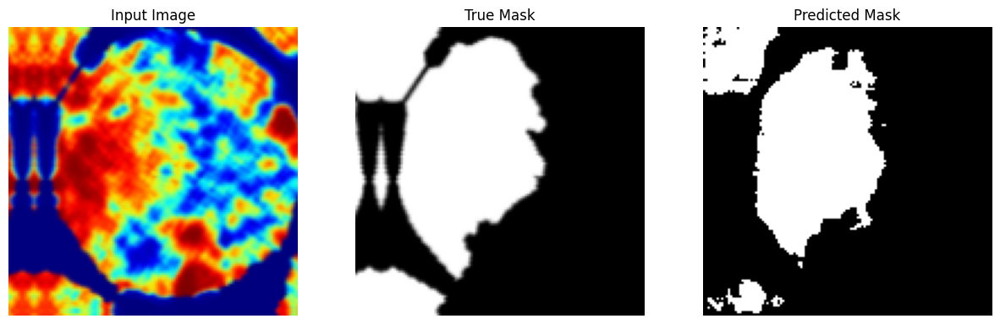


Sample Prediction after epoch 37

12/12 [==============================] - 3s 228ms/step - loss: 0.0971 - accuracy: 0.8895 - val_loss: 0.1939 - val_accuracy: 0.9328
Epoch 38/200
1/1 [==============================] - 0s 91ms/step


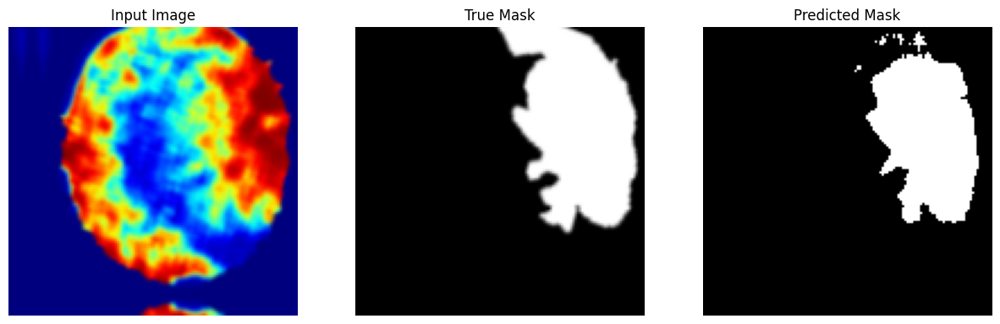


Sample Prediction after epoch 38

12/12 [==============================] - 3s 235ms/step - loss: 0.1040 - accuracy: 0.8851 - val_loss: 0.1740 - val_accuracy: 0.9355
Epoch 39/200
1/1 [==============================] - 0s 101ms/step


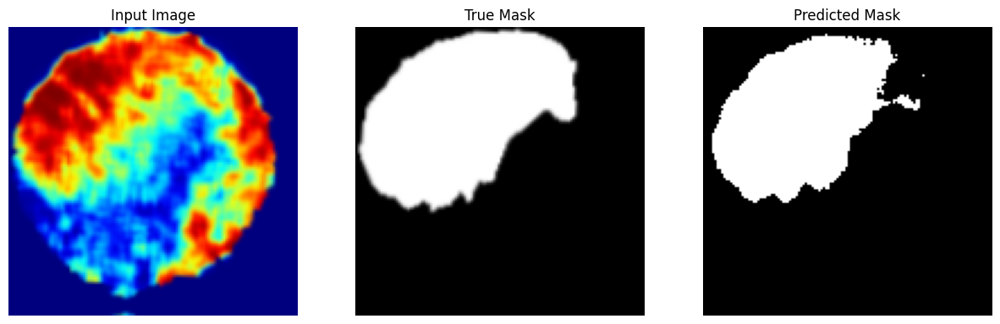


Sample Prediction after epoch 39

12/12 [==============================] - 3s 233ms/step - loss: 0.0971 - accuracy: 0.8861 - val_loss: 0.1734 - val_accuracy: 0.9416
Epoch 40/200
1/1 [==============================] - 0s 96ms/step


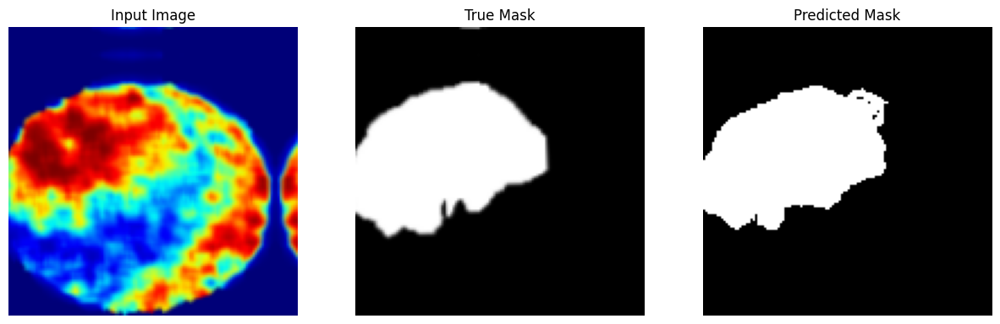


Sample Prediction after epoch 40

12/12 [==============================] - 3s 231ms/step - loss: 0.0856 - accuracy: 0.8936 - val_loss: 0.2016 - val_accuracy: 0.9329
Epoch 41/200
1/1 [==============================] - 0s 96ms/step


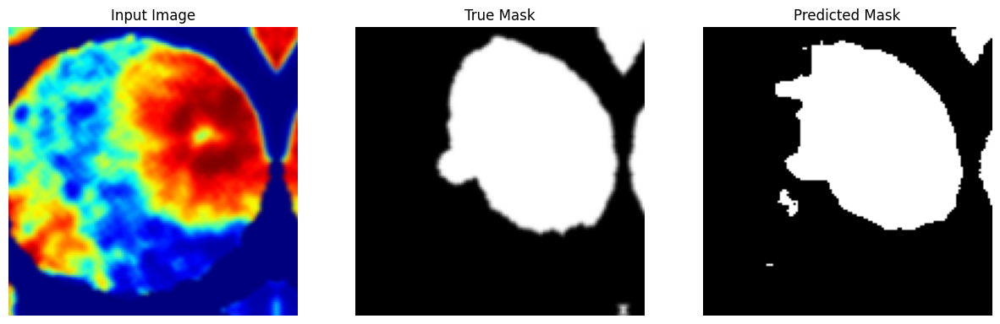


Sample Prediction after epoch 41

12/12 [==============================] - 3s 235ms/step - loss: 0.1033 - accuracy: 0.8844 - val_loss: 0.1411 - val_accuracy: 0.9482
Epoch 42/200
1/1 [==============================] - 0s 92ms/step


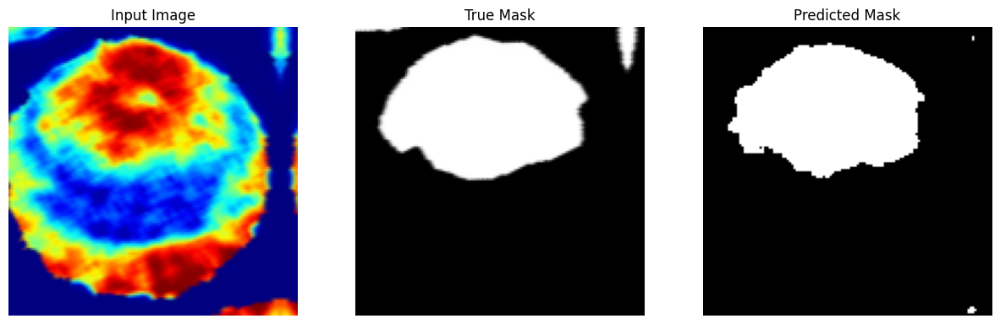


Sample Prediction after epoch 42

12/12 [==============================] - 3s 247ms/step - loss: 0.0881 - accuracy: 0.8897 - val_loss: 0.1723 - val_accuracy: 0.9410
Epoch 43/200
1/1 [==============================] - 0s 92ms/step


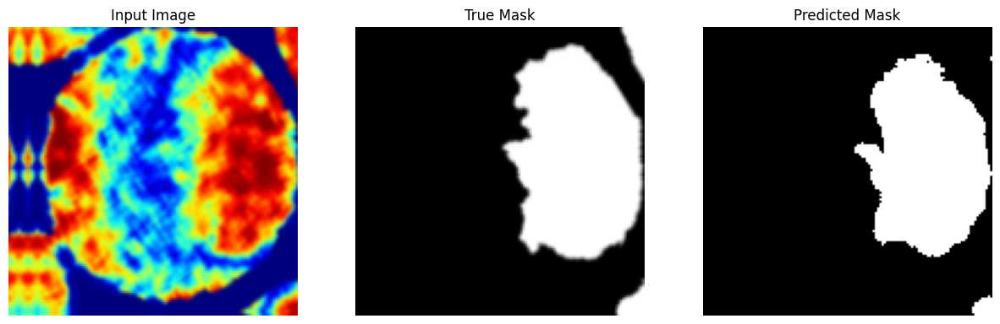


Sample Prediction after epoch 43

12/12 [==============================] - 3s 239ms/step - loss: 0.0923 - accuracy: 0.8903 - val_loss: 0.1630 - val_accuracy: 0.9447
Epoch 44/200
1/1 [==============================] - 0s 95ms/step


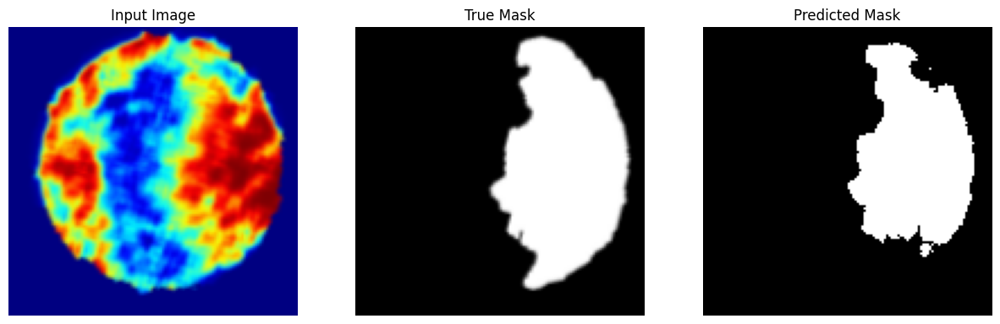


Sample Prediction after epoch 44

12/12 [==============================] - 3s 226ms/step - loss: 0.0952 - accuracy: 0.8899 - val_loss: 0.2237 - val_accuracy: 0.9243
Epoch 45/200
1/1 [==============================] - 0s 95ms/step


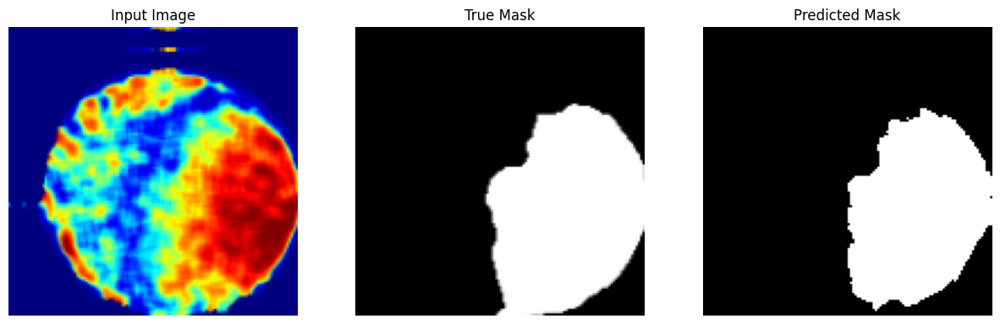


Sample Prediction after epoch 45

12/12 [==============================] - 3s 227ms/step - loss: 0.0855 - accuracy: 0.8919 - val_loss: 0.1671 - val_accuracy: 0.9383
Epoch 46/200
1/1 [==============================] - 0s 91ms/step


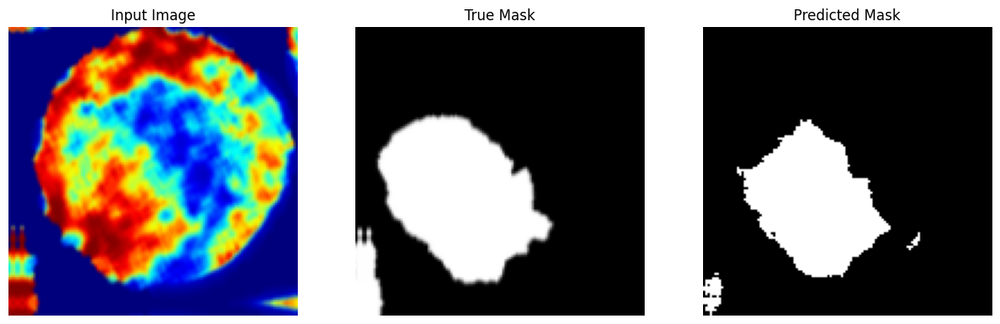


Sample Prediction after epoch 46

12/12 [==============================] - 3s 234ms/step - loss: 0.0870 - accuracy: 0.8903 - val_loss: 0.1764 - val_accuracy: 0.9371
Epoch 47/200
1/1 [==============================] - 0s 95ms/step


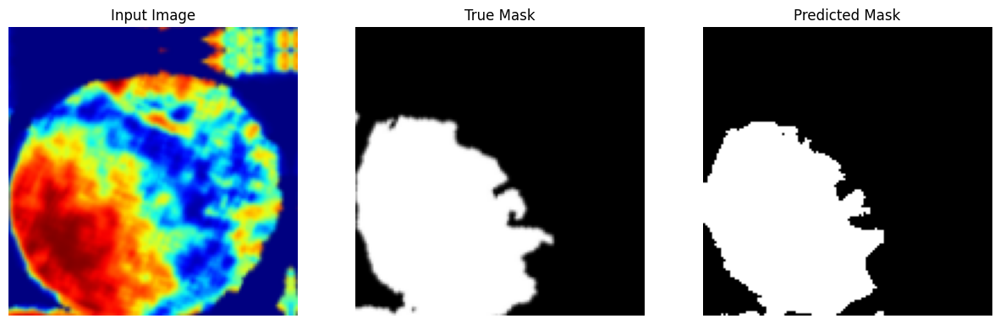


Sample Prediction after epoch 47

12/12 [==============================] - 3s 231ms/step - loss: 0.0969 - accuracy: 0.8849 - val_loss: 0.1408 - val_accuracy: 0.9484
Epoch 48/200
1/1 [==============================] - 0s 92ms/step


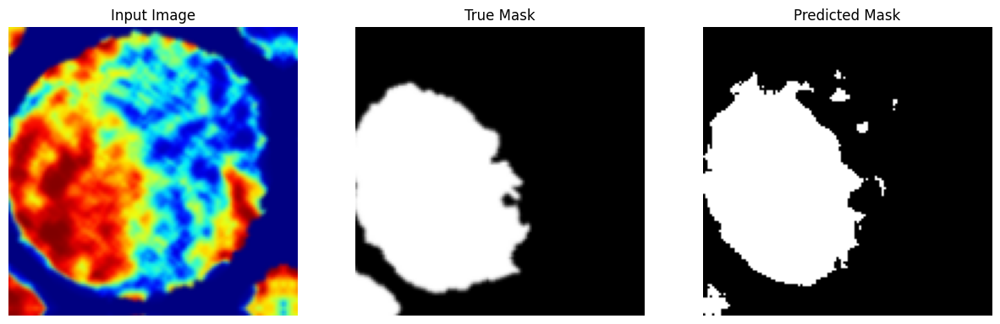


Sample Prediction after epoch 48

12/12 [==============================] - 3s 229ms/step - loss: 0.0877 - accuracy: 0.8934 - val_loss: 0.1281 - val_accuracy: 0.9524
Epoch 49/200
1/1 [==============================] - 0s 91ms/step


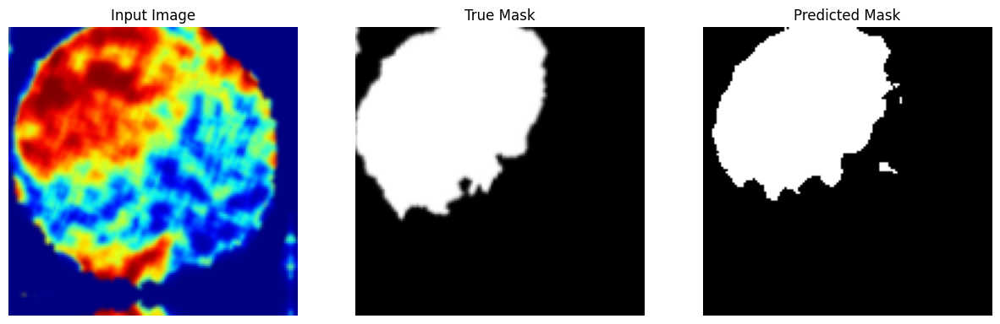


Sample Prediction after epoch 49

12/12 [==============================] - 3s 237ms/step - loss: 0.0805 - accuracy: 0.8978 - val_loss: 0.1560 - val_accuracy: 0.9446
Epoch 50/200
1/1 [==============================] - 0s 94ms/step


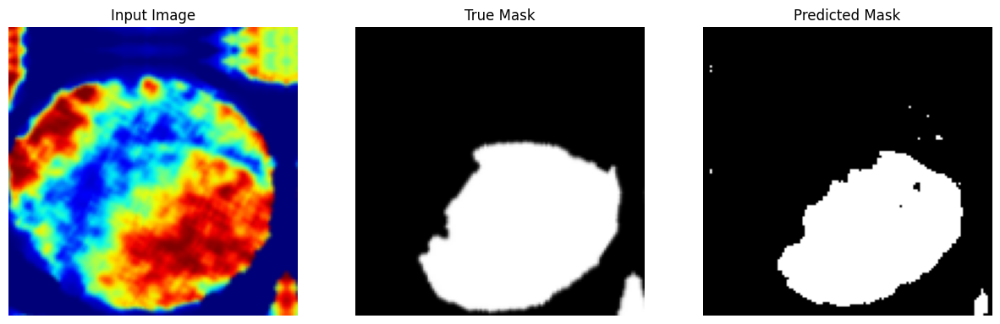


Sample Prediction after epoch 50

12/12 [==============================] - 3s 233ms/step - loss: 0.0935 - accuracy: 0.8864 - val_loss: 0.3906 - val_accuracy: 0.8899
Epoch 51/200
1/1 [==============================] - 0s 91ms/step


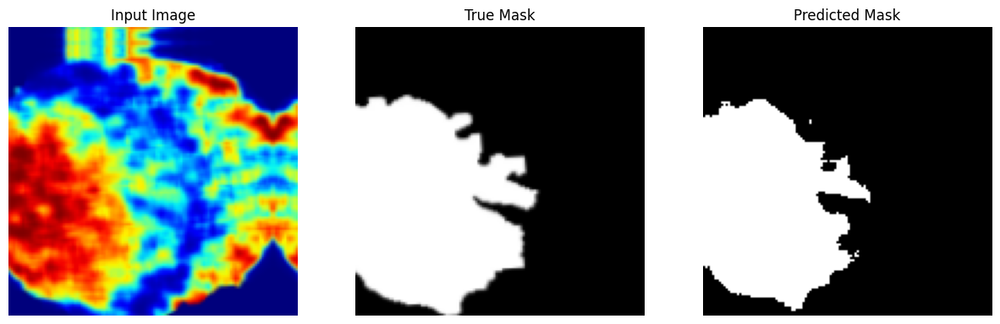


Sample Prediction after epoch 51

12/12 [==============================] - 3s 238ms/step - loss: 0.0894 - accuracy: 0.8900 - val_loss: 0.2383 - val_accuracy: 0.9263
Epoch 52/200
1/1 [==============================] - 0s 93ms/step


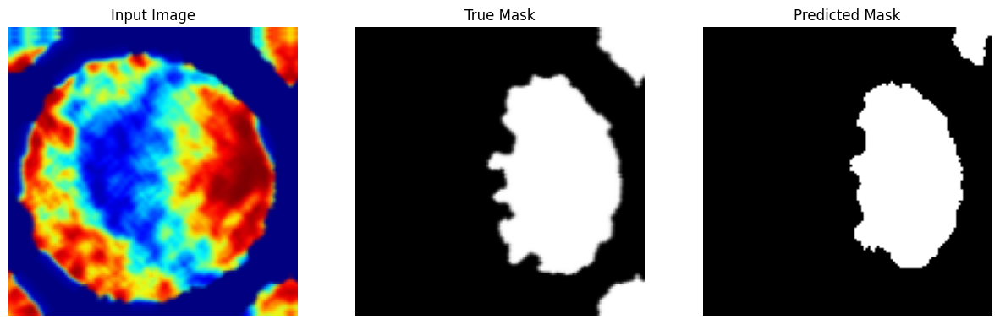


Sample Prediction after epoch 52

12/12 [==============================] - 3s 226ms/step - loss: 0.0760 - accuracy: 0.9010 - val_loss: 0.2164 - val_accuracy: 0.9296
Epoch 53/200
1/1 [==============================] - 0s 91ms/step


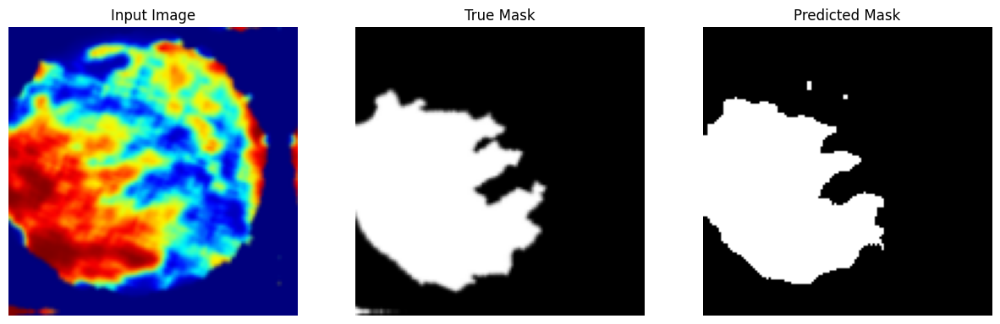


Sample Prediction after epoch 53

12/12 [==============================] - 3s 231ms/step - loss: 0.0896 - accuracy: 0.8886 - val_loss: 0.2267 - val_accuracy: 0.9258
Epoch 54/200
1/1 [==============================] - 0s 96ms/step


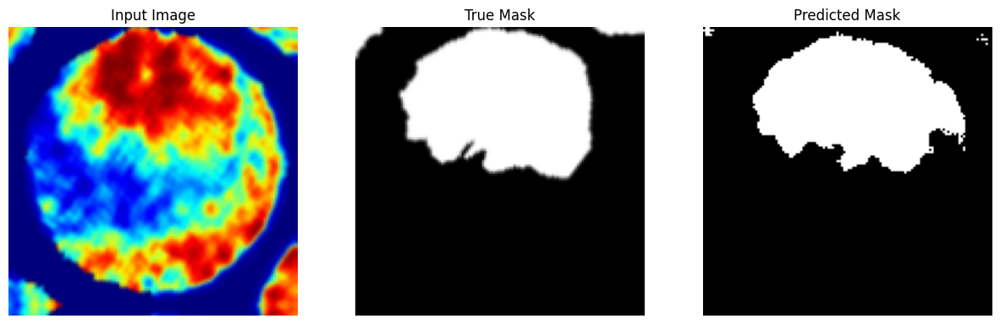


Sample Prediction after epoch 54

12/12 [==============================] - 3s 244ms/step - loss: 0.0857 - accuracy: 0.8931 - val_loss: 0.2217 - val_accuracy: 0.9289
Epoch 55/200
1/1 [==============================] - 0s 90ms/step


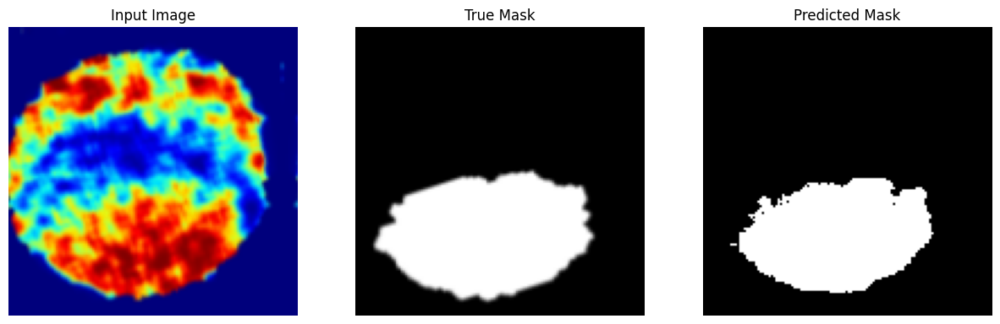


Sample Prediction after epoch 55

12/12 [==============================] - 3s 228ms/step - loss: 0.0986 - accuracy: 0.8844 - val_loss: 0.2674 - val_accuracy: 0.9157
Epoch 56/200
1/1 [==============================] - 0s 97ms/step


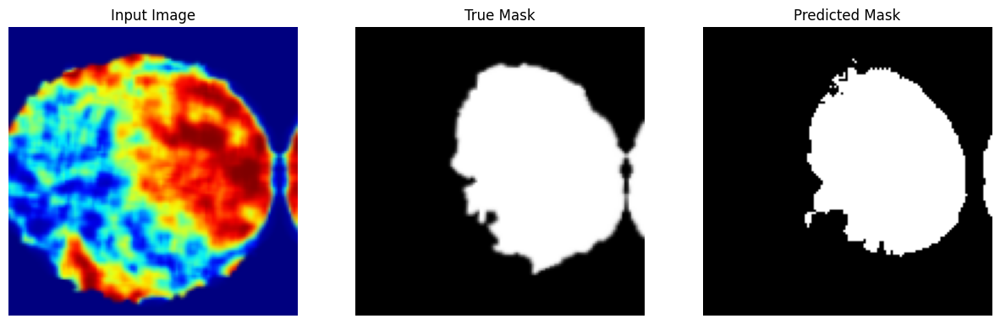


Sample Prediction after epoch 56

12/12 [==============================] - 3s 238ms/step - loss: 0.0859 - accuracy: 0.8922 - val_loss: 0.2048 - val_accuracy: 0.9315
Epoch 57/200
1/1 [==============================] - 0s 107ms/step


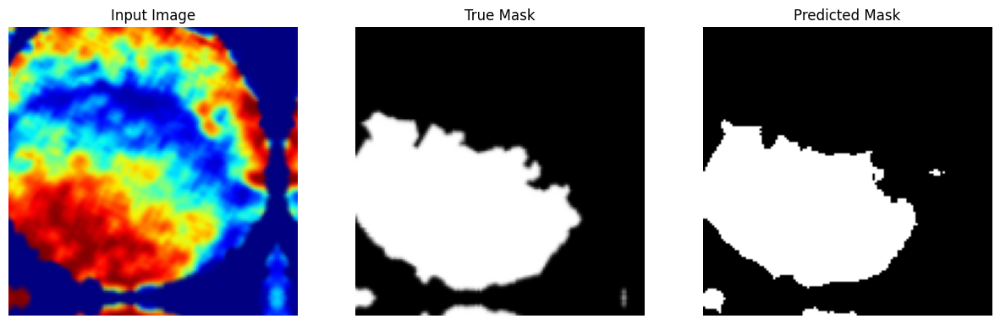


Sample Prediction after epoch 57

12/12 [==============================] - 3s 268ms/step - loss: 0.0867 - accuracy: 0.8970 - val_loss: 0.1778 - val_accuracy: 0.9350
Epoch 58/200
1/1 [==============================] - 0s 94ms/step


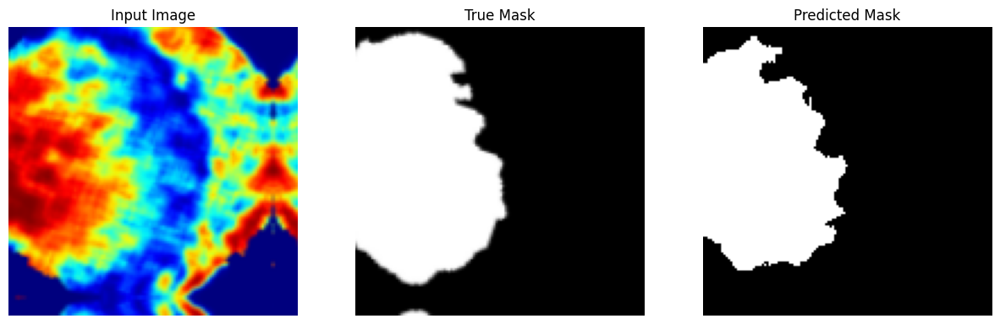


Sample Prediction after epoch 58

12/12 [==============================] - 3s 246ms/step - loss: 0.0829 - accuracy: 0.8946 - val_loss: 0.3724 - val_accuracy: 0.8829
Epoch 59/200
1/1 [==============================] - 0s 110ms/step


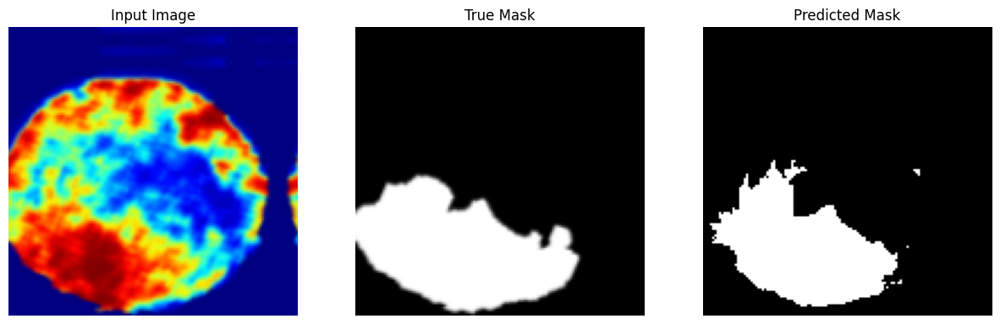


Sample Prediction after epoch 59

12/12 [==============================] - 3s 251ms/step - loss: 0.0962 - accuracy: 0.8929 - val_loss: 0.1651 - val_accuracy: 0.9396
Epoch 60/200
1/1 [==============================] - 0s 92ms/step


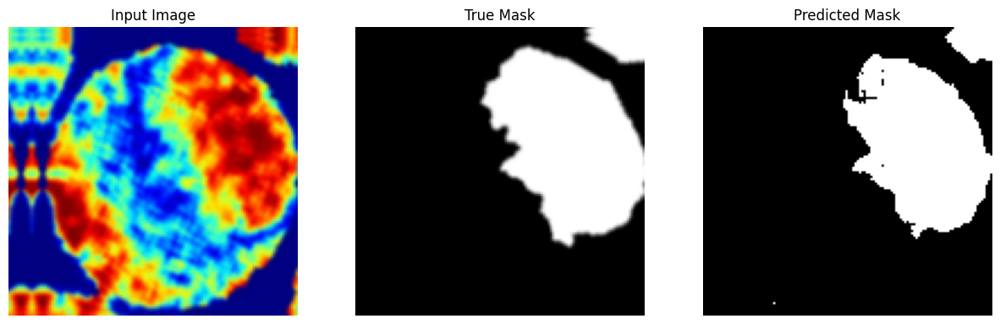


Sample Prediction after epoch 60

12/12 [==============================] - 3s 233ms/step - loss: 0.0854 - accuracy: 0.8884 - val_loss: 0.2375 - val_accuracy: 0.9229
Epoch 61/200
1/1 [==============================] - 0s 98ms/step


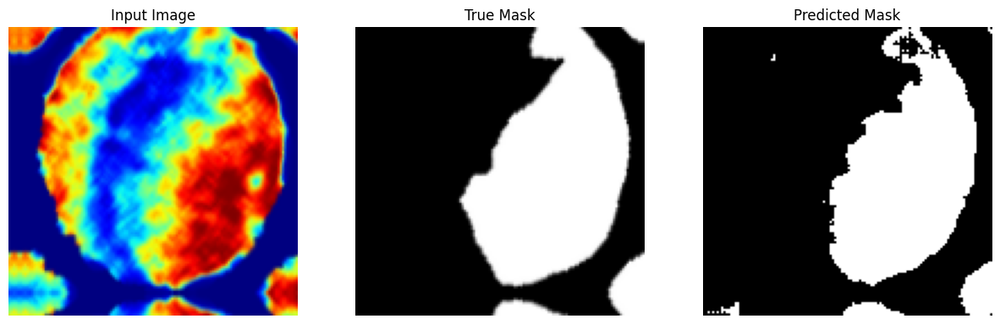


Sample Prediction after epoch 61

12/12 [==============================] - 3s 231ms/step - loss: 0.0937 - accuracy: 0.8889 - val_loss: 0.1304 - val_accuracy: 0.9519
Epoch 62/200
1/1 [==============================] - 0s 95ms/step


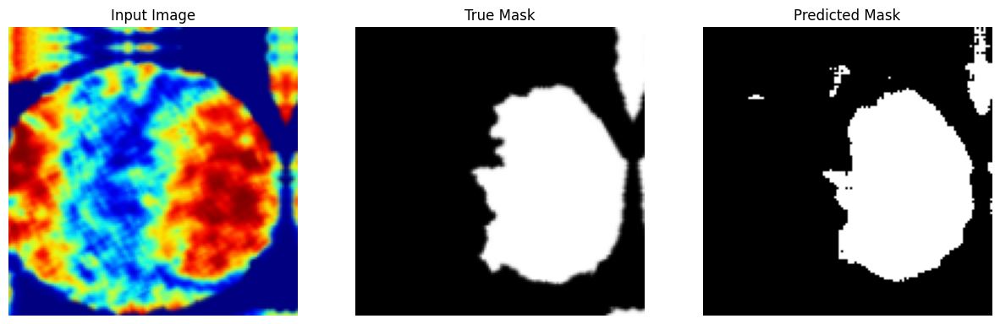


Sample Prediction after epoch 62

12/12 [==============================] - 3s 231ms/step - loss: 0.0879 - accuracy: 0.8922 - val_loss: 0.1188 - val_accuracy: 0.9530
Epoch 63/200
1/1 [==============================] - 0s 95ms/step


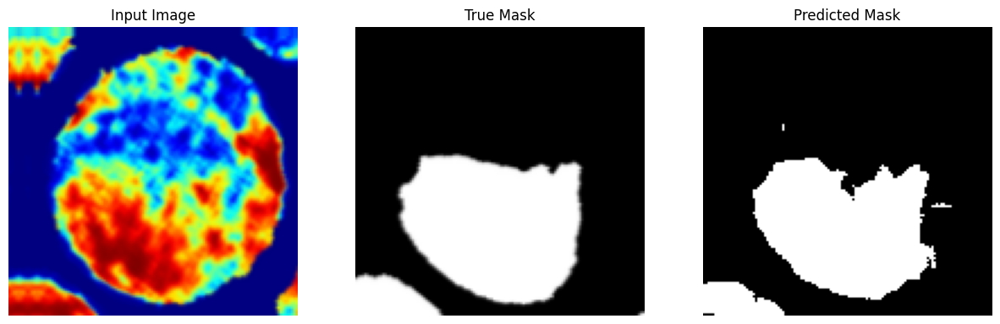


Sample Prediction after epoch 63

12/12 [==============================] - 3s 231ms/step - loss: 0.0895 - accuracy: 0.8948 - val_loss: 0.1816 - val_accuracy: 0.9361
Epoch 64/200
1/1 [==============================] - 0s 96ms/step


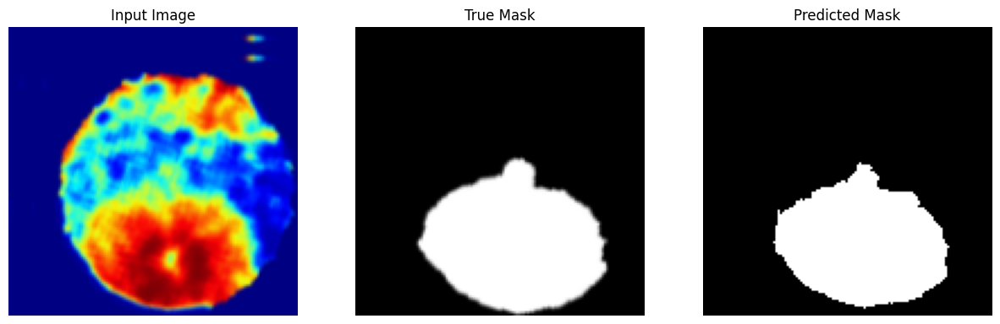


Sample Prediction after epoch 64

12/12 [==============================] - 3s 239ms/step - loss: 0.0850 - accuracy: 0.8923 - val_loss: 0.2546 - val_accuracy: 0.9196
Epoch 65/200
1/1 [==============================] - 0s 92ms/step


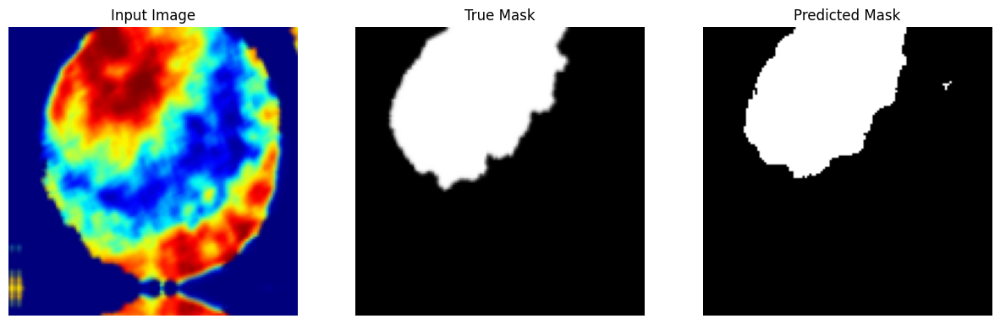


Sample Prediction after epoch 65

12/12 [==============================] - 3s 228ms/step - loss: 0.0823 - accuracy: 0.8945 - val_loss: 0.1981 - val_accuracy: 0.9339
Epoch 66/200
1/1 [==============================] - 0s 94ms/step


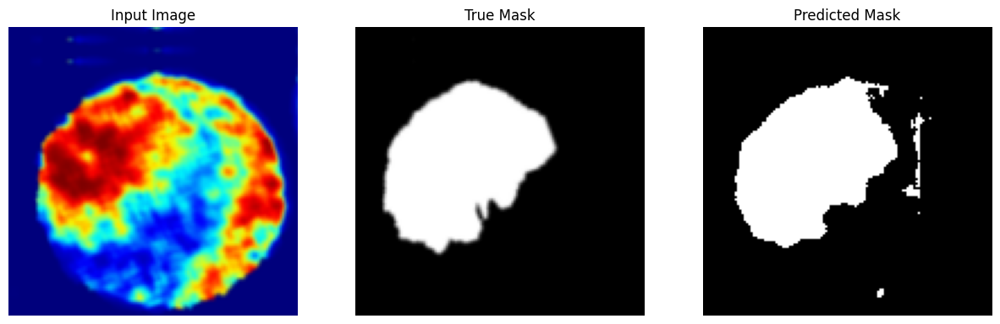


Sample Prediction after epoch 66

12/12 [==============================] - 3s 234ms/step - loss: 0.0865 - accuracy: 0.8905 - val_loss: 0.1414 - val_accuracy: 0.9474
Epoch 67/200
1/1 [==============================] - 0s 94ms/step


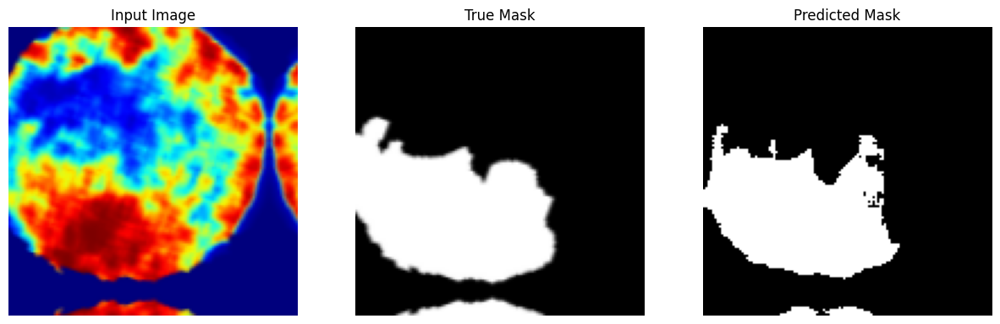


Sample Prediction after epoch 67

12/12 [==============================] - 3s 237ms/step - loss: 0.0750 - accuracy: 0.8941 - val_loss: 0.2054 - val_accuracy: 0.9303
Epoch 68/200
1/1 [==============================] - 0s 93ms/step


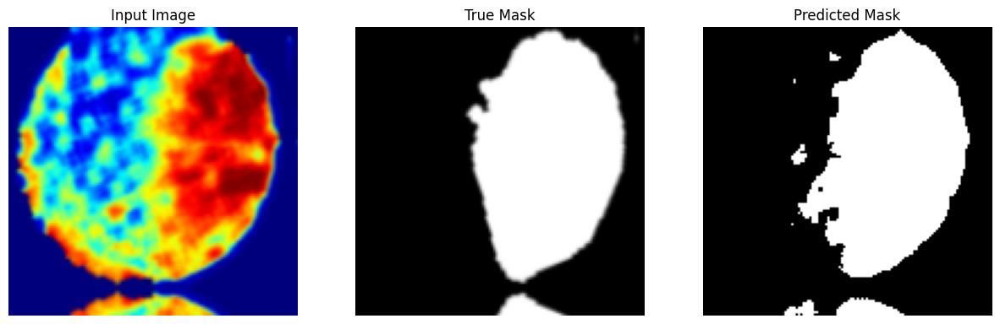


Sample Prediction after epoch 68

12/12 [==============================] - 3s 229ms/step - loss: 0.0808 - accuracy: 0.8911 - val_loss: 0.2125 - val_accuracy: 0.9307
Epoch 69/200
1/1 [==============================] - 0s 93ms/step


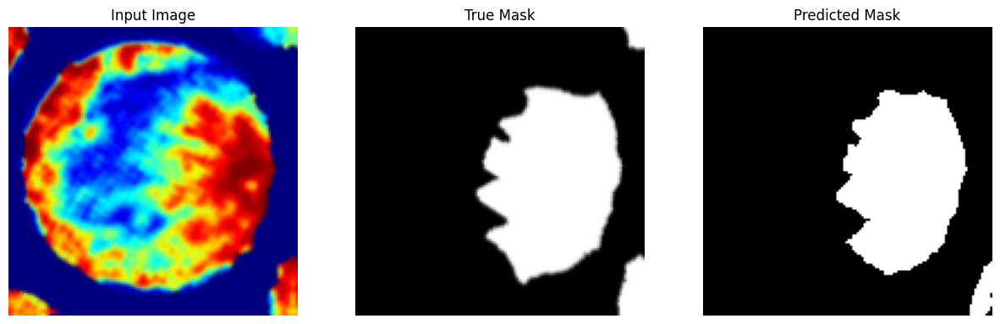


Sample Prediction after epoch 69

12/12 [==============================] - 3s 228ms/step - loss: 0.0881 - accuracy: 0.8889 - val_loss: 0.1859 - val_accuracy: 0.9361
Epoch 70/200
1/1 [==============================] - 0s 94ms/step


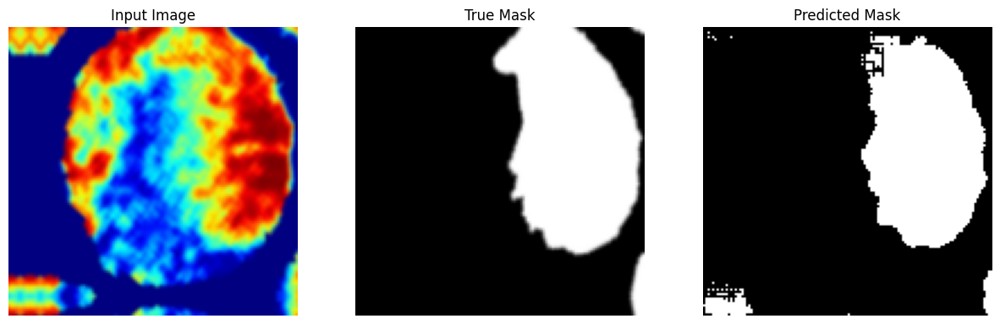


Sample Prediction after epoch 70

12/12 [==============================] - 3s 230ms/step - loss: 0.0923 - accuracy: 0.8853 - val_loss: 0.1658 - val_accuracy: 0.9414
Epoch 71/200
1/1 [==============================] - 0s 97ms/step


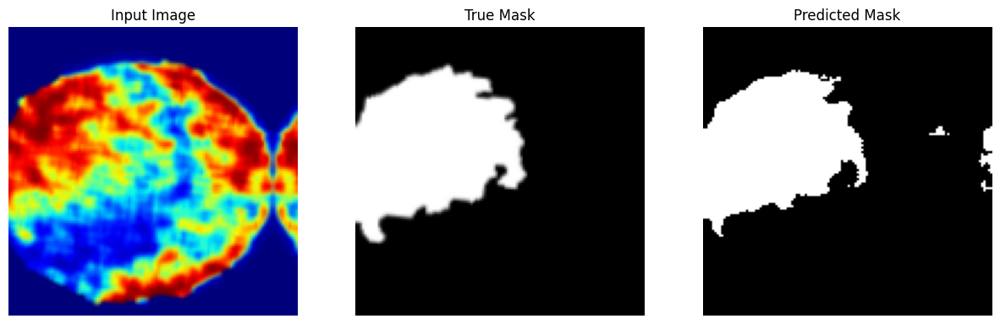


Sample Prediction after epoch 71

12/12 [==============================] - 3s 247ms/step - loss: 0.0824 - accuracy: 0.8950 - val_loss: 0.1510 - val_accuracy: 0.9471
Epoch 72/200
1/1 [==============================] - 0s 93ms/step


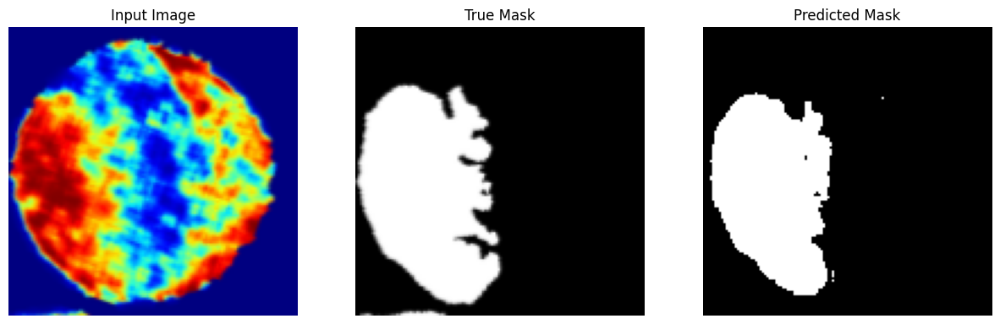


Sample Prediction after epoch 72

12/12 [==============================] - 3s 223ms/step - loss: 0.0872 - accuracy: 0.8869 - val_loss: 0.1761 - val_accuracy: 0.9389
Epoch 73/200
1/1 [==============================] - 0s 90ms/step


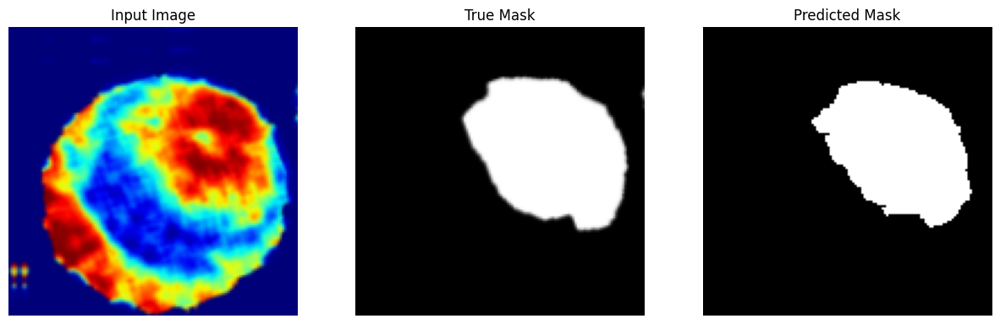


Sample Prediction after epoch 73

12/12 [==============================] - 3s 224ms/step - loss: 0.0849 - accuracy: 0.8915 - val_loss: 0.1971 - val_accuracy: 0.9303
Epoch 74/200
1/1 [==============================] - 0s 91ms/step


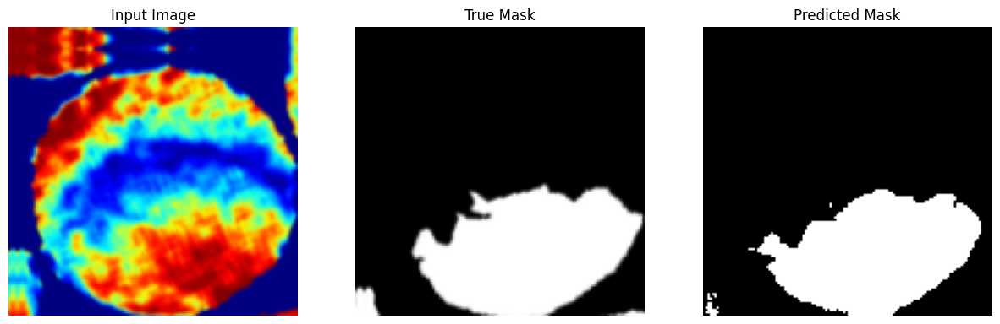


Sample Prediction after epoch 74

12/12 [==============================] - 3s 225ms/step - loss: 0.0800 - accuracy: 0.8936 - val_loss: 0.1499 - val_accuracy: 0.9437
Epoch 75/200
1/1 [==============================] - 0s 92ms/step


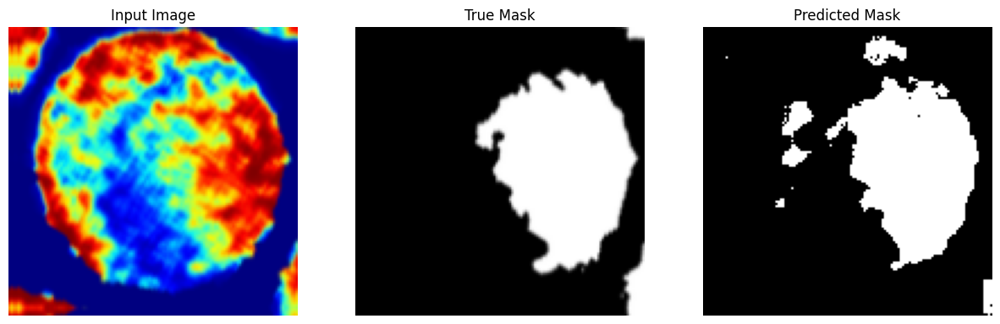


Sample Prediction after epoch 75

12/12 [==============================] - 3s 227ms/step - loss: 0.0826 - accuracy: 0.8953 - val_loss: 0.1772 - val_accuracy: 0.9346
Epoch 76/200
1/1 [==============================] - 0s 94ms/step


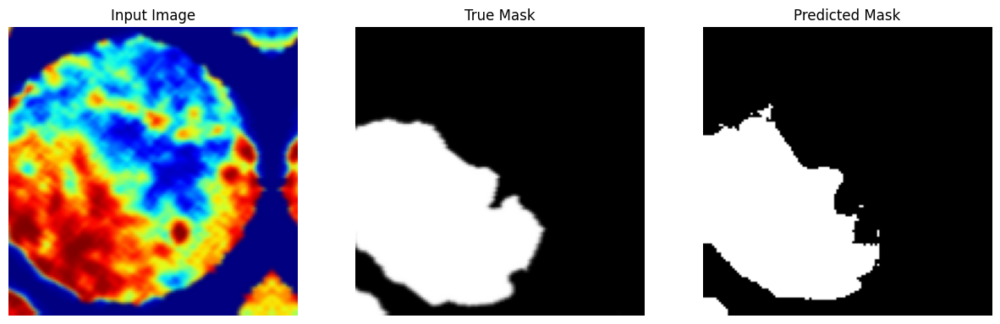


Sample Prediction after epoch 76

12/12 [==============================] - 3s 245ms/step - loss: 0.0764 - accuracy: 0.8944 - val_loss: 0.1711 - val_accuracy: 0.9376
Epoch 77/200
1/1 [==============================] - 0s 96ms/step


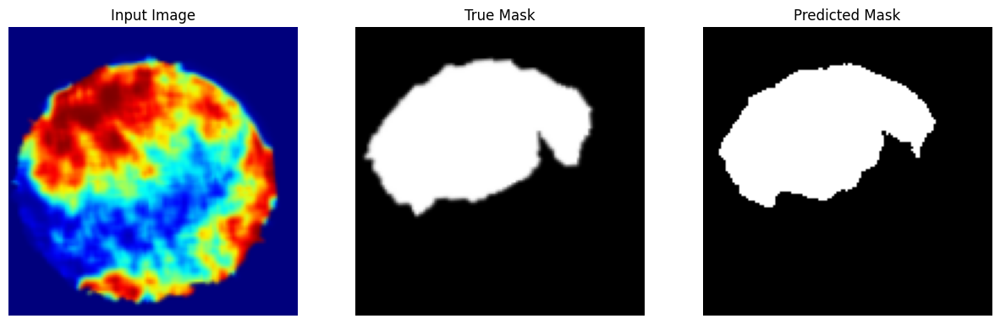


Sample Prediction after epoch 77

12/12 [==============================] - 3s 236ms/step - loss: 0.0778 - accuracy: 0.8897 - val_loss: 0.2049 - val_accuracy: 0.9314
Epoch 78/200
1/1 [==============================] - 0s 92ms/step


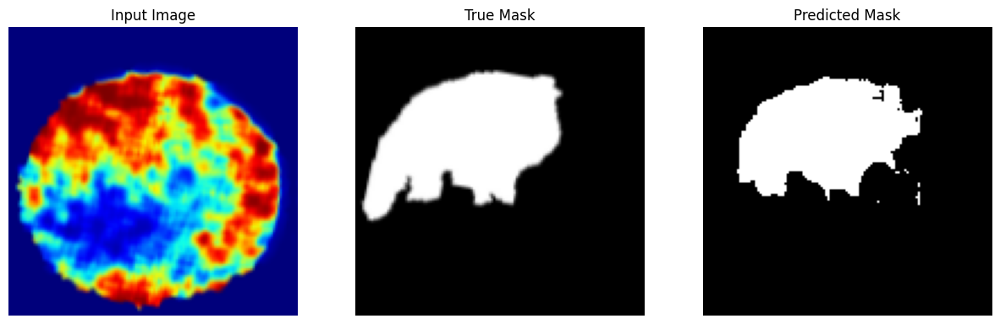


Sample Prediction after epoch 78

12/12 [==============================] - 3s 229ms/step - loss: 0.0798 - accuracy: 0.8945 - val_loss: 0.1560 - val_accuracy: 0.9430
Epoch 79/200
1/1 [==============================] - 0s 93ms/step


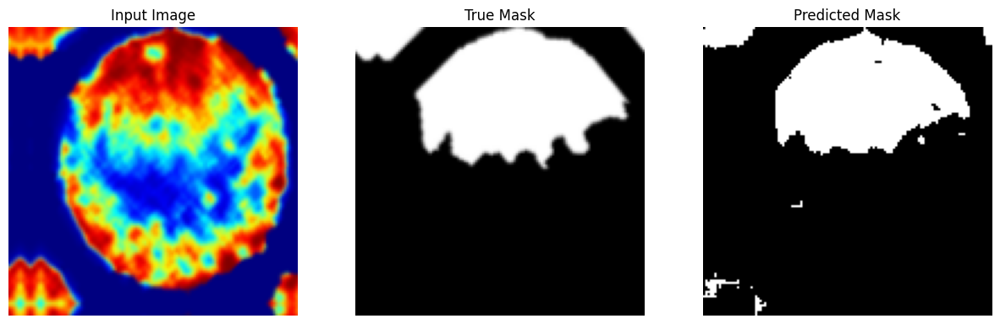


Sample Prediction after epoch 79

12/12 [==============================] - 3s 234ms/step - loss: 0.0747 - accuracy: 0.8939 - val_loss: 0.1846 - val_accuracy: 0.9379
Epoch 80/200
1/1 [==============================] - 0s 92ms/step


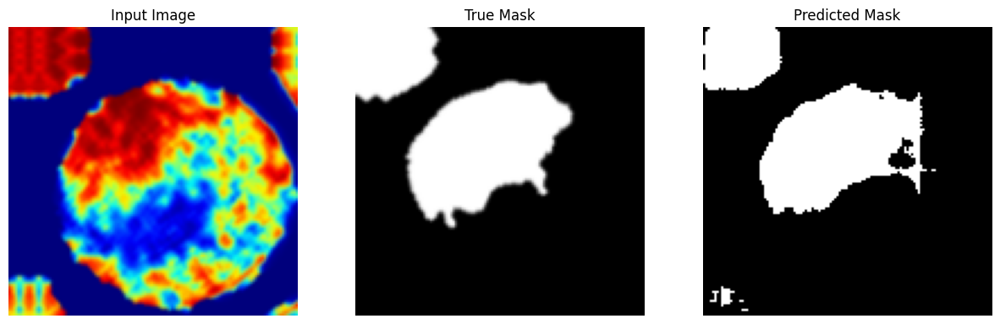


Sample Prediction after epoch 80

12/12 [==============================] - 3s 234ms/step - loss: 0.0863 - accuracy: 0.8897 - val_loss: 0.2216 - val_accuracy: 0.9279
Epoch 81/200
1/1 [==============================] - 0s 97ms/step


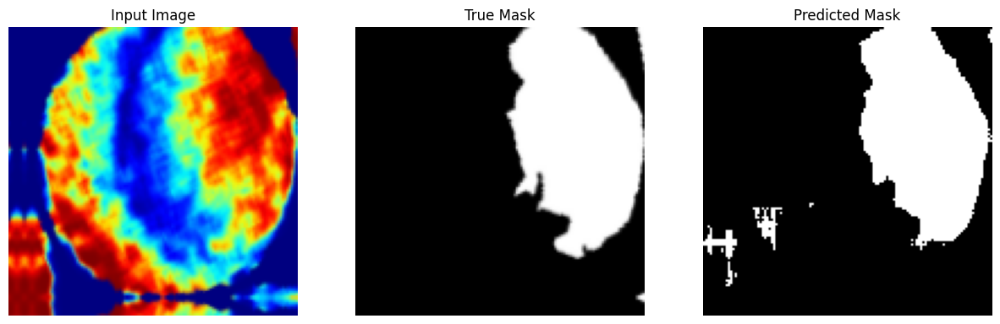


Sample Prediction after epoch 81

12/12 [==============================] - 3s 229ms/step - loss: 0.0794 - accuracy: 0.8957 - val_loss: 0.1841 - val_accuracy: 0.9341
Epoch 82/200
1/1 [==============================] - 0s 95ms/step


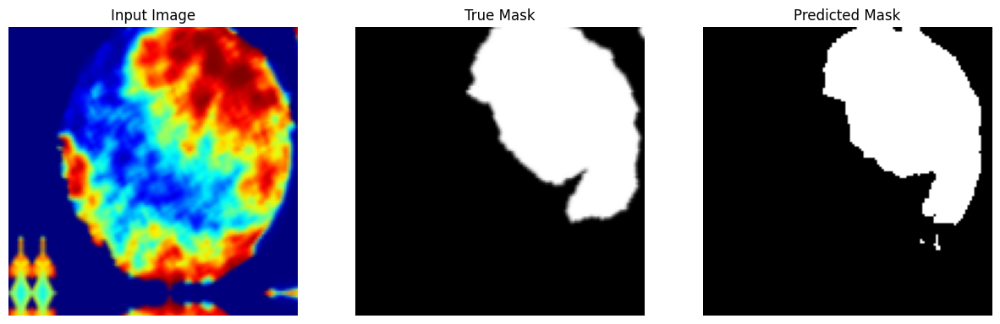


Sample Prediction after epoch 82

12/12 [==============================] - 3s 228ms/step - loss: 0.0738 - accuracy: 0.9002 - val_loss: 0.1570 - val_accuracy: 0.9435
Epoch 83/200
1/1 [==============================] - 0s 94ms/step


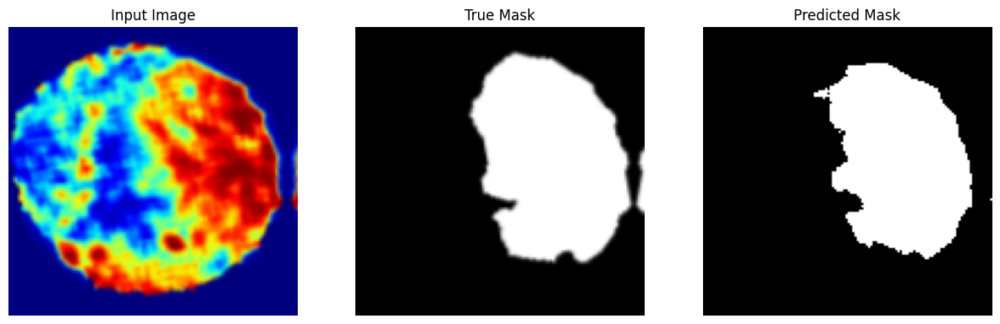


Sample Prediction after epoch 83

12/12 [==============================] - 3s 248ms/step - loss: 0.0852 - accuracy: 0.8920 - val_loss: 0.1862 - val_accuracy: 0.9341
Epoch 84/200
1/1 [==============================] - 0s 97ms/step


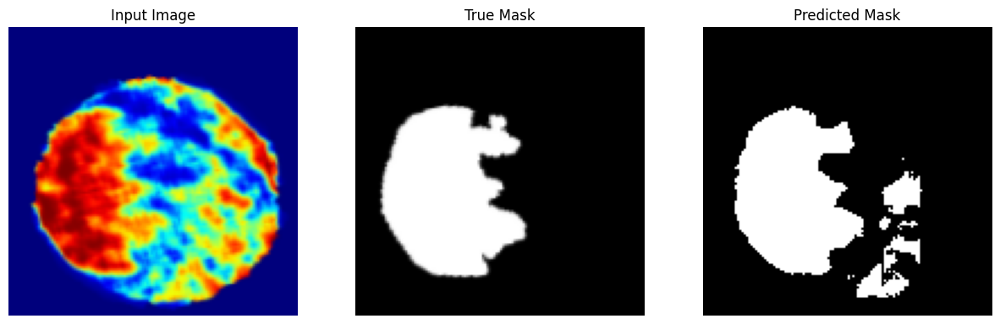


Sample Prediction after epoch 84

12/12 [==============================] - 3s 233ms/step - loss: 0.0922 - accuracy: 0.8885 - val_loss: 0.1193 - val_accuracy: 0.9544
Epoch 85/200
1/1 [==============================] - 0s 106ms/step


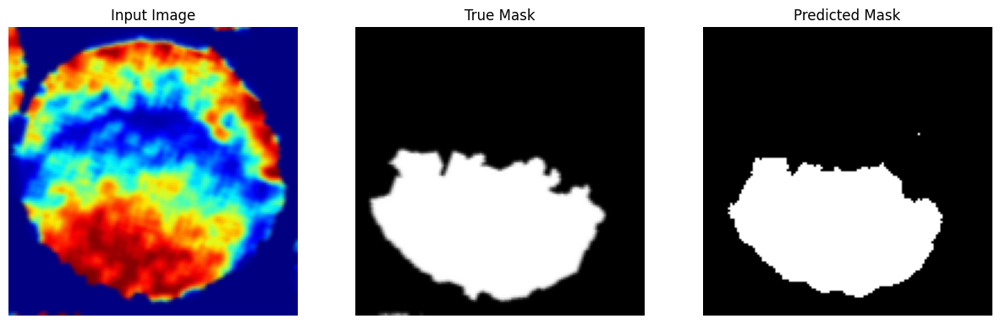


Sample Prediction after epoch 85

12/12 [==============================] - 3s 233ms/step - loss: 0.0780 - accuracy: 0.8953 - val_loss: 0.1437 - val_accuracy: 0.9455
Epoch 86/200
1/1 [==============================] - 0s 94ms/step


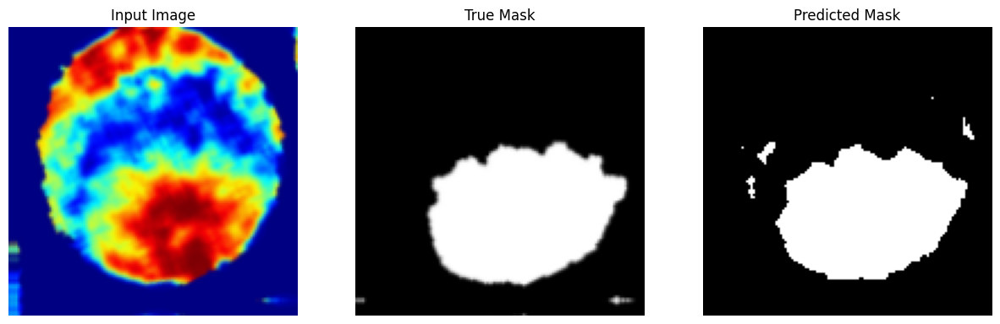


Sample Prediction after epoch 86

12/12 [==============================] - 3s 231ms/step - loss: 0.0824 - accuracy: 0.8896 - val_loss: 0.1552 - val_accuracy: 0.9424
Epoch 87/200
1/1 [==============================] - 0s 121ms/step


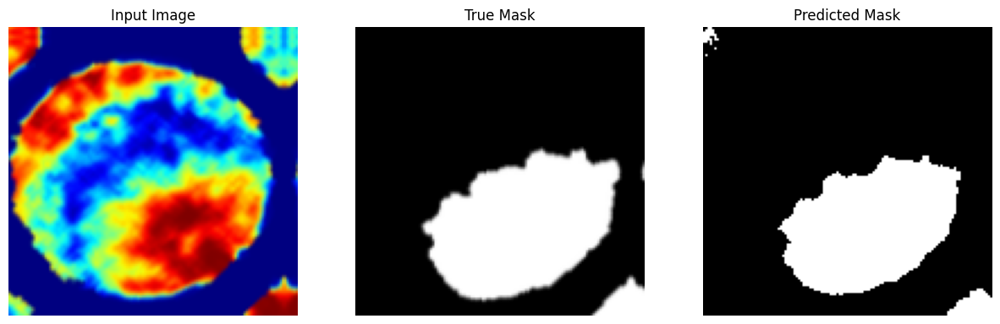


Sample Prediction after epoch 87

12/12 [==============================] - 3s 246ms/step - loss: 0.0768 - accuracy: 0.8948 - val_loss: 0.2412 - val_accuracy: 0.9212
Epoch 88/200
1/1 [==============================] - 0s 107ms/step


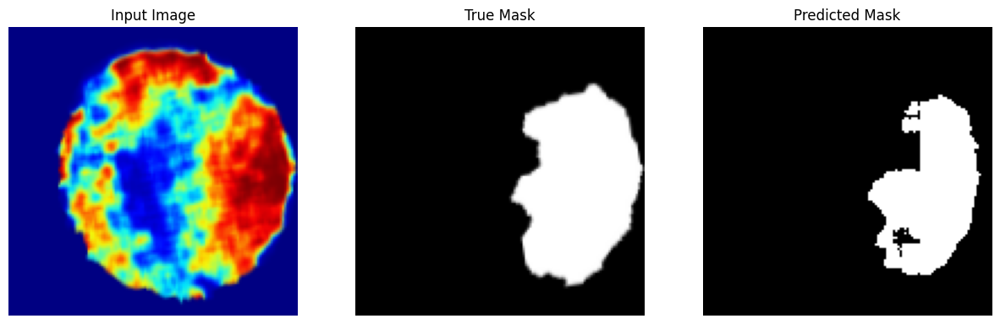


Sample Prediction after epoch 88

12/12 [==============================] - 3s 233ms/step - loss: 0.0833 - accuracy: 0.8891 - val_loss: 0.1799 - val_accuracy: 0.9335
Epoch 89/200
1/1 [==============================] - 0s 101ms/step


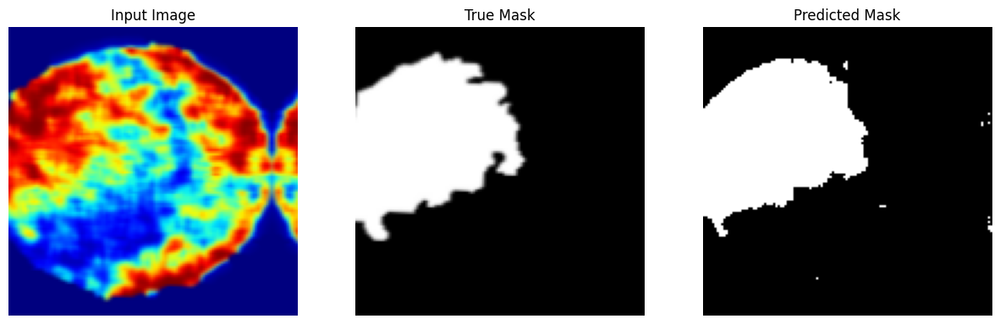


Sample Prediction after epoch 89

12/12 [==============================] - 3s 236ms/step - loss: 0.0786 - accuracy: 0.8903 - val_loss: 0.1307 - val_accuracy: 0.9493
Epoch 90/200
1/1 [==============================] - 0s 98ms/step


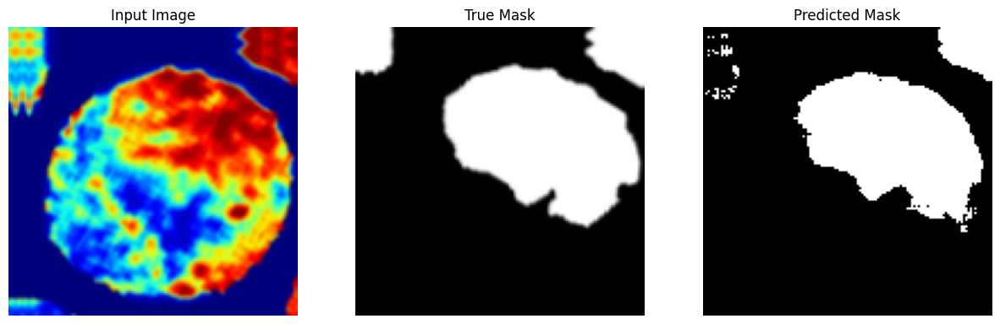


Sample Prediction after epoch 90

12/12 [==============================] - 3s 236ms/step - loss: 0.0806 - accuracy: 0.8946 - val_loss: 0.1565 - val_accuracy: 0.9431
Epoch 91/200
1/1 [==============================] - 0s 109ms/step


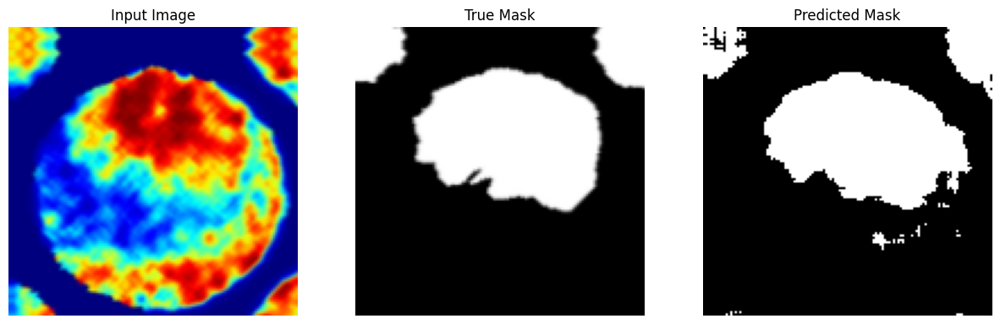


Sample Prediction after epoch 91

12/12 [==============================] - 3s 257ms/step - loss: 0.0859 - accuracy: 0.8907 - val_loss: 0.1274 - val_accuracy: 0.9539
Epoch 92/200
1/1 [==============================] - 0s 97ms/step


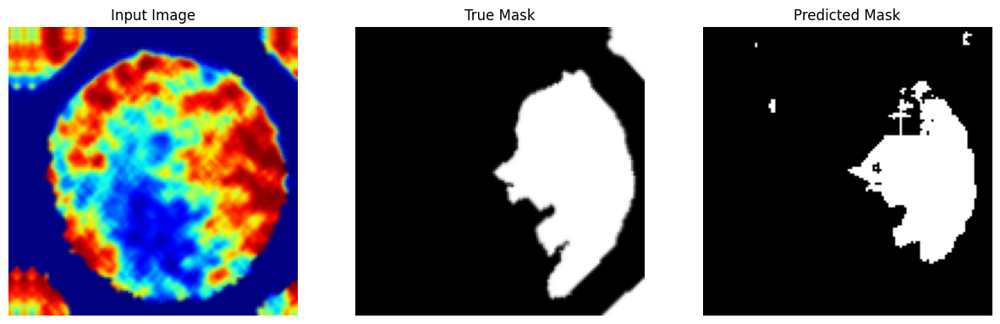


Sample Prediction after epoch 92

12/12 [==============================] - 3s 283ms/step - loss: 0.0778 - accuracy: 0.8975 - val_loss: 0.2437 - val_accuracy: 0.9275
Epoch 93/200
1/1 [==============================] - 0s 96ms/step


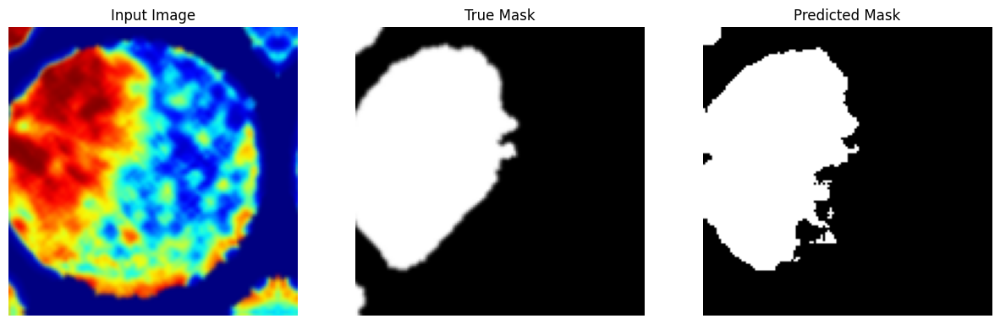


Sample Prediction after epoch 93

12/12 [==============================] - 3s 281ms/step - loss: 0.0798 - accuracy: 0.8930 - val_loss: 0.1332 - val_accuracy: 0.9529
Epoch 94/200
1/1 [==============================] - 0s 101ms/step


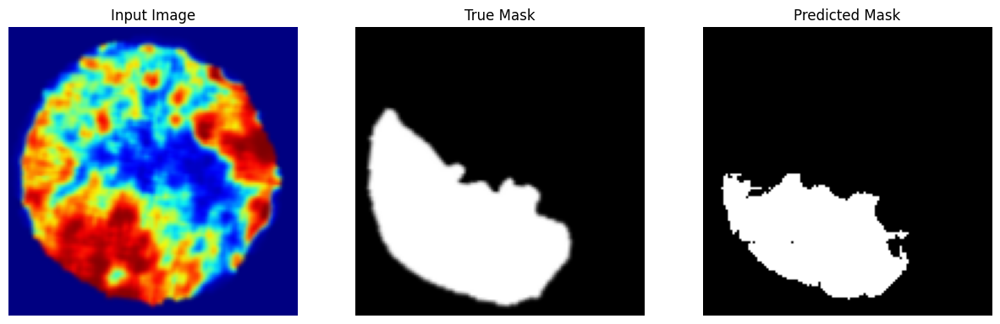


Sample Prediction after epoch 94

12/12 [==============================] - 3s 245ms/step - loss: 0.0798 - accuracy: 0.8989 - val_loss: 0.2486 - val_accuracy: 0.9211
Epoch 95/200
1/1 [==============================] - 0s 119ms/step


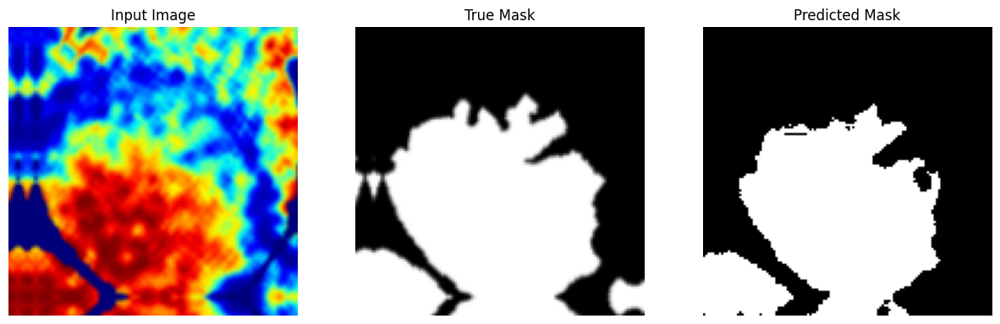


Sample Prediction after epoch 95

12/12 [==============================] - 4s 329ms/step - loss: 0.0683 - accuracy: 0.8979 - val_loss: 0.1773 - val_accuracy: 0.9353
Epoch 96/200
1/1 [==============================] - 0s 114ms/step


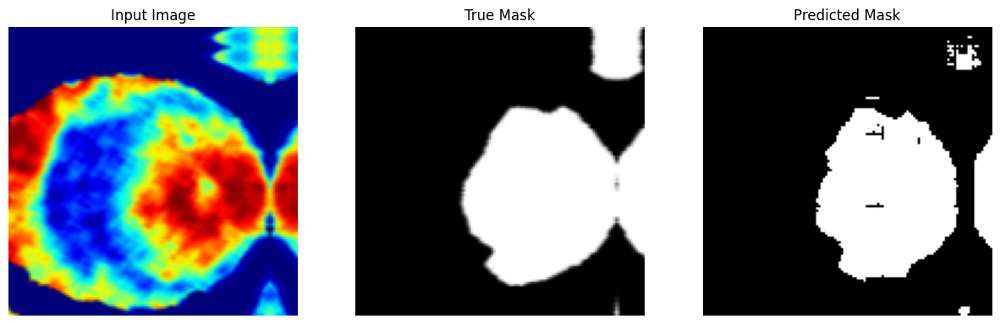


Sample Prediction after epoch 96

12/12 [==============================] - 4s 310ms/step - loss: 0.0751 - accuracy: 0.8975 - val_loss: 0.1943 - val_accuracy: 0.9295
Epoch 97/200
1/1 [==============================] - 0s 126ms/step


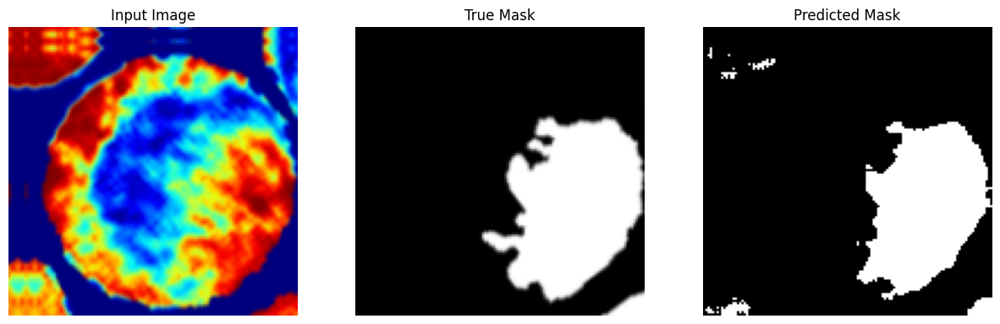


Sample Prediction after epoch 97

12/12 [==============================] - 3s 281ms/step - loss: 0.0740 - accuracy: 0.8924 - val_loss: 0.1411 - val_accuracy: 0.9446
Epoch 98/200
1/1 [==============================] - 0s 112ms/step


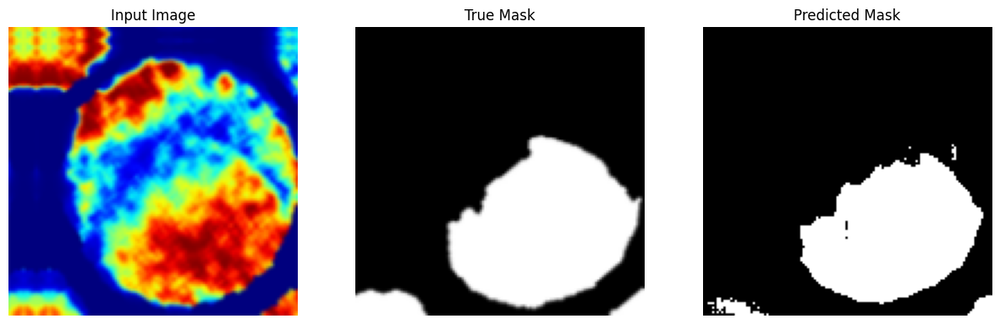


Sample Prediction after epoch 98

12/12 [==============================] - 3s 277ms/step - loss: 0.0694 - accuracy: 0.8998 - val_loss: 0.1774 - val_accuracy: 0.9370
Epoch 99/200
1/1 [==============================] - 0s 96ms/step


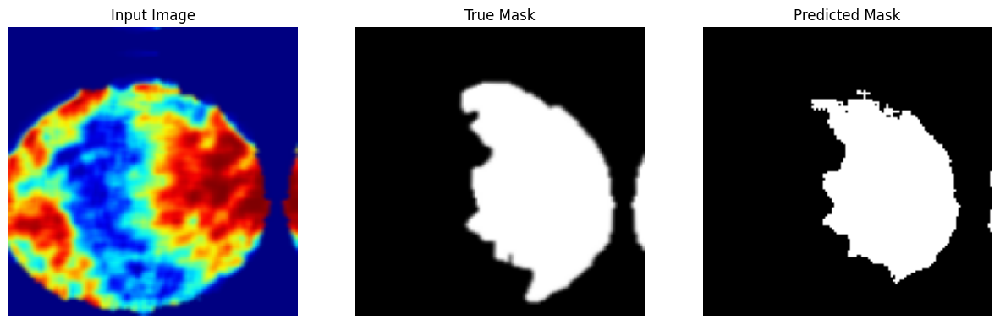


Sample Prediction after epoch 99

12/12 [==============================] - 3s 257ms/step - loss: 0.0836 - accuracy: 0.8932 - val_loss: 0.1532 - val_accuracy: 0.9435
Epoch 100/200
1/1 [==============================] - 0s 101ms/step


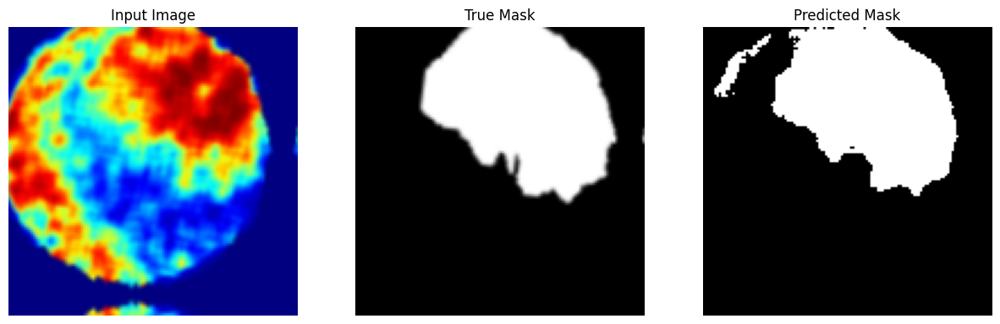


Sample Prediction after epoch 100

12/12 [==============================] - 3s 234ms/step - loss: 0.0768 - accuracy: 0.8927 - val_loss: 0.1906 - val_accuracy: 0.9296
Epoch 101/200
1/1 [==============================] - 0s 89ms/step


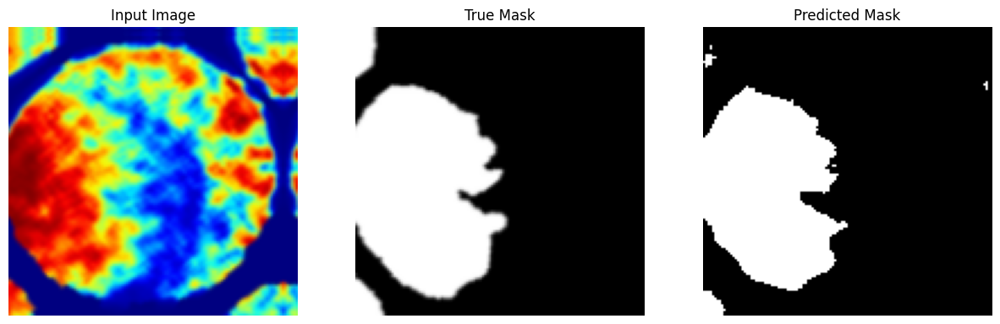


Sample Prediction after epoch 101

12/12 [==============================] - 3s 243ms/step - loss: 0.0702 - accuracy: 0.9005 - val_loss: 0.1729 - val_accuracy: 0.9365
Epoch 102/200
1/1 [==============================] - 0s 94ms/step


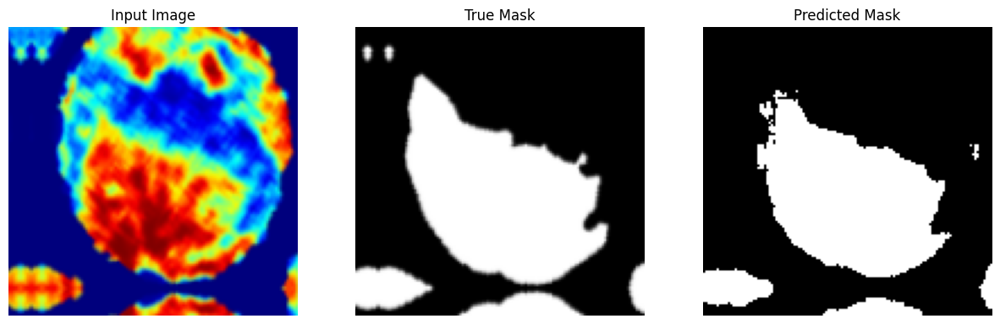


Sample Prediction after epoch 102

12/12 [==============================] - 3s 252ms/step - loss: 0.0681 - accuracy: 0.8960 - val_loss: 0.1167 - val_accuracy: 0.9531
Epoch 103/200
1/1 [==============================] - 0s 133ms/step


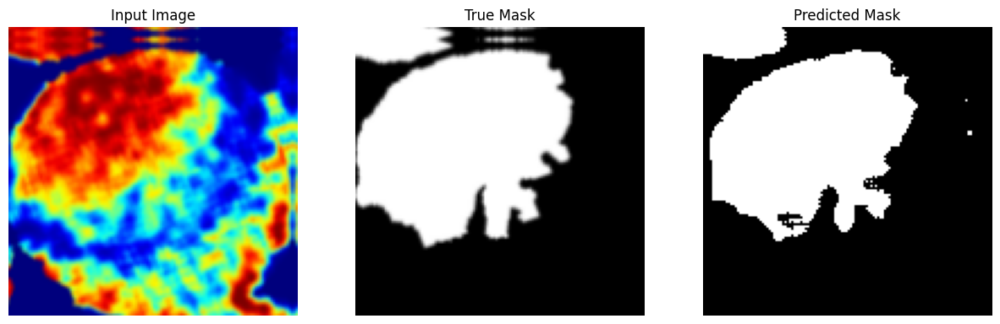


Sample Prediction after epoch 103

12/12 [==============================] - 3s 261ms/step - loss: 0.0716 - accuracy: 0.8979 - val_loss: 0.1348 - val_accuracy: 0.9504
Epoch 104/200
1/1 [==============================] - 0s 98ms/step


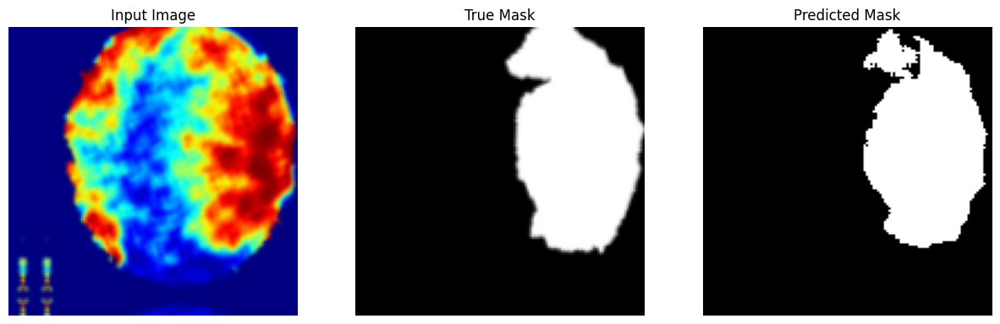


Sample Prediction after epoch 104

12/12 [==============================] - 3s 270ms/step - loss: 0.0678 - accuracy: 0.9029 - val_loss: 0.2134 - val_accuracy: 0.9286
Epoch 105/200
1/1 [==============================] - 0s 111ms/step


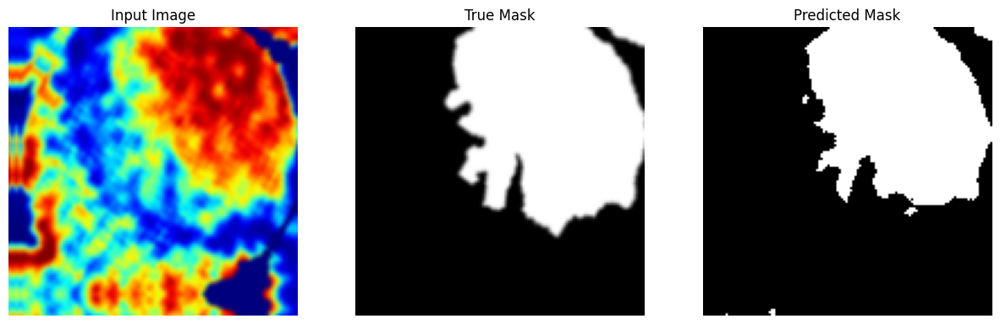


Sample Prediction after epoch 105

12/12 [==============================] - 3s 255ms/step - loss: 0.0781 - accuracy: 0.8945 - val_loss: 0.1750 - val_accuracy: 0.9390
Epoch 106/200
1/1 [==============================] - 0s 94ms/step


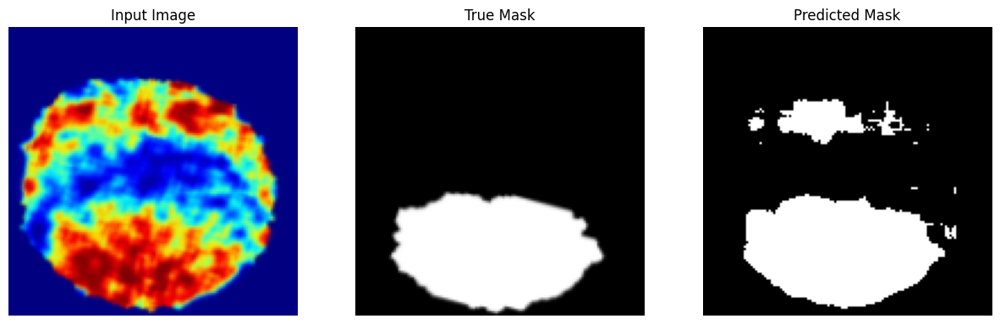


Sample Prediction after epoch 106

12/12 [==============================] - 3s 234ms/step - loss: 0.0739 - accuracy: 0.8995 - val_loss: 0.1608 - val_accuracy: 0.9385
Epoch 107/200
1/1 [==============================] - 0s 93ms/step


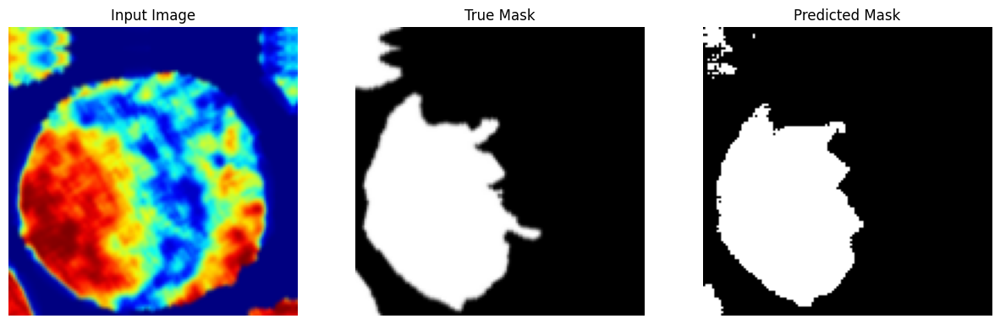


Sample Prediction after epoch 107

12/12 [==============================] - 3s 227ms/step - loss: 0.0766 - accuracy: 0.8979 - val_loss: 0.1398 - val_accuracy: 0.9479
Epoch 108/200
1/1 [==============================] - 0s 93ms/step


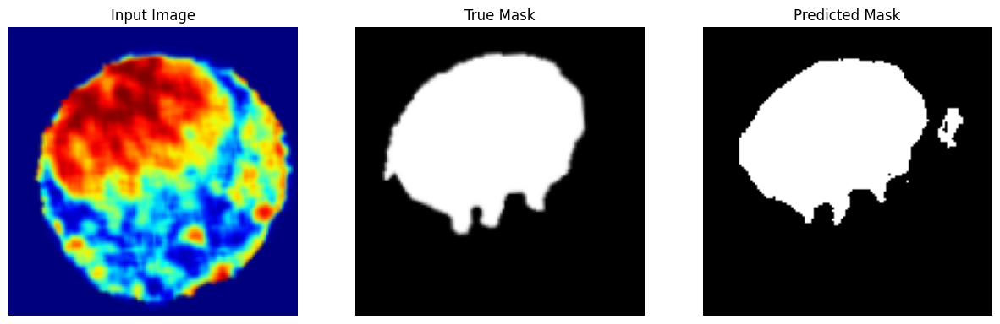


Sample Prediction after epoch 108

12/12 [==============================] - 3s 232ms/step - loss: 0.0767 - accuracy: 0.8929 - val_loss: 0.1322 - val_accuracy: 0.9528
Epoch 109/200
1/1 [==============================] - 0s 116ms/step


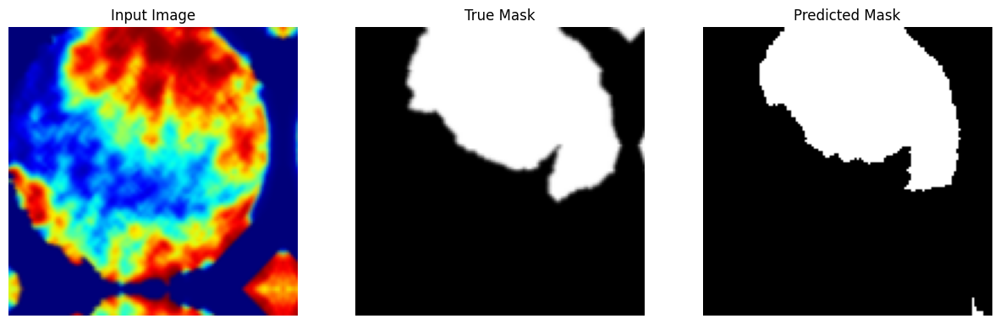


Sample Prediction after epoch 109

12/12 [==============================] - 3s 228ms/step - loss: 0.0696 - accuracy: 0.8946 - val_loss: 0.1687 - val_accuracy: 0.9403
Epoch 110/200
1/1 [==============================] - 0s 94ms/step


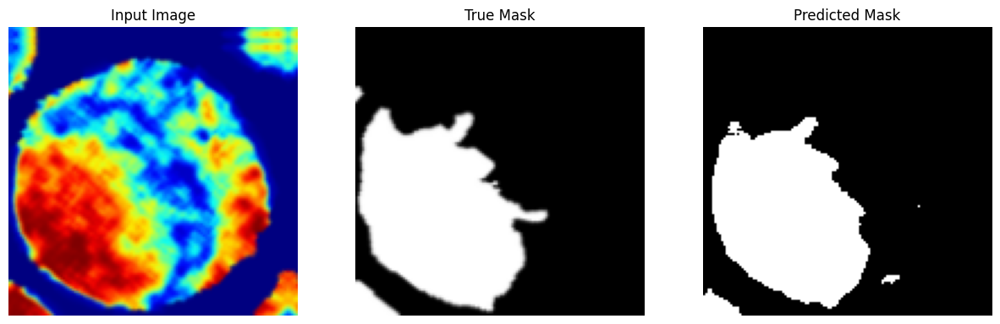


Sample Prediction after epoch 110

12/12 [==============================] - 3s 259ms/step - loss: 0.0708 - accuracy: 0.8986 - val_loss: 0.1363 - val_accuracy: 0.9503
Epoch 111/200
1/1 [==============================] - 0s 100ms/step


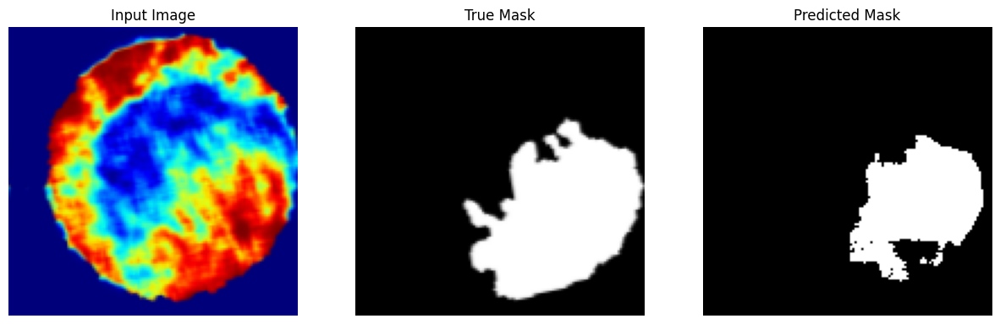


Sample Prediction after epoch 111

12/12 [==============================] - 3s 245ms/step - loss: 0.0765 - accuracy: 0.8961 - val_loss: 0.1658 - val_accuracy: 0.9405
Epoch 112/200
1/1 [==============================] - 0s 121ms/step


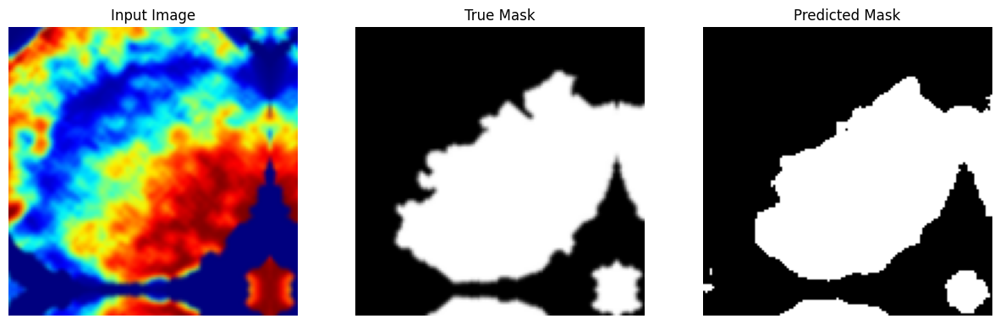


Sample Prediction after epoch 112

12/12 [==============================] - 3s 257ms/step - loss: 0.0707 - accuracy: 0.8979 - val_loss: 0.1297 - val_accuracy: 0.9501
Epoch 113/200
1/1 [==============================] - 0s 97ms/step


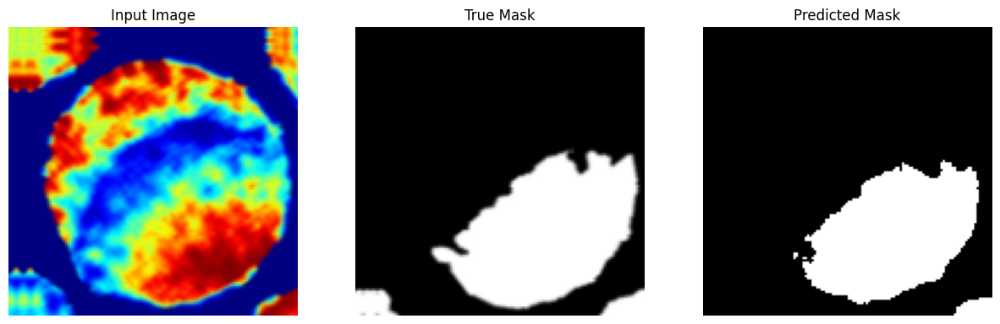


Sample Prediction after epoch 113

12/12 [==============================] - 3s 238ms/step - loss: 0.0754 - accuracy: 0.8971 - val_loss: 0.2216 - val_accuracy: 0.9247
Epoch 114/200
1/1 [==============================] - 0s 122ms/step


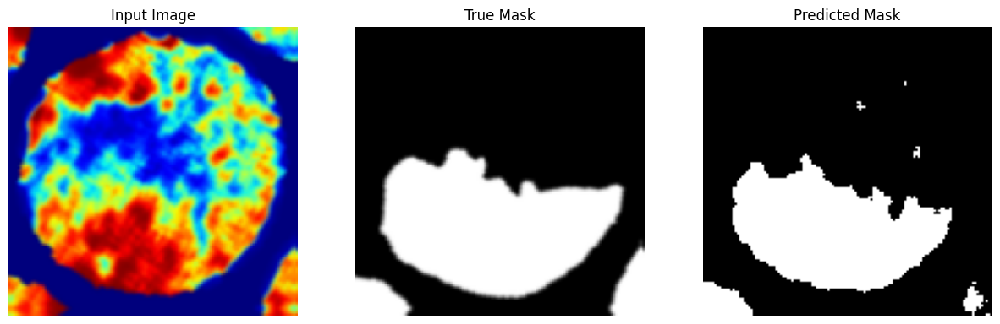


Sample Prediction after epoch 114

12/12 [==============================] - 3s 246ms/step - loss: 0.0668 - accuracy: 0.9018 - val_loss: 0.1664 - val_accuracy: 0.9410
Epoch 115/200
1/1 [==============================] - 0s 107ms/step


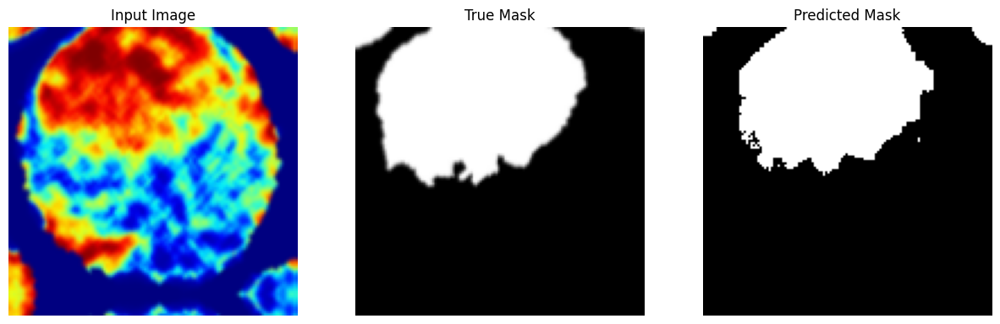


Sample Prediction after epoch 115

12/12 [==============================] - 3s 244ms/step - loss: 0.0768 - accuracy: 0.8962 - val_loss: 0.2101 - val_accuracy: 0.9341
Epoch 116/200
1/1 [==============================] - 0s 90ms/step


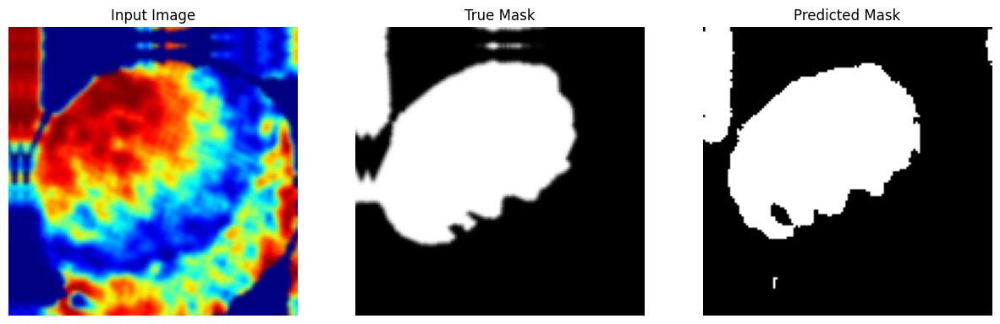


Sample Prediction after epoch 116

12/12 [==============================] - 3s 237ms/step - loss: 0.0675 - accuracy: 0.9039 - val_loss: 0.1478 - val_accuracy: 0.9453
Epoch 117/200
1/1 [==============================] - 0s 133ms/step


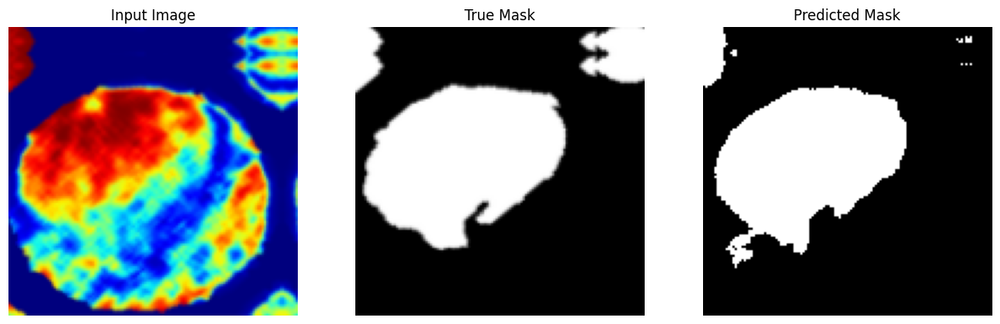


Sample Prediction after epoch 117

12/12 [==============================] - 3s 268ms/step - loss: 0.0673 - accuracy: 0.8982 - val_loss: 0.1202 - val_accuracy: 0.9510
Epoch 118/200
1/1 [==============================] - 0s 98ms/step


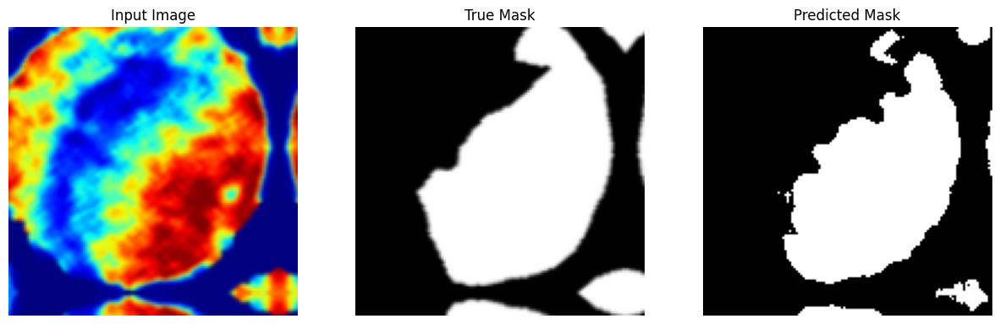


Sample Prediction after epoch 118

12/12 [==============================] - 3s 256ms/step - loss: 0.0682 - accuracy: 0.8990 - val_loss: 0.2251 - val_accuracy: 0.9285
Epoch 119/200
1/1 [==============================] - 0s 137ms/step


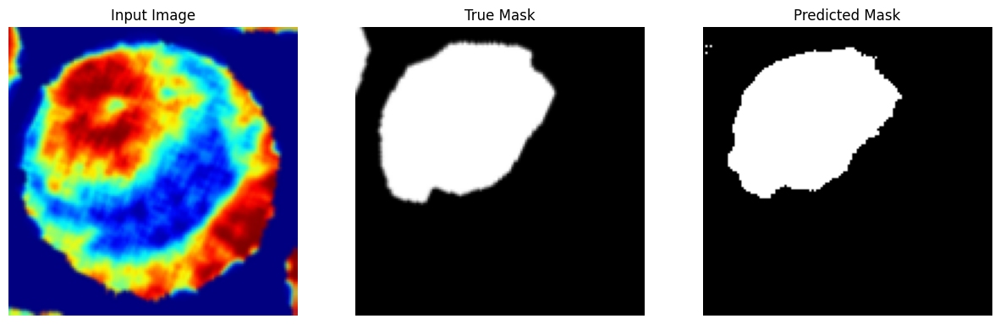


Sample Prediction after epoch 119

12/12 [==============================] - 3s 270ms/step - loss: 0.0731 - accuracy: 0.8968 - val_loss: 0.1651 - val_accuracy: 0.9409
Epoch 120/200
1/1 [==============================] - 0s 113ms/step


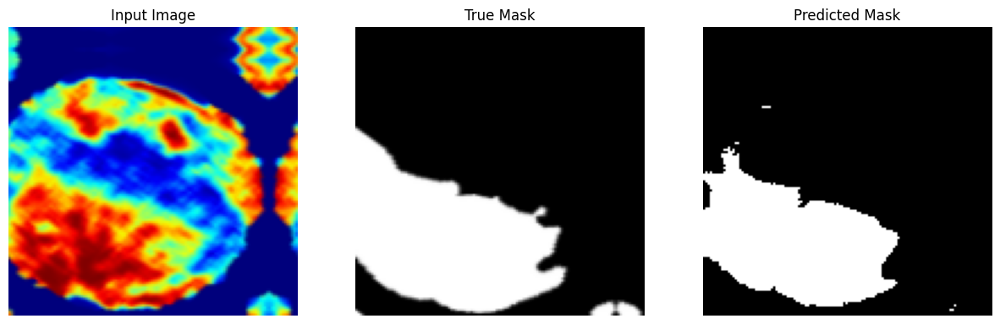


Sample Prediction after epoch 120

12/12 [==============================] - 3s 238ms/step - loss: 0.0770 - accuracy: 0.8922 - val_loss: 0.2099 - val_accuracy: 0.9289
Epoch 121/200
1/1 [==============================] - 0s 104ms/step


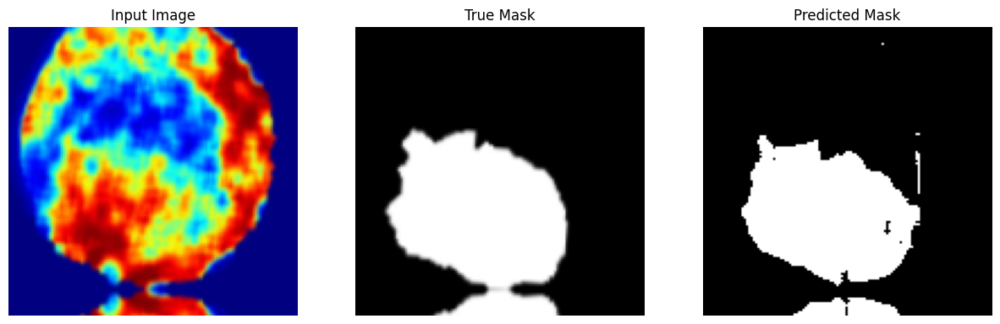


Sample Prediction after epoch 121

12/12 [==============================] - 3s 239ms/step - loss: 0.0817 - accuracy: 0.8945 - val_loss: 0.1891 - val_accuracy: 0.9321
Epoch 122/200
1/1 [==============================] - 0s 110ms/step


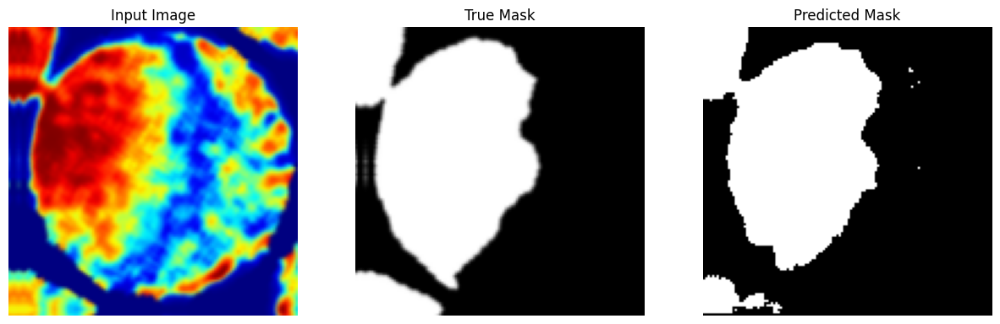


Sample Prediction after epoch 122

12/12 [==============================] - 3s 242ms/step - loss: 0.0753 - accuracy: 0.8964 - val_loss: 0.1383 - val_accuracy: 0.9458
Epoch 123/200
1/1 [==============================] - 0s 151ms/step


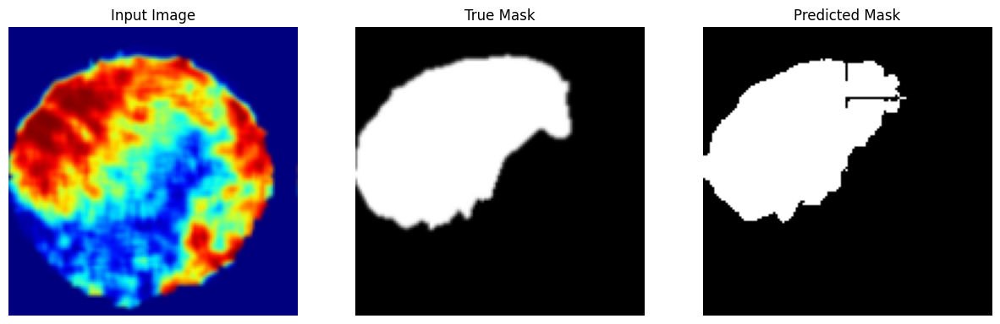


Sample Prediction after epoch 123

12/12 [==============================] - 3s 275ms/step - loss: 0.0665 - accuracy: 0.9015 - val_loss: 0.1974 - val_accuracy: 0.9300
Epoch 124/200
1/1 [==============================] - 0s 110ms/step


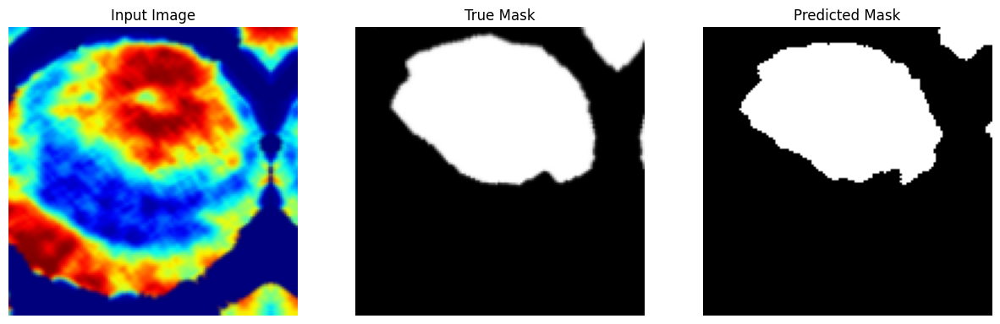


Sample Prediction after epoch 124

12/12 [==============================] - 3s 244ms/step - loss: 0.0805 - accuracy: 0.8939 - val_loss: 0.1419 - val_accuracy: 0.9441
Epoch 125/200
1/1 [==============================] - 0s 105ms/step


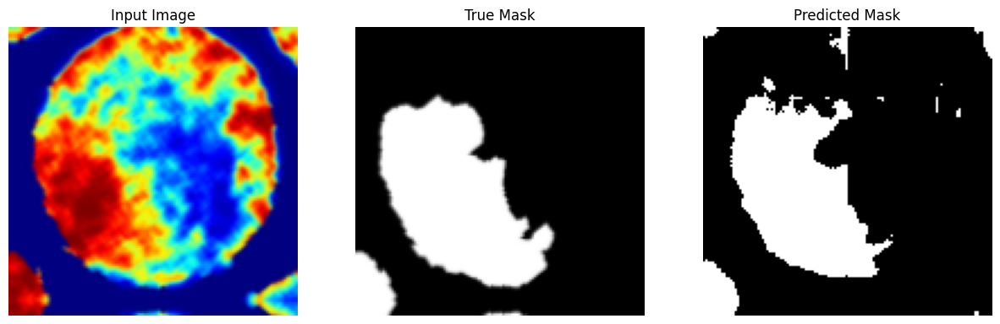


Sample Prediction after epoch 125

12/12 [==============================] - 3s 237ms/step - loss: 0.0690 - accuracy: 0.9004 - val_loss: 0.1461 - val_accuracy: 0.9444
Epoch 126/200
1/1 [==============================] - 0s 100ms/step


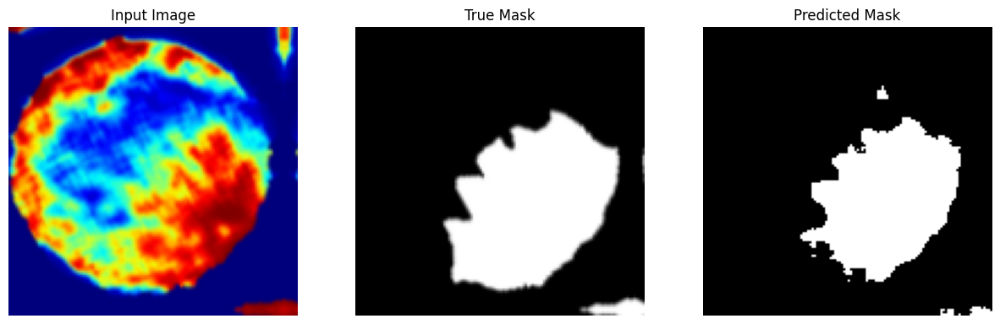


Sample Prediction after epoch 126

12/12 [==============================] - 3s 242ms/step - loss: 0.0650 - accuracy: 0.8987 - val_loss: 0.1439 - val_accuracy: 0.9454
Epoch 127/200
1/1 [==============================] - 0s 128ms/step


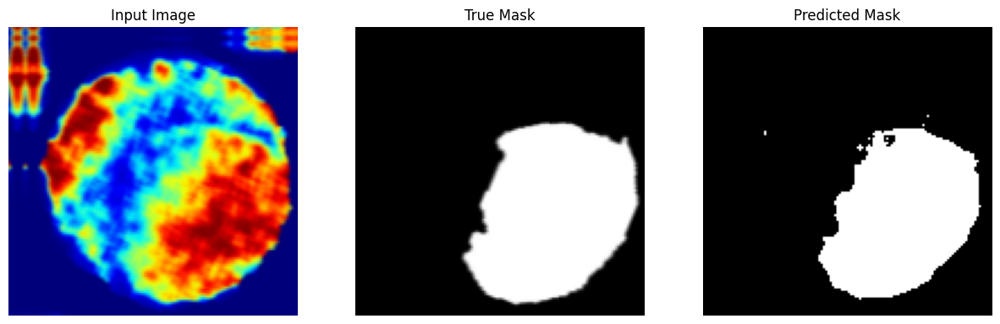


Sample Prediction after epoch 127

12/12 [==============================] - 3s 264ms/step - loss: 0.0694 - accuracy: 0.8995 - val_loss: 0.1662 - val_accuracy: 0.9379
Epoch 128/200
1/1 [==============================] - 0s 117ms/step


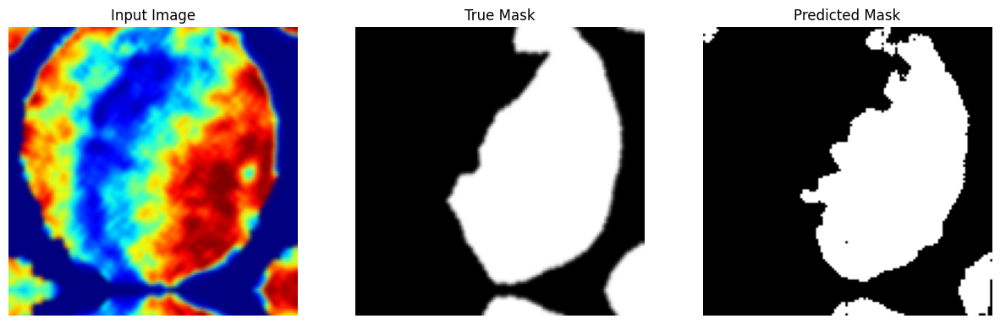


Sample Prediction after epoch 128

12/12 [==============================] - 3s 243ms/step - loss: 0.0741 - accuracy: 0.8957 - val_loss: 0.1865 - val_accuracy: 0.9337
Epoch 129/200
1/1 [==============================] - 0s 173ms/step


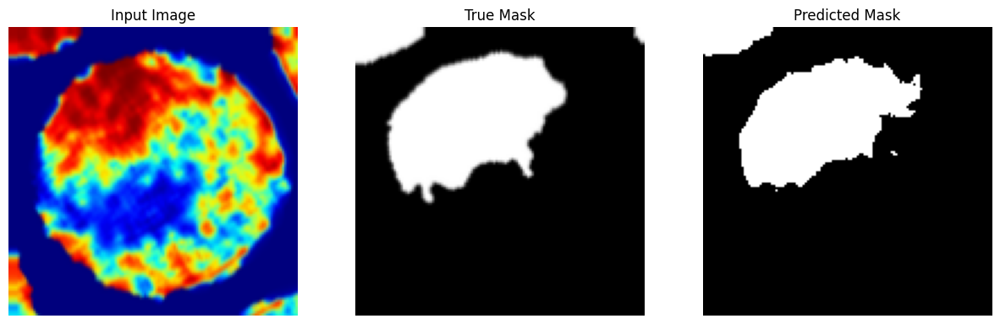


Sample Prediction after epoch 129

12/12 [==============================] - 3s 269ms/step - loss: 0.0788 - accuracy: 0.8963 - val_loss: 0.2343 - val_accuracy: 0.9174
Epoch 130/200
1/1 [==============================] - 0s 108ms/step


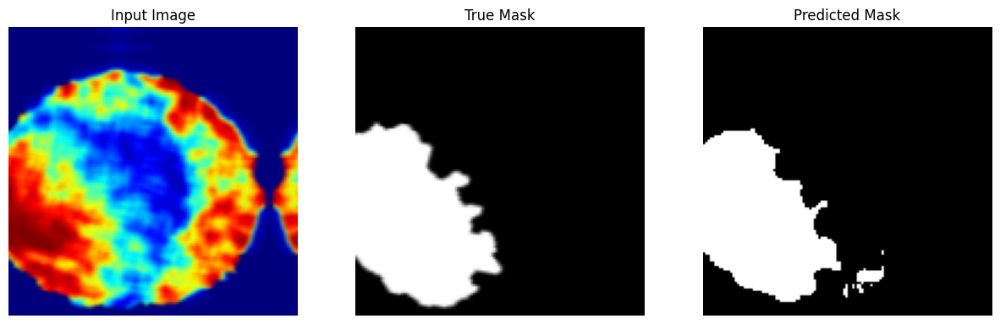


Sample Prediction after epoch 130

12/12 [==============================] - 3s 248ms/step - loss: 0.0686 - accuracy: 0.8974 - val_loss: 0.1750 - val_accuracy: 0.9346
Epoch 131/200
1/1 [==============================] - 0s 134ms/step


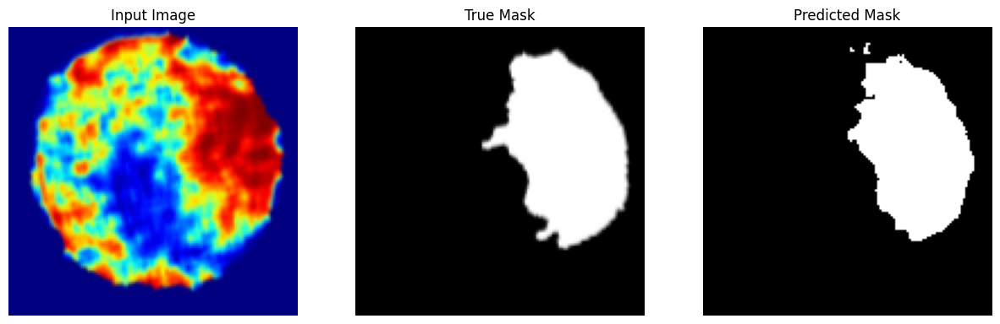


Sample Prediction after epoch 131

12/12 [==============================] - 3s 260ms/step - loss: 0.0737 - accuracy: 0.8996 - val_loss: 0.1526 - val_accuracy: 0.9438
Epoch 132/200
1/1 [==============================] - 0s 95ms/step


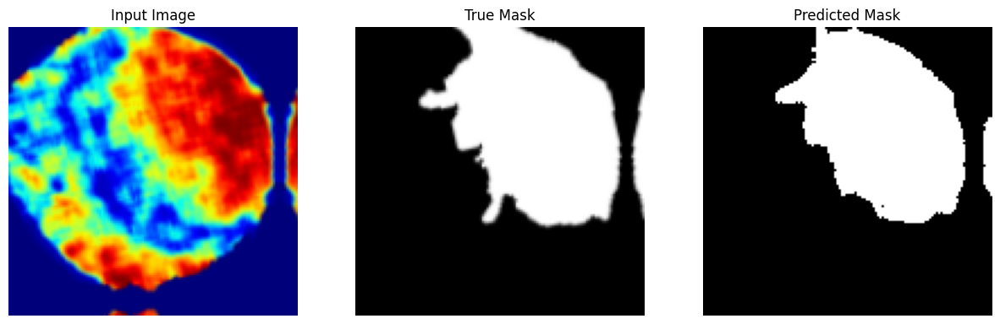


Sample Prediction after epoch 132

12/12 [==============================] - 3s 242ms/step - loss: 0.0677 - accuracy: 0.9023 - val_loss: 0.1315 - val_accuracy: 0.9476
Epoch 133/200
1/1 [==============================] - 0s 95ms/step


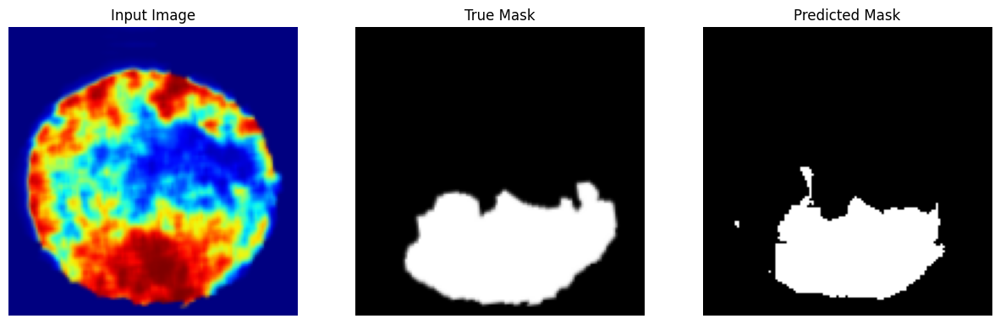


Sample Prediction after epoch 133

12/12 [==============================] - 3s 244ms/step - loss: 0.0715 - accuracy: 0.8978 - val_loss: 0.1957 - val_accuracy: 0.9344
Epoch 134/200
1/1 [==============================] - 0s 127ms/step


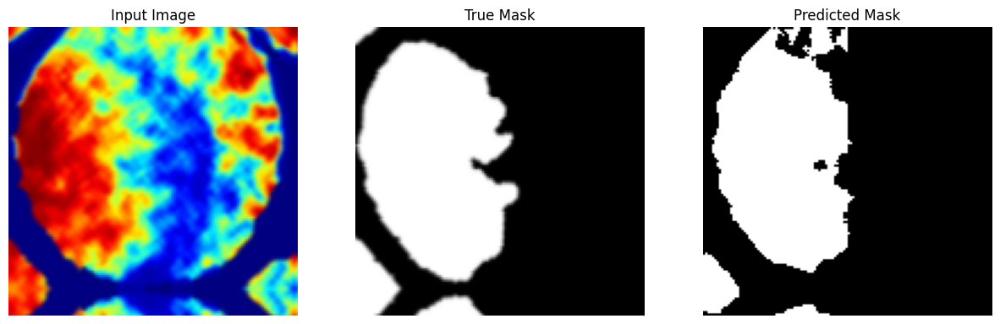


Sample Prediction after epoch 134

12/12 [==============================] - 3s 256ms/step - loss: 0.0792 - accuracy: 0.8913 - val_loss: 0.1377 - val_accuracy: 0.9480
Epoch 135/200
1/1 [==============================] - 0s 124ms/step


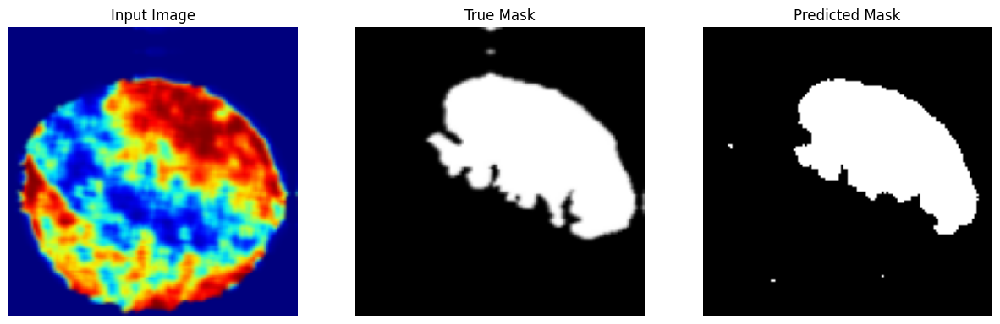


Sample Prediction after epoch 135

12/12 [==============================] - 3s 242ms/step - loss: 0.0713 - accuracy: 0.8981 - val_loss: 0.1245 - val_accuracy: 0.9515
Epoch 136/200
1/1 [==============================] - 0s 124ms/step


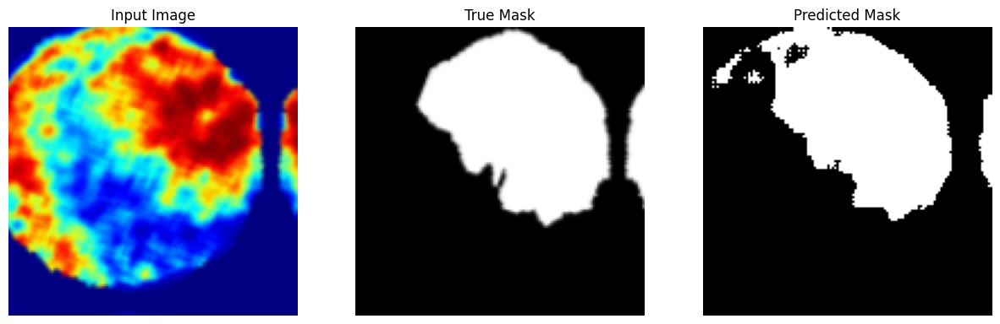


Sample Prediction after epoch 136

12/12 [==============================] - 3s 241ms/step - loss: 0.0753 - accuracy: 0.8962 - val_loss: 0.1434 - val_accuracy: 0.9472
Epoch 137/200
1/1 [==============================] - 0s 116ms/step


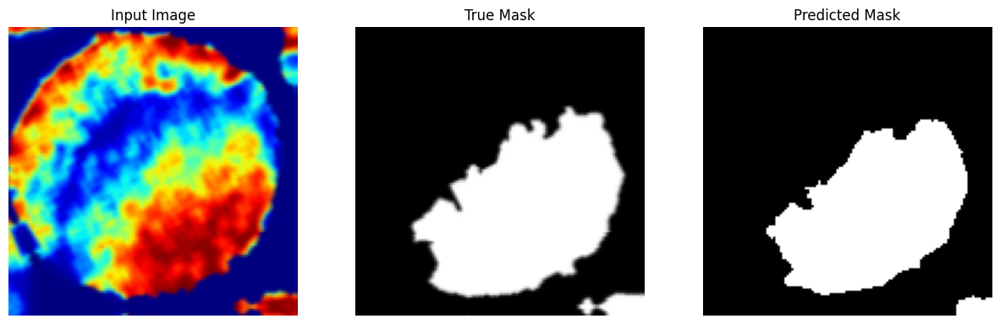


Sample Prediction after epoch 137

12/12 [==============================] - 3s 237ms/step - loss: 0.0708 - accuracy: 0.8991 - val_loss: 0.1637 - val_accuracy: 0.9437
Epoch 138/200
1/1 [==============================] - 0s 106ms/step


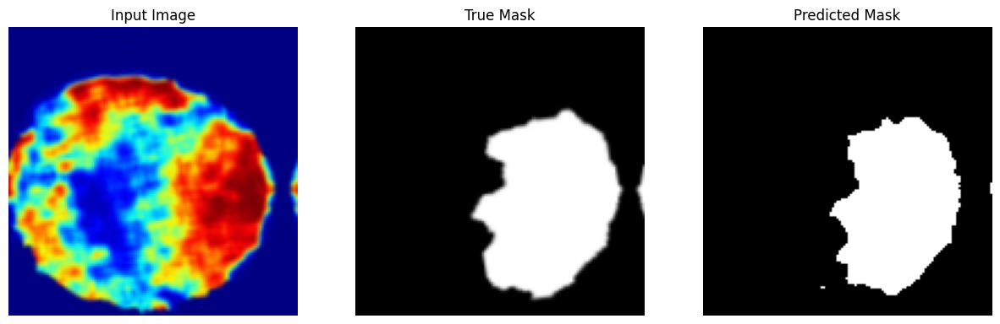


Sample Prediction after epoch 138

12/12 [==============================] - 3s 233ms/step - loss: 0.0732 - accuracy: 0.8996 - val_loss: 0.1807 - val_accuracy: 0.9365
Epoch 139/200
1/1 [==============================] - 0s 132ms/step


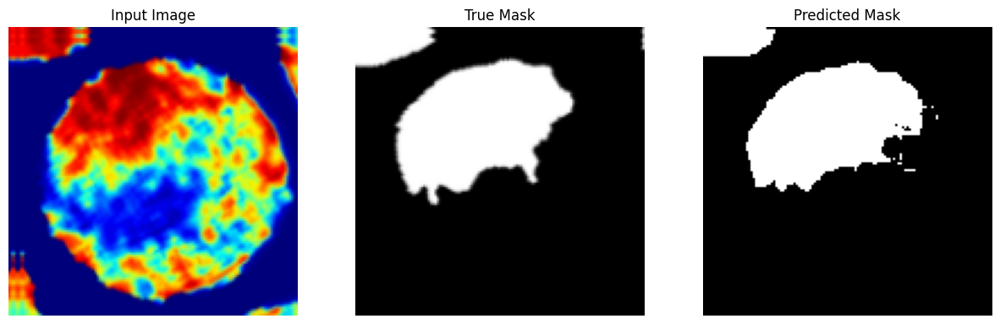


Sample Prediction after epoch 139

12/12 [==============================] - 3s 270ms/step - loss: 0.0640 - accuracy: 0.9024 - val_loss: 0.1417 - val_accuracy: 0.9475
Epoch 140/200
1/1 [==============================] - 0s 96ms/step


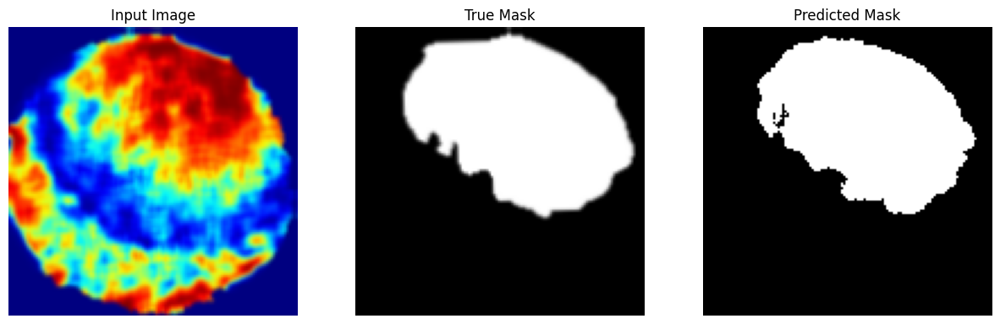


Sample Prediction after epoch 140

12/12 [==============================] - 3s 256ms/step - loss: 0.0636 - accuracy: 0.8983 - val_loss: 0.1594 - val_accuracy: 0.9432
Epoch 141/200
1/1 [==============================] - 0s 103ms/step


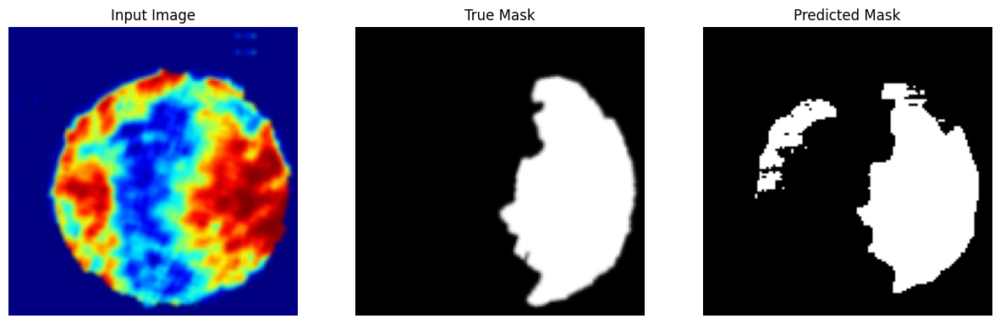


Sample Prediction after epoch 141

12/12 [==============================] - 3s 253ms/step - loss: 0.0792 - accuracy: 0.8942 - val_loss: 0.1525 - val_accuracy: 0.9446
Epoch 142/200
1/1 [==============================] - 0s 113ms/step


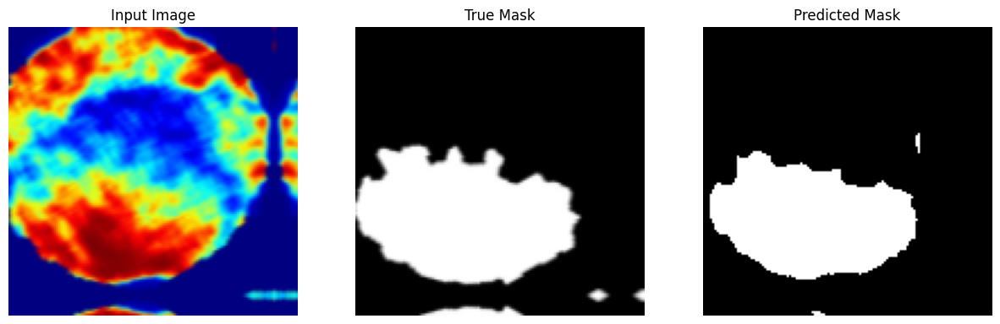


Sample Prediction after epoch 142

12/12 [==============================] - 3s 250ms/step - loss: 0.0645 - accuracy: 0.9041 - val_loss: 0.1943 - val_accuracy: 0.9318
Epoch 143/200
1/1 [==============================] - 0s 159ms/step


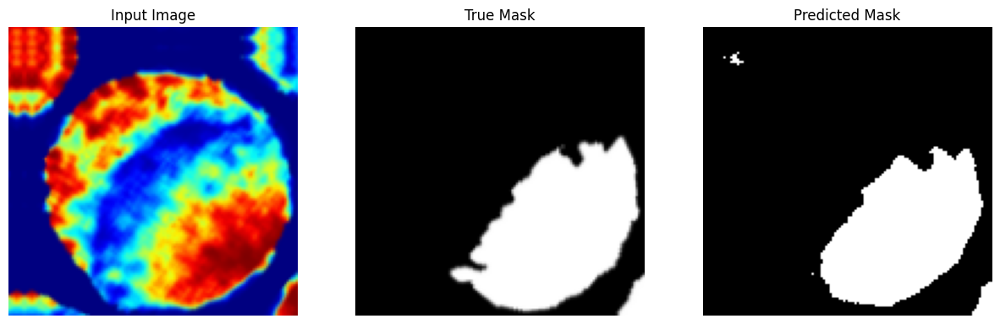


Sample Prediction after epoch 143

12/12 [==============================] - 3s 255ms/step - loss: 0.0674 - accuracy: 0.9024 - val_loss: 0.1928 - val_accuracy: 0.9328
Epoch 144/200
1/1 [==============================] - 0s 115ms/step


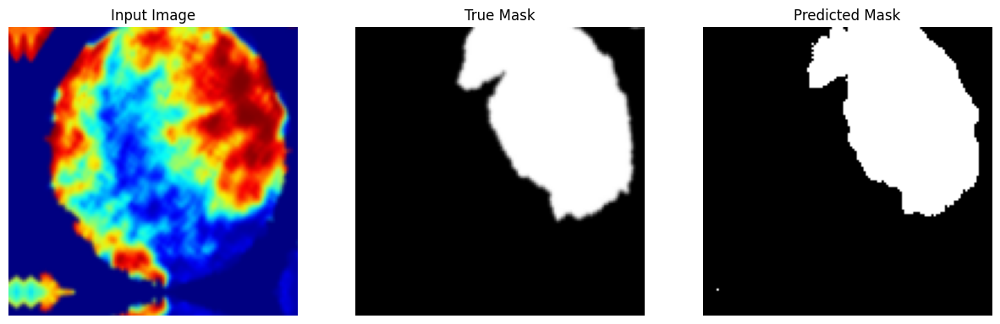


Sample Prediction after epoch 144

12/12 [==============================] - 3s 243ms/step - loss: 0.0658 - accuracy: 0.8985 - val_loss: 0.1042 - val_accuracy: 0.9602
Epoch 145/200
1/1 [==============================] - 0s 142ms/step


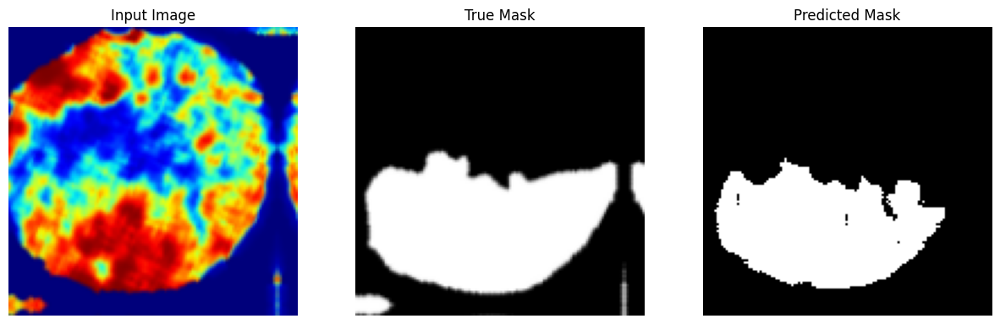


Sample Prediction after epoch 145

12/12 [==============================] - 3s 275ms/step - loss: 0.0631 - accuracy: 0.9000 - val_loss: 0.1471 - val_accuracy: 0.9452
Epoch 146/200
1/1 [==============================] - 0s 148ms/step


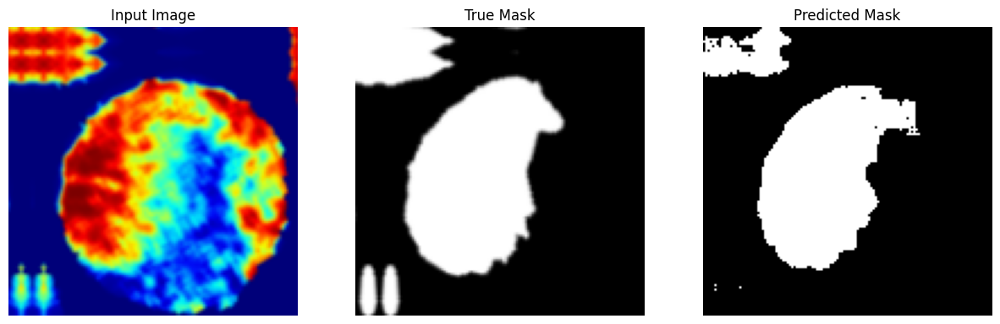


Sample Prediction after epoch 146

12/12 [==============================] - 3s 269ms/step - loss: 0.0688 - accuracy: 0.9005 - val_loss: 0.1446 - val_accuracy: 0.9466
Epoch 147/200
1/1 [==============================] - 0s 117ms/step


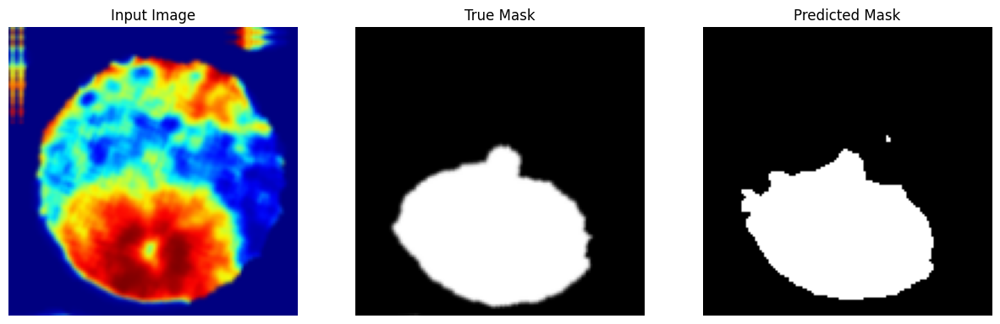


Sample Prediction after epoch 147

12/12 [==============================] - 3s 241ms/step - loss: 0.0707 - accuracy: 0.8955 - val_loss: 0.1536 - val_accuracy: 0.9456
Epoch 148/200
1/1 [==============================] - 0s 111ms/step


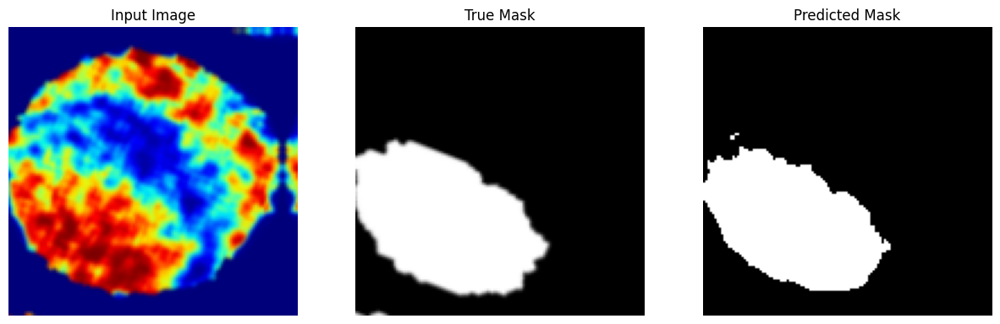


Sample Prediction after epoch 148

12/12 [==============================] - 3s 245ms/step - loss: 0.0638 - accuracy: 0.8993 - val_loss: 0.1365 - val_accuracy: 0.9486
Epoch 149/200
1/1 [==============================] - 0s 101ms/step


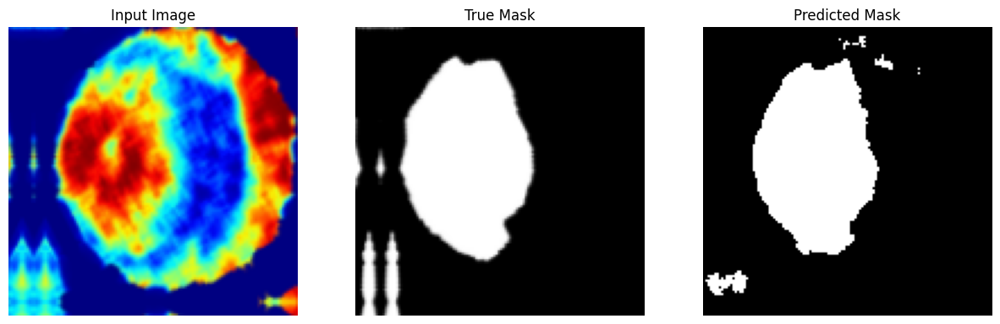


Sample Prediction after epoch 149

12/12 [==============================] - 3s 239ms/step - loss: 0.0670 - accuracy: 0.9006 - val_loss: 0.1286 - val_accuracy: 0.9503
Epoch 150/200
1/1 [==============================] - 0s 129ms/step


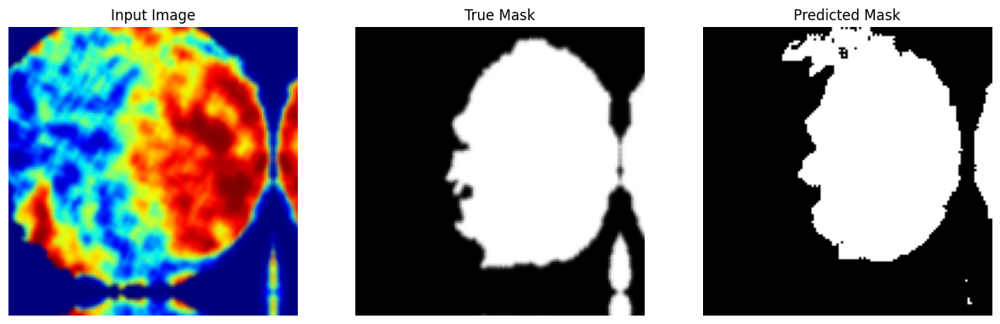


Sample Prediction after epoch 150

12/12 [==============================] - 3s 272ms/step - loss: 0.0696 - accuracy: 0.8979 - val_loss: 0.1260 - val_accuracy: 0.9503
Epoch 151/200
1/1 [==============================] - 0s 100ms/step


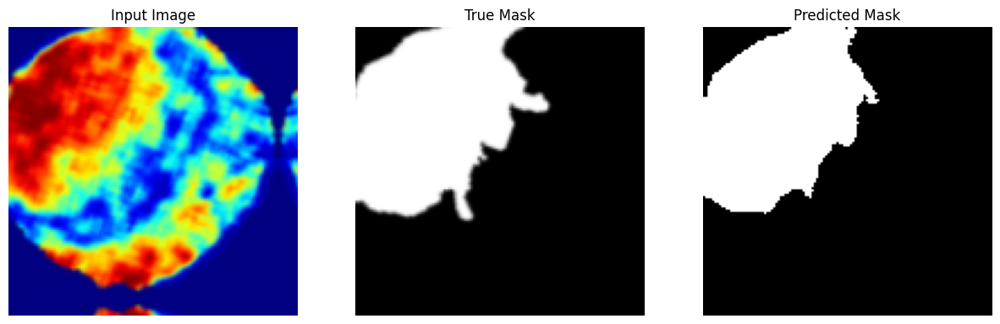


Sample Prediction after epoch 151

12/12 [==============================] - 3s 232ms/step - loss: 0.0627 - accuracy: 0.9017 - val_loss: 0.1481 - val_accuracy: 0.9467
Epoch 152/200
1/1 [==============================] - 0s 101ms/step


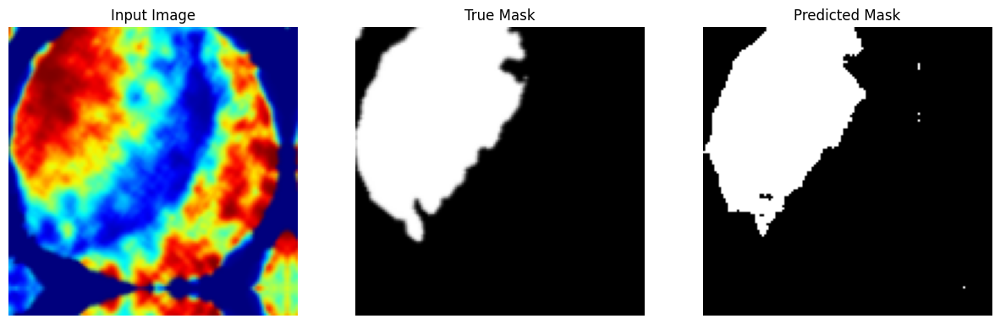


Sample Prediction after epoch 152

12/12 [==============================] - 3s 238ms/step - loss: 0.0656 - accuracy: 0.9024 - val_loss: 0.1672 - val_accuracy: 0.9409
Epoch 153/200
1/1 [==============================] - 0s 105ms/step


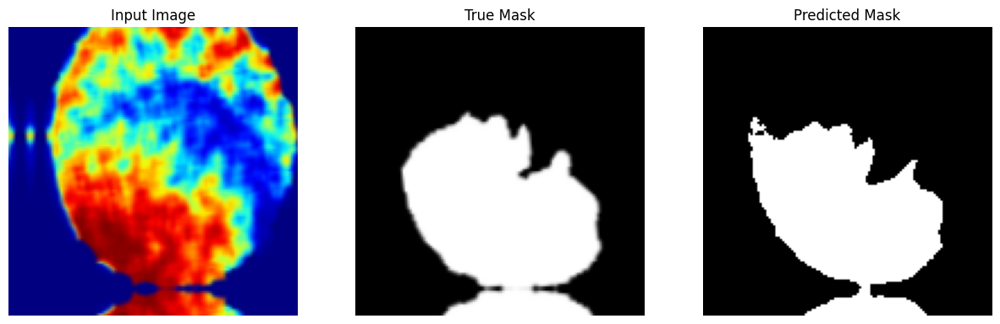


Sample Prediction after epoch 153

12/12 [==============================] - 3s 250ms/step - loss: 0.0638 - accuracy: 0.9036 - val_loss: 0.1752 - val_accuracy: 0.9403
Epoch 154/200
1/1 [==============================] - 0s 119ms/step


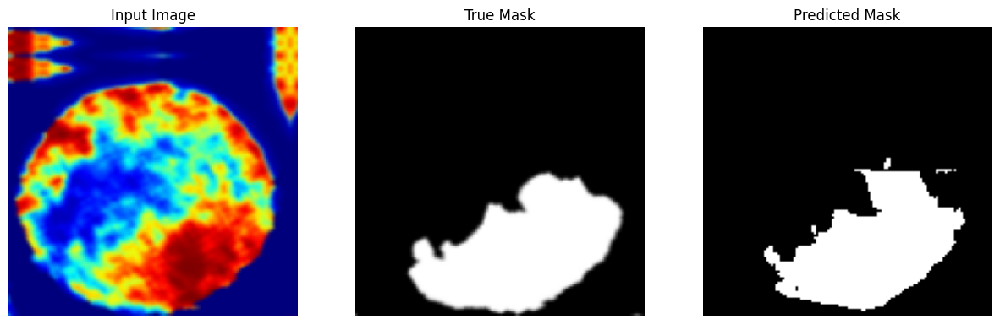


Sample Prediction after epoch 154

12/12 [==============================] - 3s 240ms/step - loss: 0.0646 - accuracy: 0.9018 - val_loss: 0.1340 - val_accuracy: 0.9486
Epoch 155/200
1/1 [==============================] - 0s 104ms/step


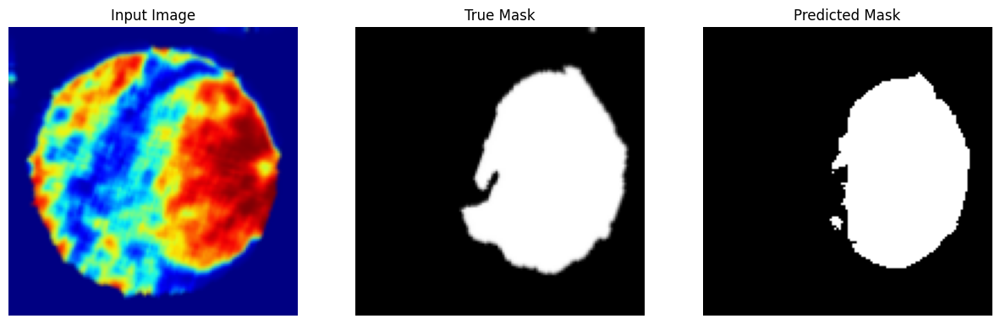


Sample Prediction after epoch 155

12/12 [==============================] - 3s 231ms/step - loss: 0.0716 - accuracy: 0.9020 - val_loss: 0.1795 - val_accuracy: 0.9420
Epoch 156/200
1/1 [==============================] - 0s 136ms/step


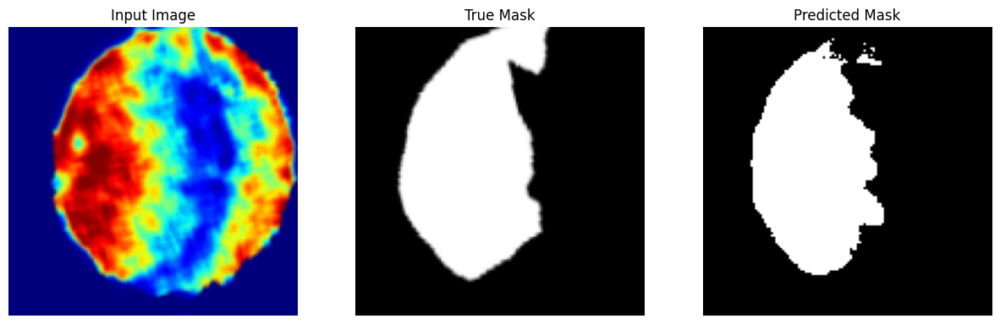


Sample Prediction after epoch 156

12/12 [==============================] - 3s 258ms/step - loss: 0.0712 - accuracy: 0.8949 - val_loss: 0.1651 - val_accuracy: 0.9443
Epoch 157/200
1/1 [==============================] - 0s 118ms/step


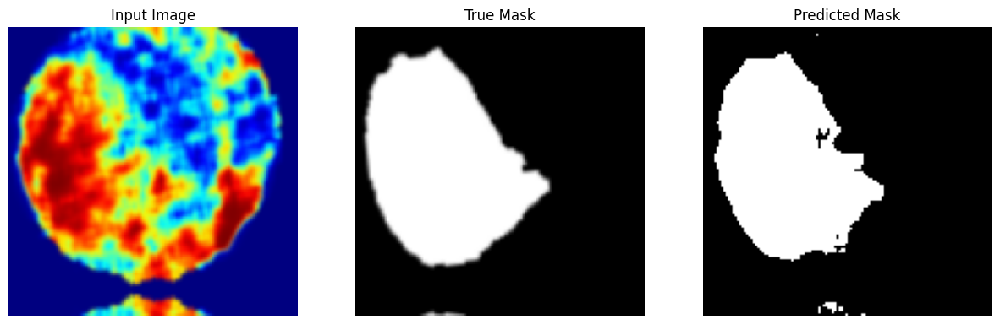


Sample Prediction after epoch 157

12/12 [==============================] - 3s 250ms/step - loss: 0.0700 - accuracy: 0.9005 - val_loss: 0.1912 - val_accuracy: 0.9388
Epoch 158/200
1/1 [==============================] - 0s 99ms/step


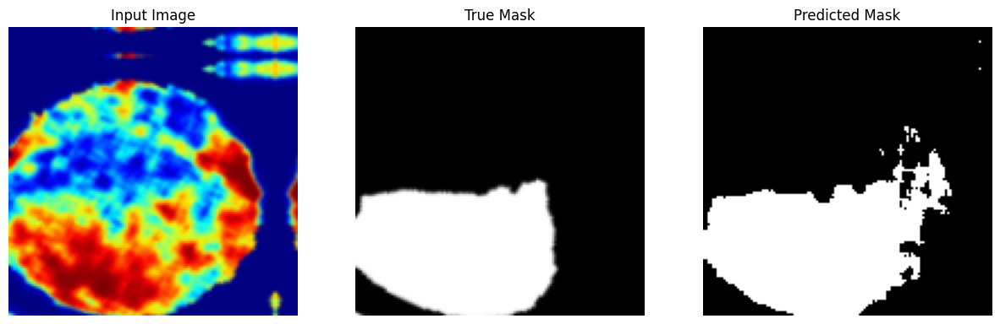


Sample Prediction after epoch 158

12/12 [==============================] - 3s 241ms/step - loss: 0.0802 - accuracy: 0.8944 - val_loss: 0.1042 - val_accuracy: 0.9565
Epoch 159/200
1/1 [==============================] - 0s 93ms/step


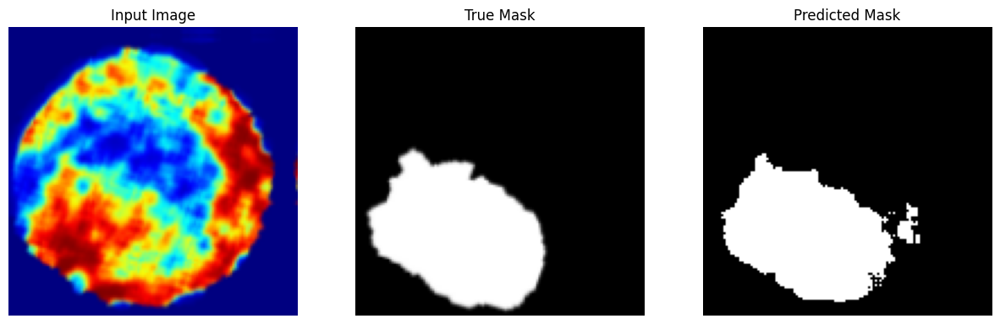


Sample Prediction after epoch 159

12/12 [==============================] - 3s 237ms/step - loss: 0.0695 - accuracy: 0.8989 - val_loss: 0.1605 - val_accuracy: 0.9463
Epoch 160/200
1/1 [==============================] - 0s 113ms/step


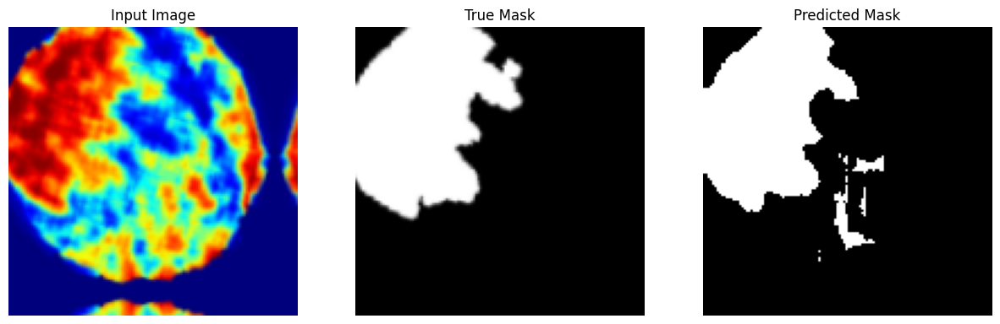


Sample Prediction after epoch 160

12/12 [==============================] - 3s 259ms/step - loss: 0.0642 - accuracy: 0.9016 - val_loss: 0.1526 - val_accuracy: 0.9462
Epoch 161/200
1/1 [==============================] - 0s 95ms/step


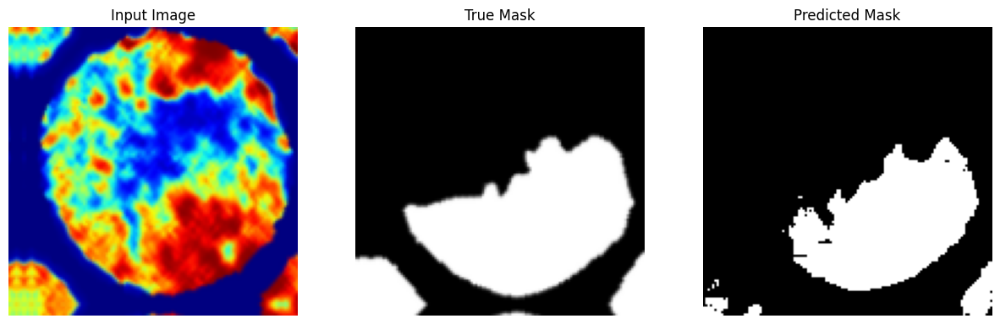


Sample Prediction after epoch 161

12/12 [==============================] - 3s 252ms/step - loss: 0.0671 - accuracy: 0.8980 - val_loss: 0.1875 - val_accuracy: 0.9340
Epoch 162/200
1/1 [==============================] - 0s 100ms/step


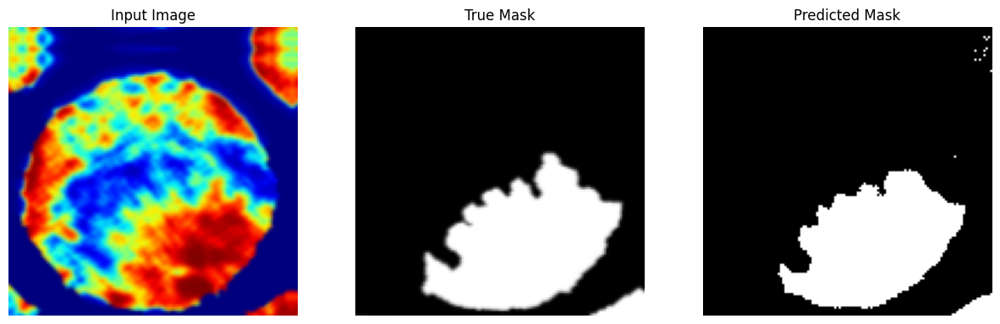


Sample Prediction after epoch 162

12/12 [==============================] - 3s 238ms/step - loss: 0.0704 - accuracy: 0.8959 - val_loss: 0.1555 - val_accuracy: 0.9416
Epoch 163/200
1/1 [==============================] - 0s 113ms/step


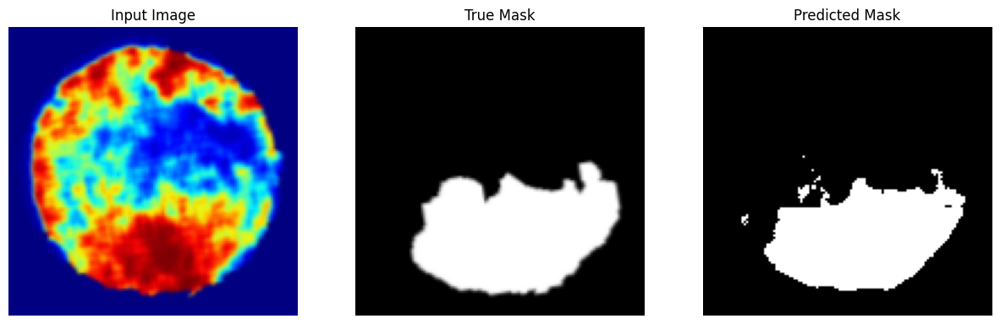


Sample Prediction after epoch 163

12/12 [==============================] - 3s 272ms/step - loss: 0.0740 - accuracy: 0.8975 - val_loss: 0.1599 - val_accuracy: 0.9400
Epoch 164/200
1/1 [==============================] - 0s 101ms/step


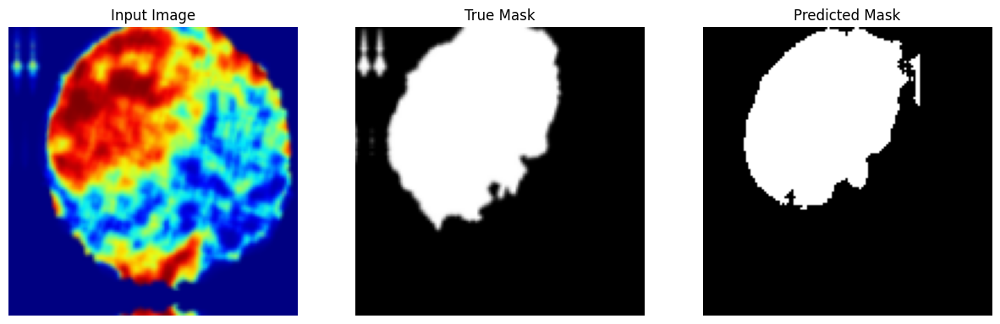


Sample Prediction after epoch 164

12/12 [==============================] - 3s 246ms/step - loss: 0.0626 - accuracy: 0.8997 - val_loss: 0.2048 - val_accuracy: 0.9325
Epoch 165/200
1/1 [==============================] - 0s 140ms/step


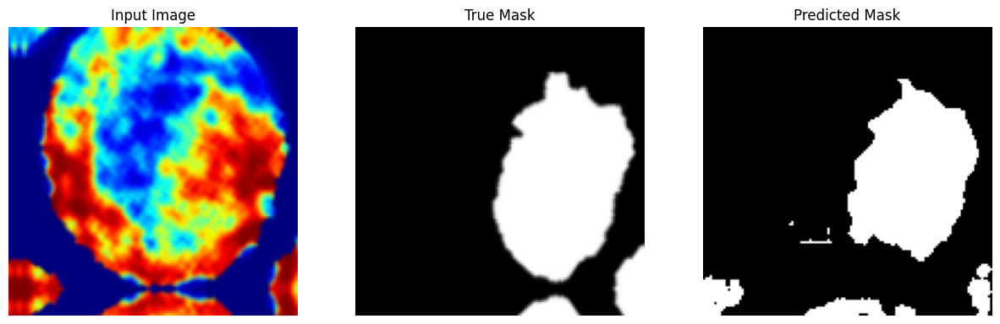


Sample Prediction after epoch 165

12/12 [==============================] - 3s 251ms/step - loss: 0.0718 - accuracy: 0.8978 - val_loss: 0.1930 - val_accuracy: 0.9365
Epoch 166/200
1/1 [==============================] - 0s 118ms/step


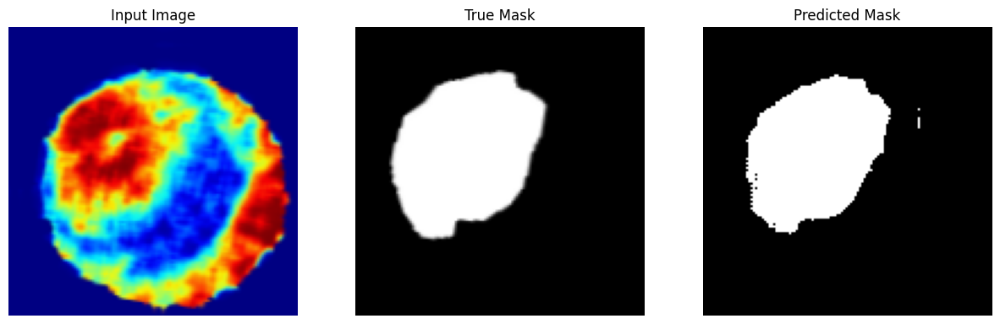


Sample Prediction after epoch 166

12/12 [==============================] - 3s 243ms/step - loss: 0.0692 - accuracy: 0.8958 - val_loss: 0.1566 - val_accuracy: 0.9412
Epoch 167/200
1/1 [==============================] - 0s 115ms/step


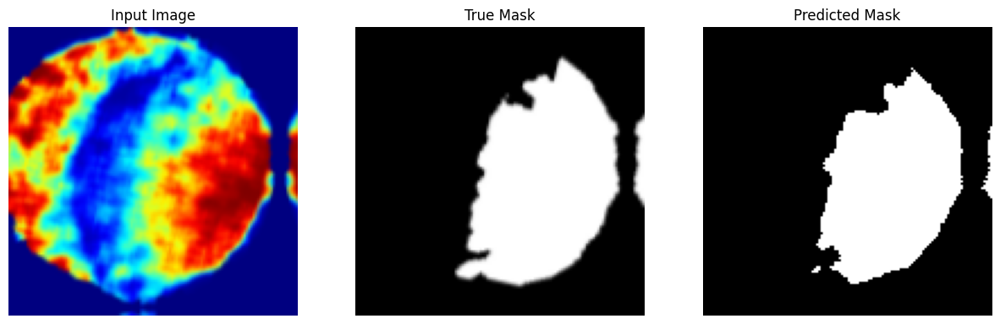


Sample Prediction after epoch 167

12/12 [==============================] - 3s 245ms/step - loss: 0.0765 - accuracy: 0.8949 - val_loss: 0.1562 - val_accuracy: 0.9413
Epoch 168/200
1/1 [==============================] - 0s 124ms/step


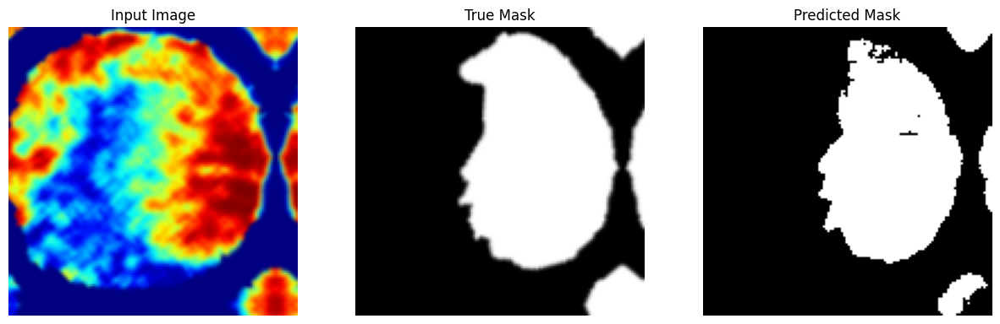


Sample Prediction after epoch 168

12/12 [==============================] - 3s 247ms/step - loss: 0.0772 - accuracy: 0.8945 - val_loss: 0.2043 - val_accuracy: 0.9305
Epoch 169/200
1/1 [==============================] - 0s 94ms/step


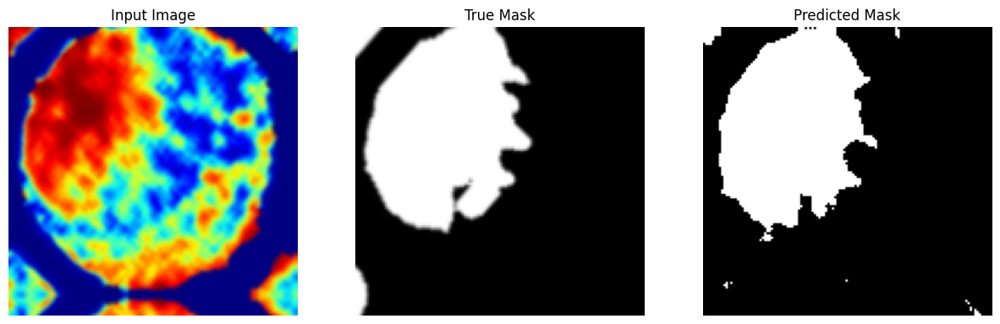


Sample Prediction after epoch 169

12/12 [==============================] - 3s 247ms/step - loss: 0.0728 - accuracy: 0.8994 - val_loss: 0.1111 - val_accuracy: 0.9558
Epoch 170/200
1/1 [==============================] - 0s 125ms/step


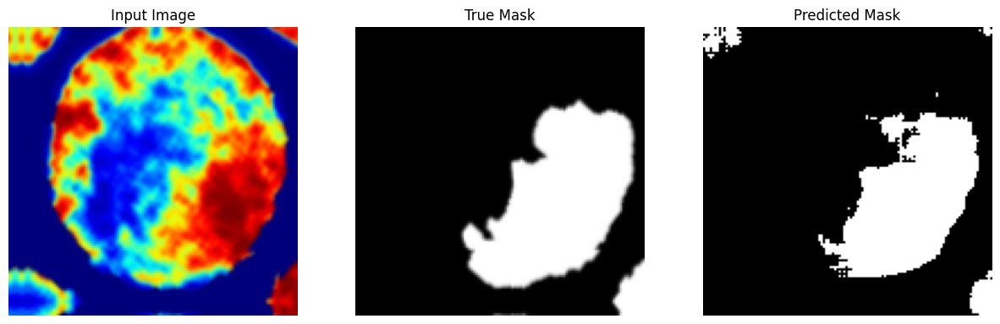


Sample Prediction after epoch 170

12/12 [==============================] - 3s 270ms/step - loss: 0.0723 - accuracy: 0.8947 - val_loss: 0.1918 - val_accuracy: 0.9387
Epoch 171/200
1/1 [==============================] - 0s 105ms/step


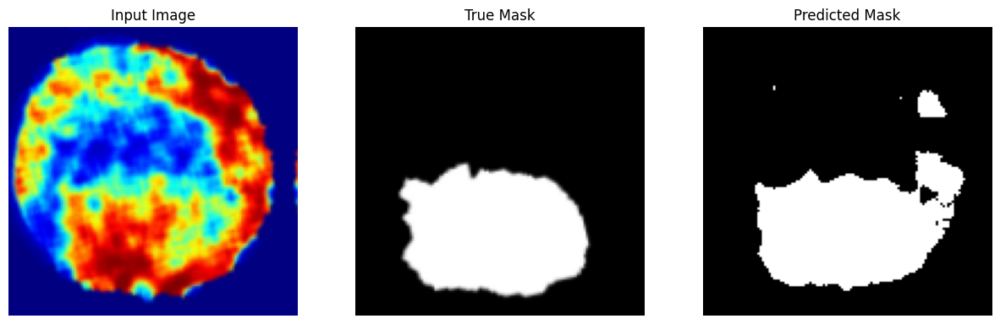


Sample Prediction after epoch 171

12/12 [==============================] - 3s 244ms/step - loss: 0.0671 - accuracy: 0.9010 - val_loss: 0.1317 - val_accuracy: 0.9494
Epoch 172/200
1/1 [==============================] - 0s 111ms/step


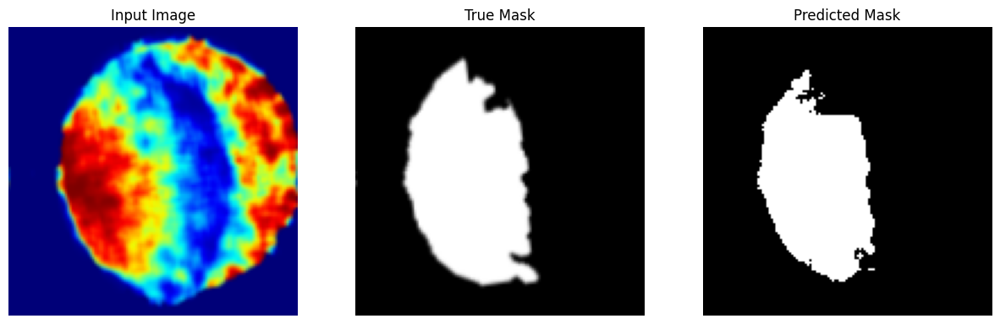


Sample Prediction after epoch 172

12/12 [==============================] - 3s 261ms/step - loss: 0.0686 - accuracy: 0.9005 - val_loss: 0.2177 - val_accuracy: 0.9314
Epoch 173/200
1/1 [==============================] - 0s 94ms/step


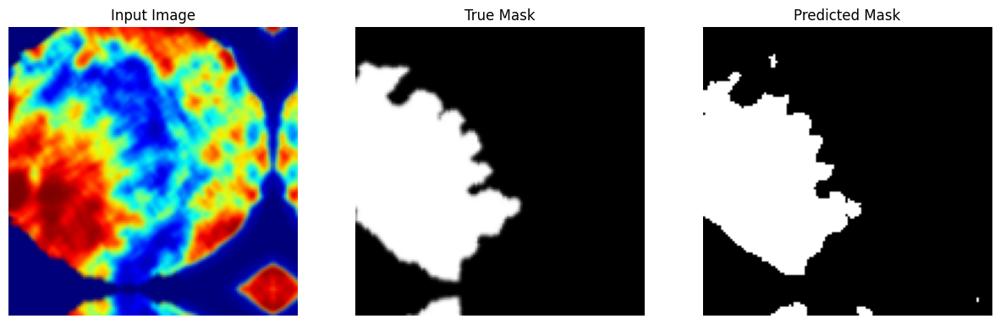


Sample Prediction after epoch 173

12/12 [==============================] - 3s 238ms/step - loss: 0.0697 - accuracy: 0.8976 - val_loss: 0.1345 - val_accuracy: 0.9484
Epoch 174/200
1/1 [==============================] - 0s 130ms/step


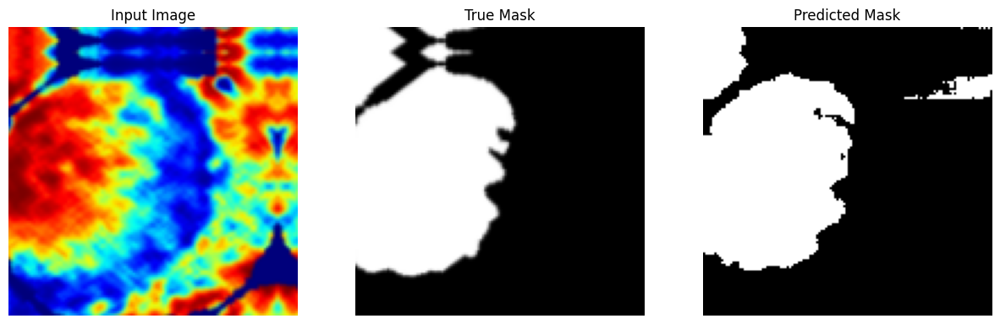


Sample Prediction after epoch 174

12/12 [==============================] - 3s 258ms/step - loss: 0.0625 - accuracy: 0.8991 - val_loss: 0.1553 - val_accuracy: 0.9441
Epoch 175/200
1/1 [==============================] - 0s 119ms/step


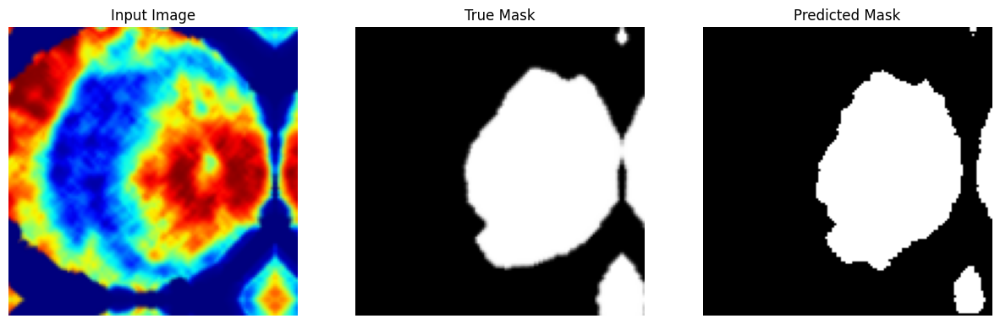


Sample Prediction after epoch 175

12/12 [==============================] - 3s 253ms/step - loss: 0.0618 - accuracy: 0.9009 - val_loss: 0.1608 - val_accuracy: 0.9433
Epoch 176/200
1/1 [==============================] - 0s 109ms/step


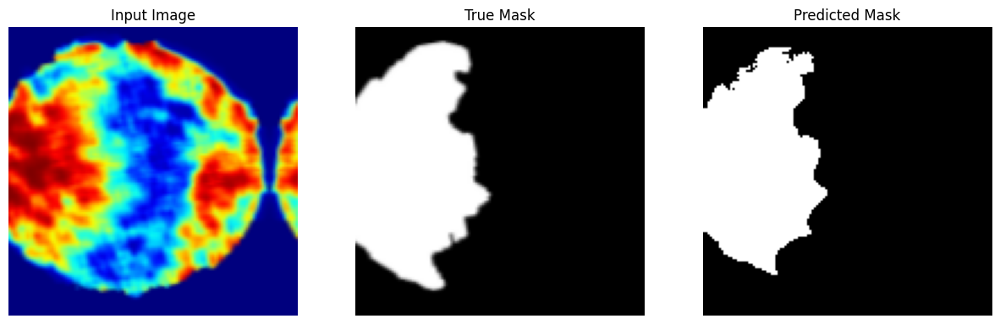


Sample Prediction after epoch 176

12/12 [==============================] - 3s 244ms/step - loss: 0.0687 - accuracy: 0.9011 - val_loss: 0.1495 - val_accuracy: 0.9481
Epoch 177/200
1/1 [==============================] - 0s 135ms/step


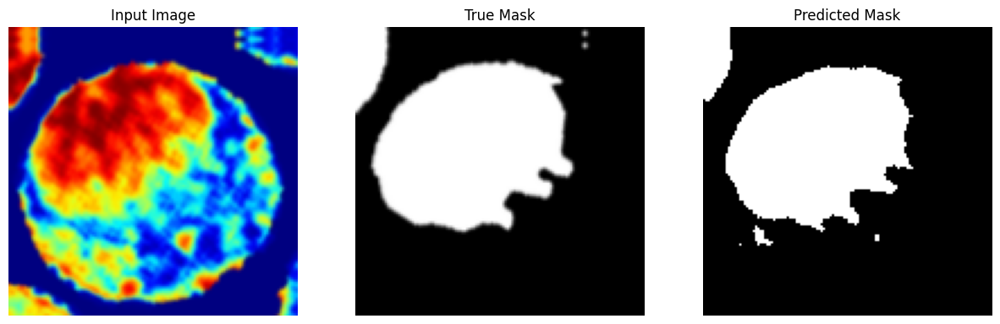


Sample Prediction after epoch 177

12/12 [==============================] - 3s 239ms/step - loss: 0.0666 - accuracy: 0.8987 - val_loss: 0.1345 - val_accuracy: 0.9493
Epoch 178/200
1/1 [==============================] - 0s 99ms/step


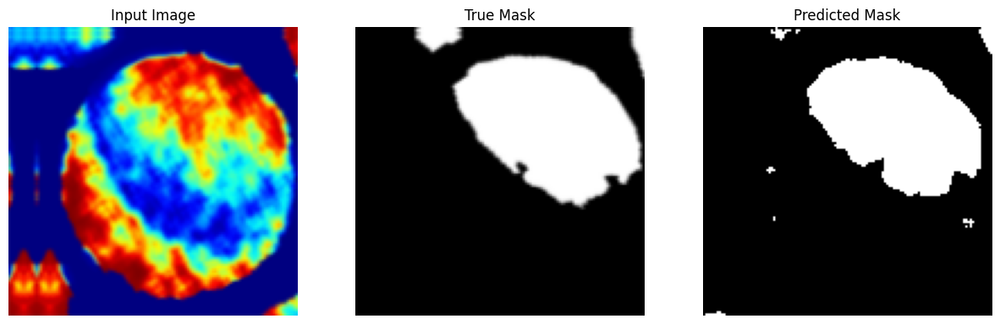


Sample Prediction after epoch 178

12/12 [==============================] - 3s 247ms/step - loss: 0.0661 - accuracy: 0.8984 - val_loss: 0.1286 - val_accuracy: 0.9515
Epoch 179/200
1/1 [==============================] - 0s 123ms/step


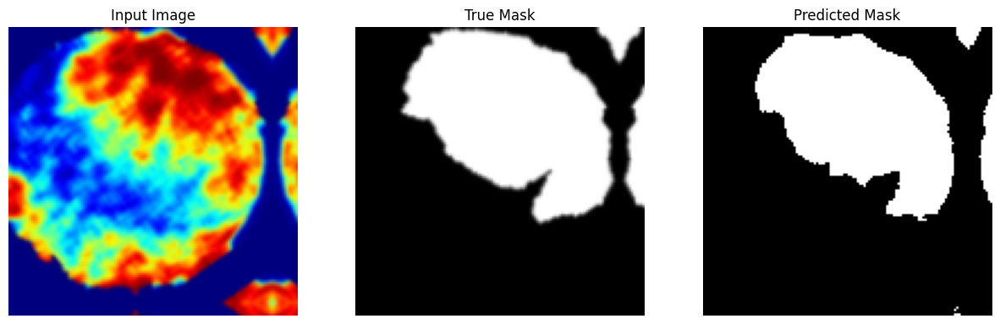


Sample Prediction after epoch 179

12/12 [==============================] - 3s 264ms/step - loss: 0.0608 - accuracy: 0.9055 - val_loss: 0.1762 - val_accuracy: 0.9369
Epoch 180/200
1/1 [==============================] - 0s 106ms/step


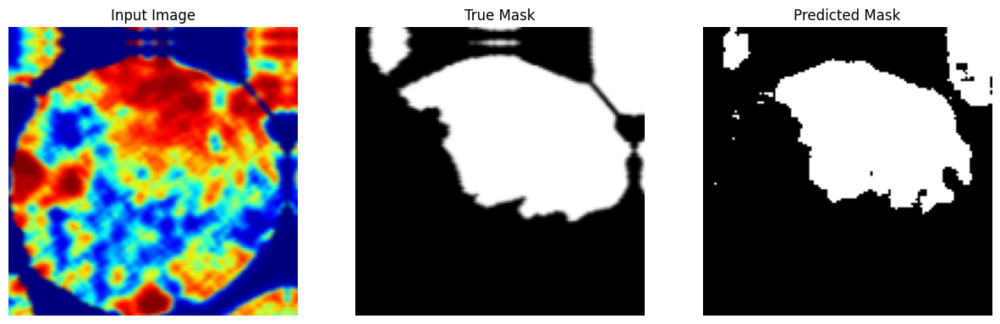


Sample Prediction after epoch 180

12/12 [==============================] - 3s 237ms/step - loss: 0.0586 - accuracy: 0.9020 - val_loss: 0.2150 - val_accuracy: 0.9290
Epoch 181/200
1/1 [==============================] - 0s 100ms/step


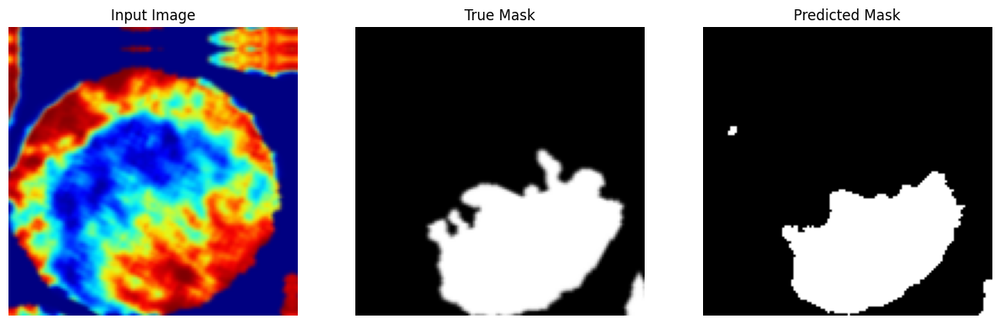


Sample Prediction after epoch 181

12/12 [==============================] - 3s 269ms/step - loss: 0.0648 - accuracy: 0.9000 - val_loss: 0.1696 - val_accuracy: 0.9406
Epoch 182/200
1/1 [==============================] - 0s 103ms/step


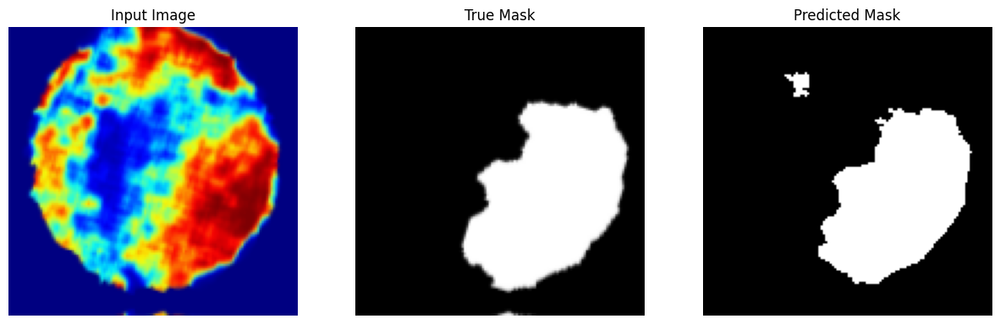


Sample Prediction after epoch 182

12/12 [==============================] - 3s 242ms/step - loss: 0.0601 - accuracy: 0.9030 - val_loss: 0.1399 - val_accuracy: 0.9472
Epoch 183/200
1/1 [==============================] - 0s 122ms/step


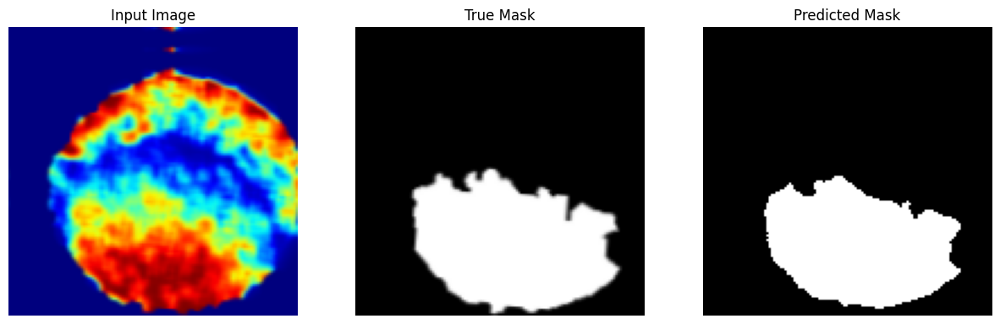


Sample Prediction after epoch 183

12/12 [==============================] - 3s 263ms/step - loss: 0.0594 - accuracy: 0.9024 - val_loss: 0.1531 - val_accuracy: 0.9446
Epoch 184/200
1/1 [==============================] - 0s 133ms/step


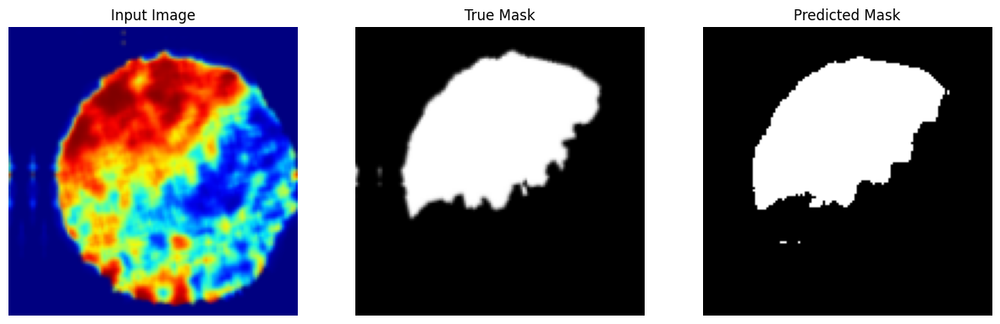


Sample Prediction after epoch 184

12/12 [==============================] - 3s 293ms/step - loss: 0.0727 - accuracy: 0.8992 - val_loss: 0.1323 - val_accuracy: 0.9487
Epoch 185/200
1/1 [==============================] - 0s 106ms/step


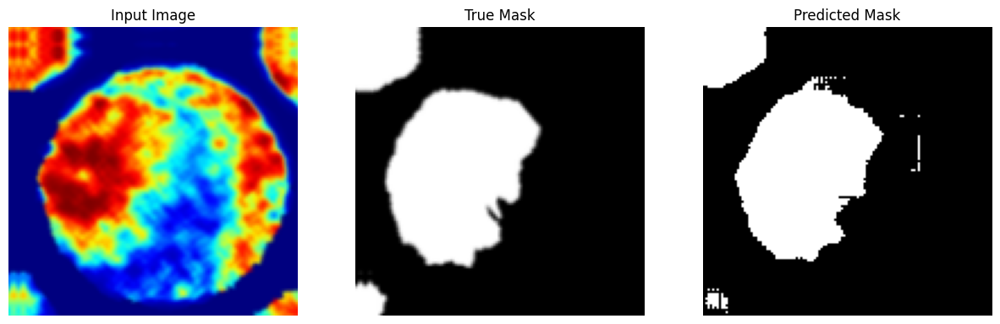


Sample Prediction after epoch 185

12/12 [==============================] - 3s 248ms/step - loss: 0.0607 - accuracy: 0.9010 - val_loss: 0.1669 - val_accuracy: 0.9428
Epoch 186/200
1/1 [==============================] - 0s 132ms/step


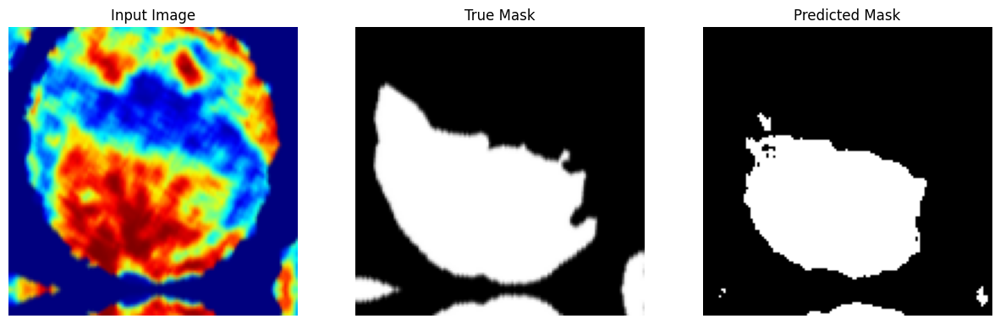


Sample Prediction after epoch 186

12/12 [==============================] - 3s 270ms/step - loss: 0.0645 - accuracy: 0.9052 - val_loss: 0.2445 - val_accuracy: 0.9268
Epoch 187/200
1/1 [==============================] - 0s 110ms/step


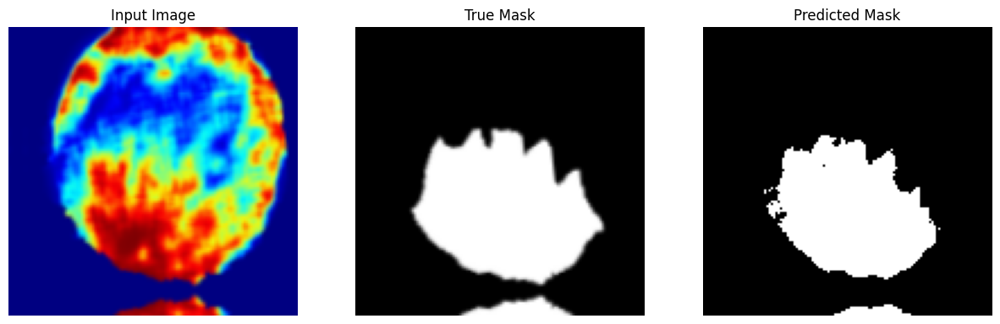


Sample Prediction after epoch 187

12/12 [==============================] - 3s 265ms/step - loss: 0.0736 - accuracy: 0.8961 - val_loss: 0.2824 - val_accuracy: 0.9199
Epoch 188/200
1/1 [==============================] - 0s 161ms/step


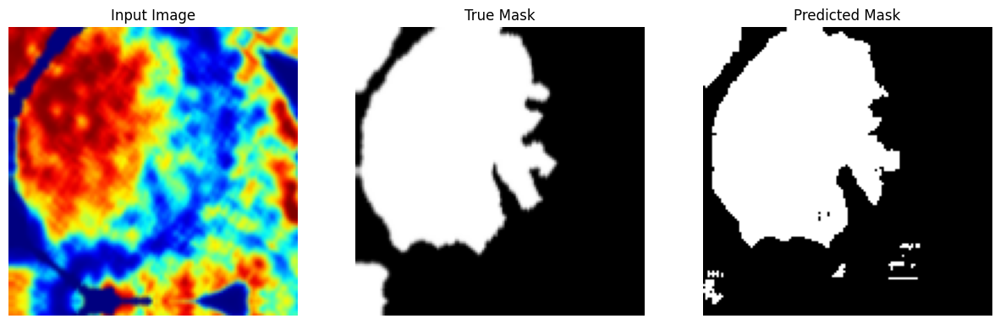


Sample Prediction after epoch 188

12/12 [==============================] - 4s 327ms/step - loss: 0.0778 - accuracy: 0.8934 - val_loss: 0.1421 - val_accuracy: 0.9437
Epoch 189/200
1/1 [==============================] - 0s 134ms/step


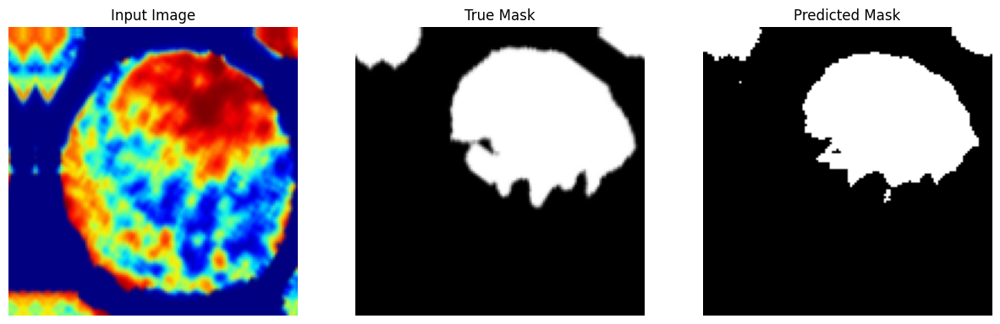


Sample Prediction after epoch 189

12/12 [==============================] - 3s 295ms/step - loss: 0.0649 - accuracy: 0.9014 - val_loss: 0.1442 - val_accuracy: 0.9479
Epoch 190/200
1/1 [==============================] - 0s 119ms/step


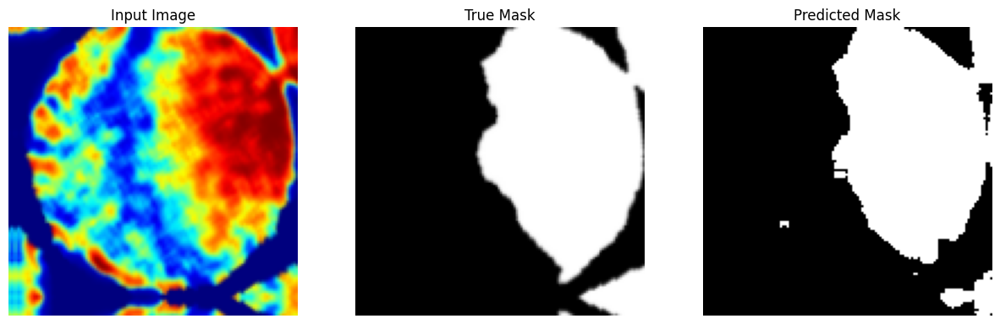


Sample Prediction after epoch 190

12/12 [==============================] - 4s 325ms/step - loss: 0.0729 - accuracy: 0.8994 - val_loss: 0.1606 - val_accuracy: 0.9447
Epoch 191/200
1/1 [==============================] - 0s 198ms/step


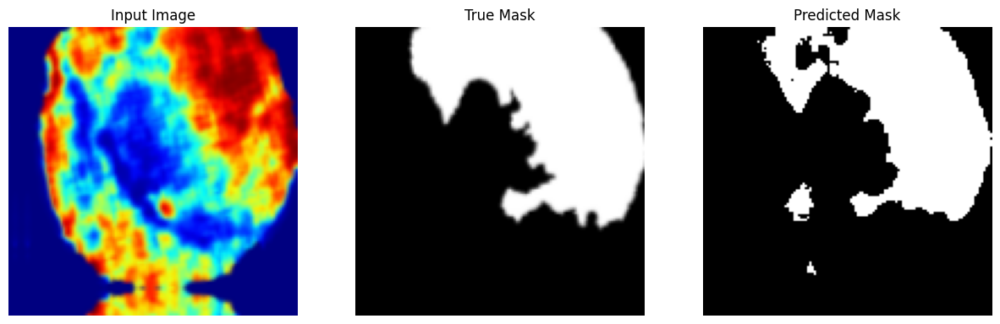


Sample Prediction after epoch 191

12/12 [==============================] - 5s 448ms/step - loss: 0.0624 - accuracy: 0.9013 - val_loss: 0.1409 - val_accuracy: 0.9450
Epoch 192/200
1/1 [==============================] - 0s 238ms/step


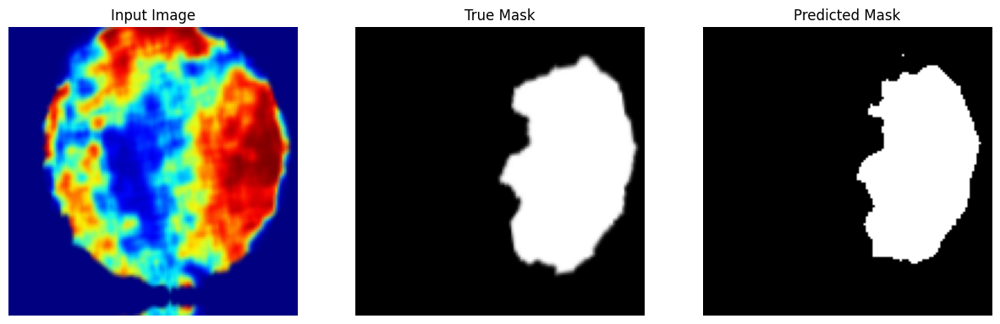


Sample Prediction after epoch 192

12/12 [==============================] - 5s 439ms/step - loss: 0.0609 - accuracy: 0.9012 - val_loss: 0.1800 - val_accuracy: 0.9394
Epoch 193/200
1/1 [==============================] - 0s 134ms/step


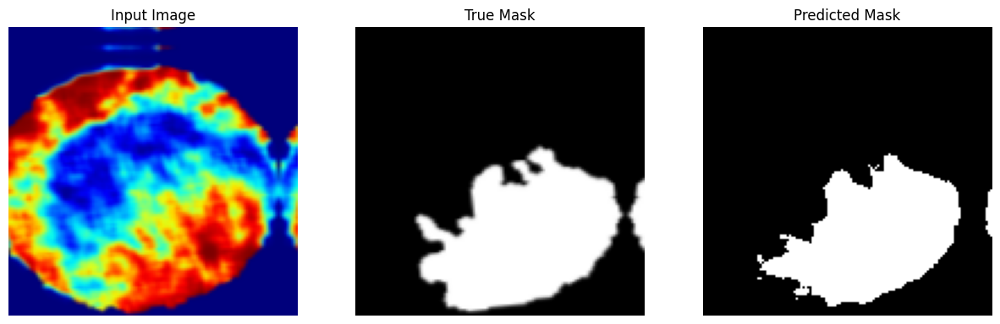


Sample Prediction after epoch 193

12/12 [==============================] - 4s 348ms/step - loss: 0.0631 - accuracy: 0.9007 - val_loss: 0.1417 - val_accuracy: 0.9475
Epoch 194/200
1/1 [==============================] - 0s 160ms/step


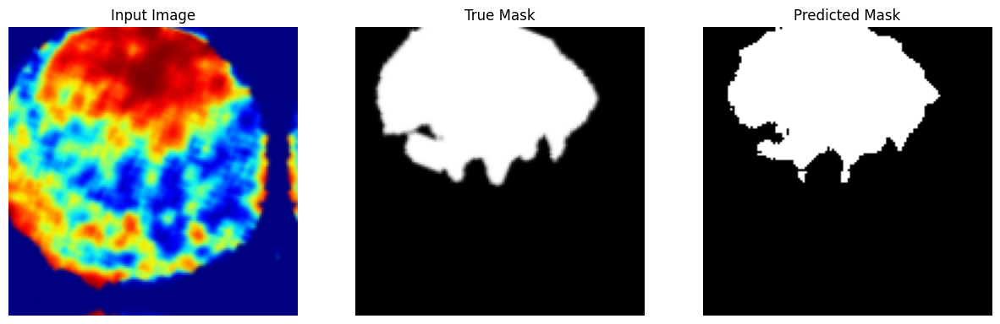


Sample Prediction after epoch 194

12/12 [==============================] - 3s 287ms/step - loss: 0.0707 - accuracy: 0.8997 - val_loss: 0.1499 - val_accuracy: 0.9458
Epoch 195/200
1/1 [==============================] - 0s 110ms/step


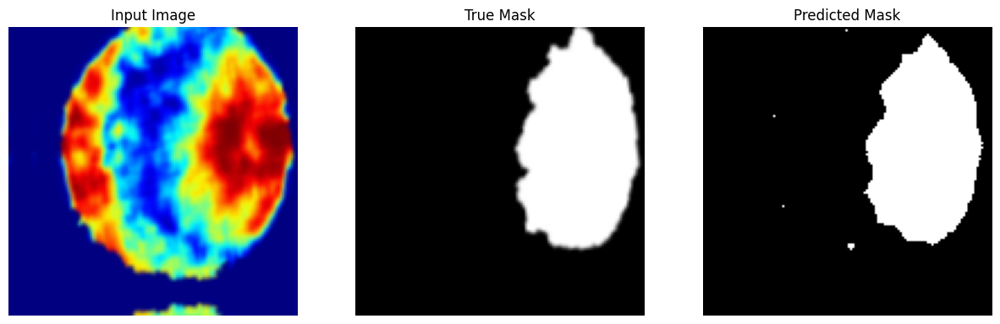


Sample Prediction after epoch 195

12/12 [==============================] - 4s 341ms/step - loss: 0.0687 - accuracy: 0.9018 - val_loss: 0.1898 - val_accuracy: 0.9380
Epoch 196/200
1/1 [==============================] - 0s 94ms/step


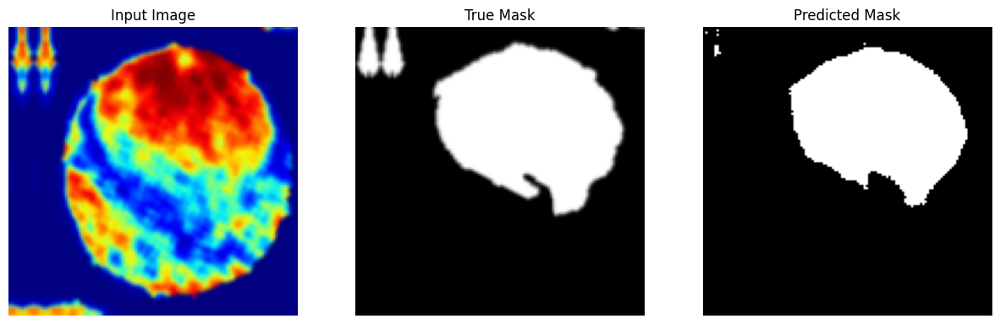


Sample Prediction after epoch 196

12/12 [==============================] - 3s 258ms/step - loss: 0.0707 - accuracy: 0.8966 - val_loss: 0.1854 - val_accuracy: 0.9404
Epoch 197/200
1/1 [==============================] - 0s 125ms/step


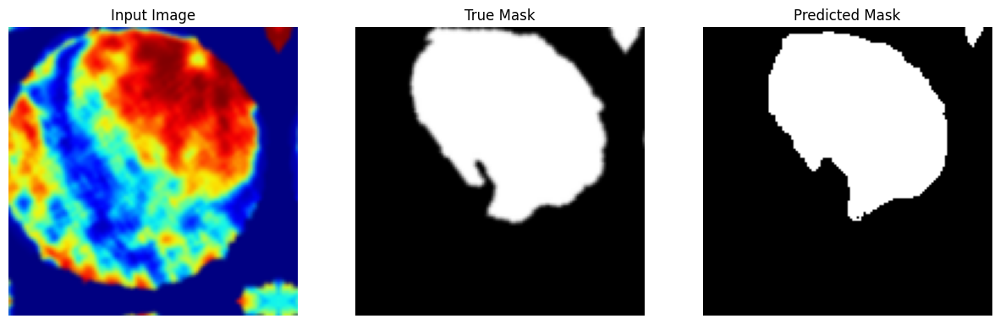


Sample Prediction after epoch 197

12/12 [==============================] - 3s 295ms/step - loss: 0.0669 - accuracy: 0.8988 - val_loss: 0.2033 - val_accuracy: 0.9377
Epoch 198/200
1/1 [==============================] - 0s 150ms/step


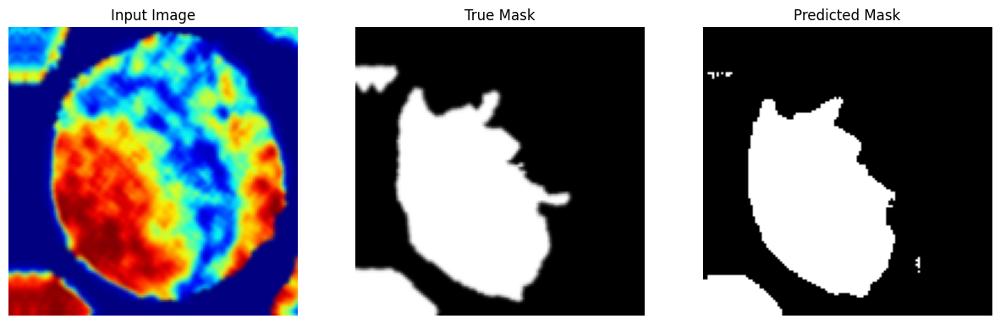


Sample Prediction after epoch 198

12/12 [==============================] - 3s 287ms/step - loss: 0.0617 - accuracy: 0.9018 - val_loss: 0.1513 - val_accuracy: 0.9488
Epoch 199/200
1/1 [==============================] - 0s 92ms/step


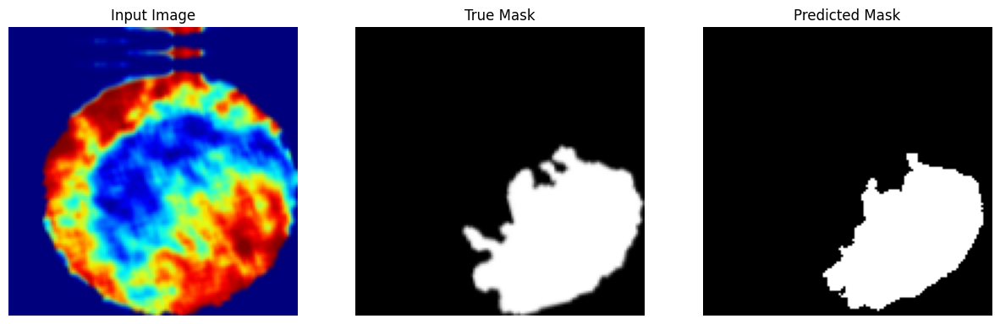


Sample Prediction after epoch 199

12/12 [==============================] - 3s 239ms/step - loss: 0.0620 - accuracy: 0.9025 - val_loss: 0.1498 - val_accuracy: 0.9462
Epoch 200/200
1/1 [==============================] - 0s 98ms/step


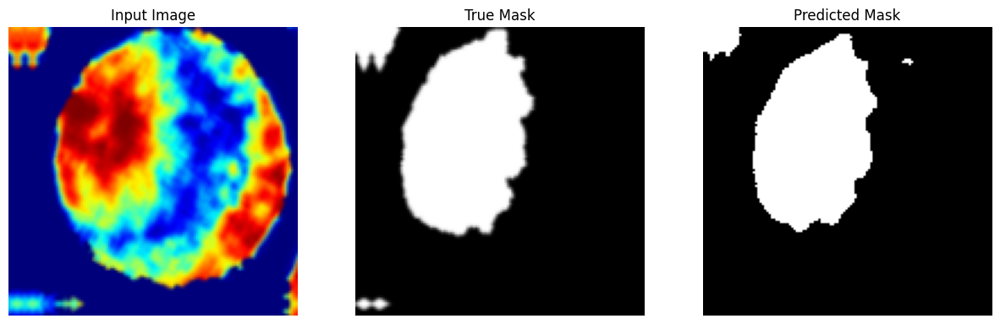


Sample Prediction after epoch 200

12/12 [==============================] - 3s 237ms/step - loss: 0.0662 - accuracy: 0.9032 - val_loss: 0.1734 - val_accuracy: 0.9437


In [30]:
from keras.callbacks import EarlyStopping

EPOCHS = 200
VAL_SUBSPLITS = 5
# hi copilt how to retrieve the number of val batches
# The number of validation batches is the number of validation images divided by the batch size
VALIDATION_STEPS = int(len(X_test) //2) // BATCH_SIZE
STEPS_PER_EPOCH = len(X_train) // BATCH_SIZE
print("The number of steps per epoch is: ", VALIDATION_STEPS)

early_stopping = EarlyStopping(
    monitor='val_loss',  # The metric to monitor (e.g., validation loss)
    patience=60,         # Number of epochs to wait without improvement
    restore_best_weights=True  # Restore the model to the best weights
)

model_history = model.fit(train_batches, epochs=EPOCHS,
                          steps_per_epoch=STEPS_PER_EPOCH,
                          validation_steps=VALIDATION_STEPS,
                          validation_data=val_batches,
                          callbacks=[DisplayCallback(), early_stopping])

In [36]:
import tensorflow as tf
import tensorflow_addons as tfa
import numpy as np

# Evaluate the model
loss, acc = model.evaluate(test_batches, verbose=2)
print("Restored model, accuracy: {:5.2f}%".format(100 * acc))

# Initialize the Mean IoU and F-beta score metrics
iou = tf.keras.metrics.MeanIoU(num_classes=2)
# Initialize FBetaScore for binary classification with beta=2 for more weight on recall
f1beta_score = tfa.metrics.FBetaScore(beta=1.5, num_classes=2, average='micro')


# Collect all predictions and labels to update F-beta score later
all_preds = []
all_labels = []

# Iterate through the test batches
for images, labels in test_batches:
    preds = model.predict(images)
    preds = tf.argmax(preds, axis=-1)  # Convert logits to class predictions
    preds = tf.cast(preds, tf.float32)  # Convert to float32

    # Update IoU with flattened labels and predictions
    iou.update_state(labels, preds)

    # Flatten the predictions and labels for consistency
    preds_flat = preds.numpy().flatten()
    labels_flat = labels.numpy().flatten()

    # Collect predictions and labels
    all_preds.extend(preds_flat)
    all_labels.extend(labels_flat)

# Convert lists to numpy arrays
all_preds = np.array(all_preds)
all_labels = np.array(all_labels)

# Reshape the flattened arrays into 2D format expected by FBetaScore
all_preds = all_preds.reshape(-1, 1)
all_labels = all_labels.reshape(-1, 1)

# Update the F-beta score state with the reshaped arrays
f1beta_score.update_state(all_labels, all_preds)

# Print the results
print("Mean IoU =", iou.result().numpy())

# Calculate the F-beta score (weighted F1 score with more emphasis on recall)
f1_beta_score = f1beta_score.result().numpy()
print(f"F-beta Score (β=1.5): {f1_beta_score:.4f}")


C:\Users\jonat\AppData\Local\Programs\Python\Python311\Lib\site-packages\tensorflow_addons\utils\tfa_eol_msg.py:23: UserWarning: 

TensorFlow Addons (TFA) has ended development and introduction of new features.
TFA has entered a minimal maintenance and release mode until a planned end of life in May 2024.
Please modify downstream libraries to take dependencies from other repositories in our TensorFlow community (e.g. Keras, Keras-CV, and Keras-NLP). 

For more information see: https://github.com/tensorflow/addons/issues/2807 

  warnings.warn(


2/2 - 0s - loss: 0.1648 - accuracy: 0.9497 - 164ms/epoch - 82ms/step
Restored model, accuracy: 94.97%
1/1 [==============================] - 0s 65ms/step
Mean IoU = 0.8761541
F-beta Score (β=1.5): 0.8736


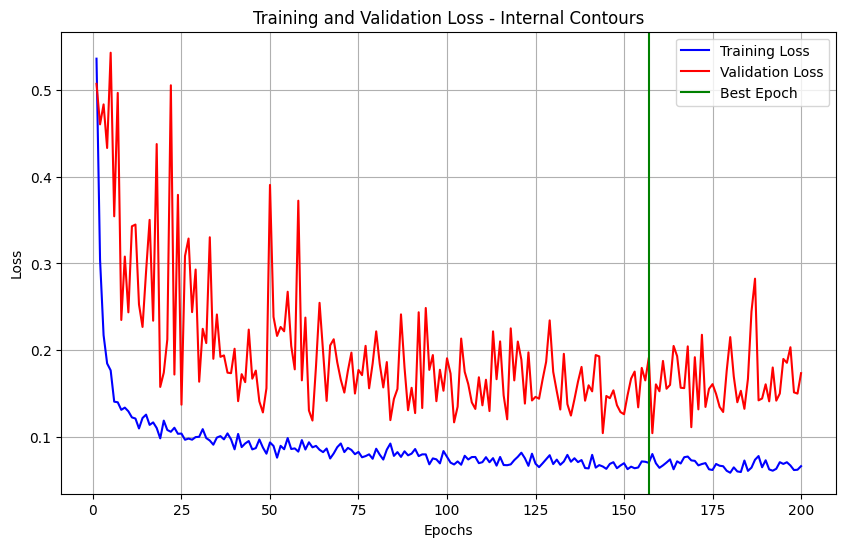

In [32]:
import matplotlib.pyplot as plt

# Extract data from the model history
train_loss = model_history.history['loss']
val_loss = model_history.history['val_loss']

# Create an array of the epoch numbers for the x-axis
epochs = range(1, len(train_loss) + 1)

# Plot the training loss
plt.figure(figsize=(10, 6))
plt.plot(epochs, train_loss, 'b', label='Training Loss')
plt.plot(epochs, val_loss, 'r', label='Validation Loss')
plt.axvline(x=early_stopping.best_epoch, color='g', label='Best Epoch')
plt.title('Training and Validation Loss - Internal Contours')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.grid()
plt.show()

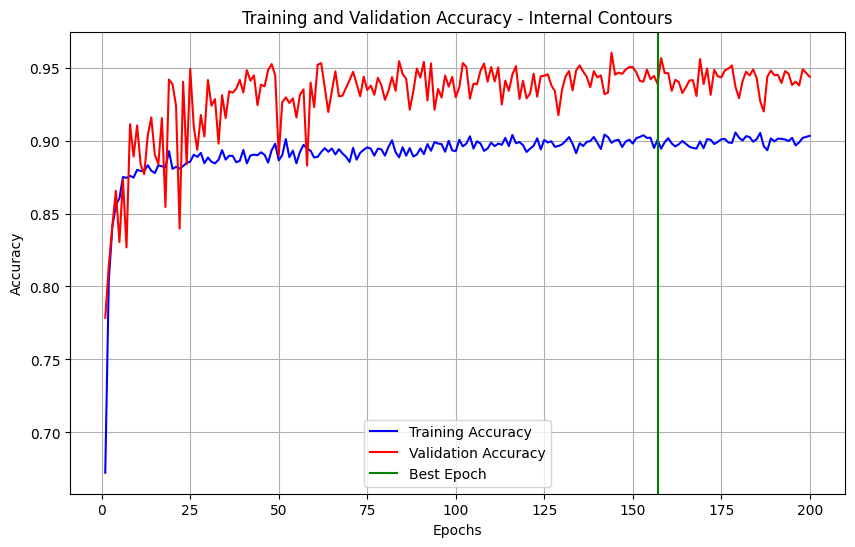

In [33]:
# Plot the training and testing accuracy
train_acc = model_history.history['accuracy']
val_acc = model_history.history['val_accuracy']

plt.figure(figsize=(10, 6))
plt.plot(epochs, train_acc, 'b', label='Training Accuracy')
plt.plot(epochs, val_acc, 'r', label='Validation Accuracy')
plt.axvline(x=early_stopping.best_epoch, color='g', label='Best Epoch')
plt.title('Training and Validation Accuracy - Internal Contours')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()
plt.grid()
plt.show()

In [34]:
# Save the model
tf.keras.models.save_model(model, 'internal_smaller_mask_unet_model')

INFO:tensorflow:Assets written to: internal_smaller_mask_unet_model\assets


INFO:tensorflow:Assets written to: internal_smaller_mask_unet_model\assets


In [35]:
# print the selected epochs
print("The selected epochs are: ", early_stopping.best_epoch)

The selected epochs are:  157
